In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance as yf



YF.download() has changed argument auto_adjust default to True


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


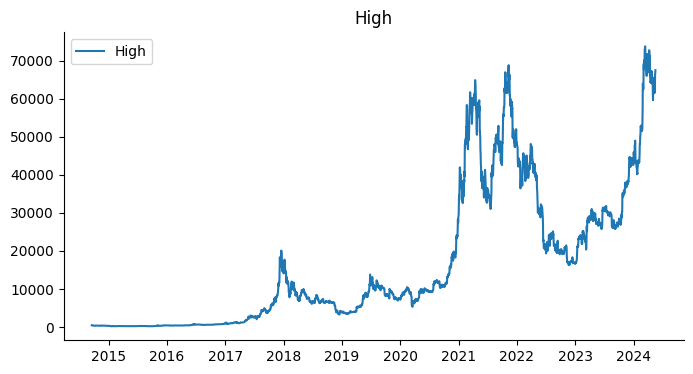

In [3]:
start1 = '2023-10-04'
start2 = '2022-11-20'
start3 = '2010-1-1'
end1 = '2024-5-18'

data1 = yf.download('BTC-USD', start=start1, end=end1)
data2 = yf.download('BTC-USD', start=start2, end=end1)
df = yf.download('BTC-USD', start=start3, end=end1)


df_hour = pd.read_csv('Binance_BTCUSDT_1h.csv', encoding='utf-8', delimiter=',')

df_hour.reset_index(inplace=True)
df.reset_index(inplace=True)

plt.figure(figsize=(8, 4))
plt.plot(df['Date'], df['High'], label='High')
plt.title('High')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.legend()
plt.show()


In [4]:
def identify_engulfing_candles(df):
    bullish_engulfing = [ ]
    bearish_engulfing = [ ]

    for i in range(1, len(df)):
        previous_candle = df.iloc[i - 1]
        current_candle = df.iloc[i]
 #------------------------------------------------------------------------------------------------
        # Bullish Engulfing
        # کندل اول باید قرمز باشد و کندل دوم باید سبز باشد و
        if (previous_candle['Close'].item() < previous_candle['Open'].item() and  # Use .item() to get a single value
            current_candle['Close'].item() > current_candle['Open'].item() and  # Use .item() to get a single value
            current_candle['Open'].item() < previous_candle['Close'].item() and  # Use .item() to get a single value
            current_candle['Close'].item() > previous_candle['Open'].item()):
            bullish_engulfing.append(current_candle['Date'])
        else:
            bullish_engulfing.append(None)

        # Bearish Engulfing
        if (previous_candle['Close'].item() > previous_candle['Open'].item() and  # Use .item() to get a single value
            current_candle['Close'].item() < current_candle['Open'].item() and  # Use .item() to get a single value
            current_candle['Open'].item() > previous_candle['Close'].item() and  # Use .item() to get a single value
            current_candle['Close'].item() < previous_candle['Open'].item()):
            bearish_engulfing.append(current_candle['Date'])
        else:
            bearish_engulfing.append(None)
 #------------------------------------------------------------------------------------------------

    df['Bullish_Engulfing'] = pd.Series(bullish_engulfing)
    df['Bearish_Engulfing'] = pd.Series(bearish_engulfing)
    k = 2

    return df

In [5]:
df = identify_engulfing_candles(df)

# جداسازی دیتا برای الگوهای صعودی و نزولی
df_bullish = df.drop('Bearish_Engulfing', axis=1).dropna()
df_bearish = df.drop('Bullish_Engulfing', axis=1).dropna()

# -------------------------------
# خواندن داده‌های ساعتی از فایل CSV در Google Drive
# -------------------------------



# تبدیل ستون زمان به نوع datetime
df_hour['level_1'] = pd.to_datetime(df_hour['level_1'], format='%Y-%m-%d %H:%M:%S', errors='coerce')
# تبدیل ستون قیمت (مثلاً level_3) به عدد
df_hour['level_3'] = pd.to_numeric(df_hour['level_3'], errors='coerce')

# حذف ستون‌های غیرضروری
cols_to_drop = ['level_4', 'level_2', 'level_5', 'level_8', 'level_7', 'https://www.CryptoDataDownload.com','level_0']

df_hour.drop(cols_to_drop, axis=1, inplace=True)

# بررسی داده‌های تکراری و مقدار null در level_1
print("تعداد ردیف‌های تکراری:", df_hour.duplicated().sum())
print("آیا null در level_1 وجود دارد؟", df_hour['level_1'].isnull().any())



تعداد ردیف‌های تکراری: 0
آیا null در level_1 وجود دارد؟ True


C:\Users\Tarokh\AppData\Local\Temp\ipykernel_18488\3239322305.py:4: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  df_bullish = df.drop('Bearish_Engulfing', axis=1).dropna()
C:\Users\Tarokh\AppData\Local\Temp\ipykernel_18488\3239322305.py:5: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  df_bearish = df.drop('Bullish_Engulfing', axis=1).dropna()


In [6]:
def SELECTING_DATA(data, num_dates=12):
    df_grouped = pd.DataFrame()
    group = 1
    last_index = None
    
    for date_val in data['Date']:
        # اختصاص گروه به داده‌های df_hour
        df_hour['Group'] = group
        try:
            selected_index = df_hour[df_hour['level_1'] == date_val].index[0]
            # انتخاب داده‌ها: 96 ردیف قبل تا 48 ردیف بعد از تاریخ انتخابی
            df_selected = df_hour.loc[selected_index - 96:selected_index + 48]
            df_grouped = pd.concat([df_selected, df_grouped], ignore_index=True)
            group += 1
            # اگر ستون Date_b موجود باشد، آن را پر کند
            if 'Date_b' in df_grouped.columns:
                df_grouped['Date_b'] = df_grouped['Date_b'].fillna(date_val)
            else:
                df_grouped['Date_b'] = date_val
            last_index = selected_index
        except:
            pass
    return df_grouped, last_index


In [7]:
df_grouped_bullish, var_2 = SELECTING_DATA(df_bullish)
df_grouped_bearish, var_22 = SELECTING_DATA(df_bearish)
print("آخرین اندیس انتخاب‌شده:", var_2)
print("دیتافریم گروه‌بندی bearish:")
print(df_grouped_bearish)
print("df_grouped_bullish:")
print(df_grouped_bullish)

آخرین اندیس انتخاب‌شده: 1775
دیتافریم گروه‌بندی bearish:
                  level_1   level_3   level_6  Group     Date_b
0     2024-05-13 00:00:00  61484.00  61512.89    139 2024-05-09
1     2024-05-12 23:00:00  61326.00  61483.99    139 2024-05-09
2     2024-05-12 22:00:00  61236.00   61326.0    139 2024-05-09
3     2024-05-12 21:00:00  61284.03   61236.0    139 2024-05-09
4     2024-05-12 20:00:00  61406.11  61284.03    139 2024-05-09
...                   ...       ...       ...    ...        ...
20150 2017-08-30 04:00:00   4600.00   4579.61      1 2017-09-01
20151 2017-08-30 03:00:00   4586.66   4583.61      1 2017-09-01
20152 2017-08-30 02:00:00   4597.54   4604.12      1 2017-09-01
20153 2017-08-30 01:00:00   4576.23   4597.55      1 2017-09-01
20154 2017-08-30 00:00:00   4564.52   4575.23      1 2017-09-01

[20155 rows x 5 columns]
df_grouped_bullish:
                  level_1   level_3   level_6  Group     Date_b
0     2024-05-20 00:00:00  66274.00  66459.99    169 2024-05-16
1

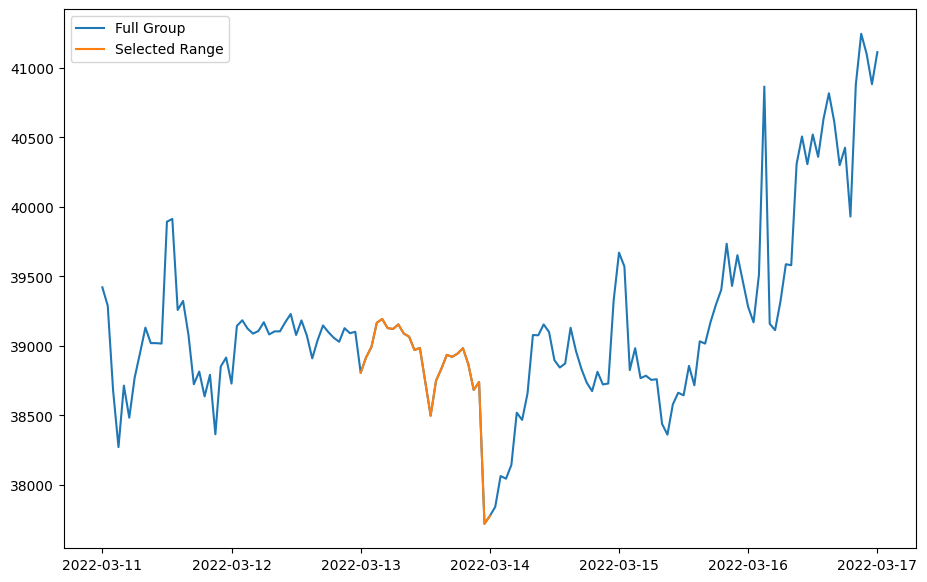

In [8]:
# -------------------------------
# رسم نمودار نمونه (گروه مشخص)  / قیمت به همراه بازه ی مشخص شده 
# -------------------------------

# فیلتر داده‌ها برای گروه 115
Sample_1 = df_grouped_bullish[df_grouped_bullish['Group'] == 115]

# تعریف بازه زمانی برای رسم (افزودن 24 ساعت به تاریخ)
range_start = Sample_1['Date_b'].iloc[1]
range_end = range_start + pd.Timedelta(hours=24)

# فیلتر داده‌ها بر اساس بازه زمانی
Sample_1_part = Sample_1[(Sample_1['level_1'] >= range_start) & (Sample_1['level_1'] <= range_end)]

plt.figure(figsize=(11, 7))
plt.plot(Sample_1['level_1'], Sample_1['level_3'], label='Full Group')
plt.plot(Sample_1_part['level_1'], Sample_1_part['level_3'], label='Selected Range')
plt.legend()
plt.show()

C:\Users\Tarokh\AppData\Local\Temp\ipykernel_18488\2256106188.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_group['price_scaled'] = scaler.fit_transform(single_group['level_3'].values.reshape(-1, 1))
C:\Users\Tarokh\AppData\Local\Temp\ipykernel_18488\2256106188.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_group['price_scaled'] = scaler.fit_transform(single_group['level_3'].values.reshape(-1, 1))
C:\Users\Tarokh\AppData\Local\Temp\ipykernel_18488\2256106188.py:7: SettingWithCopyWar

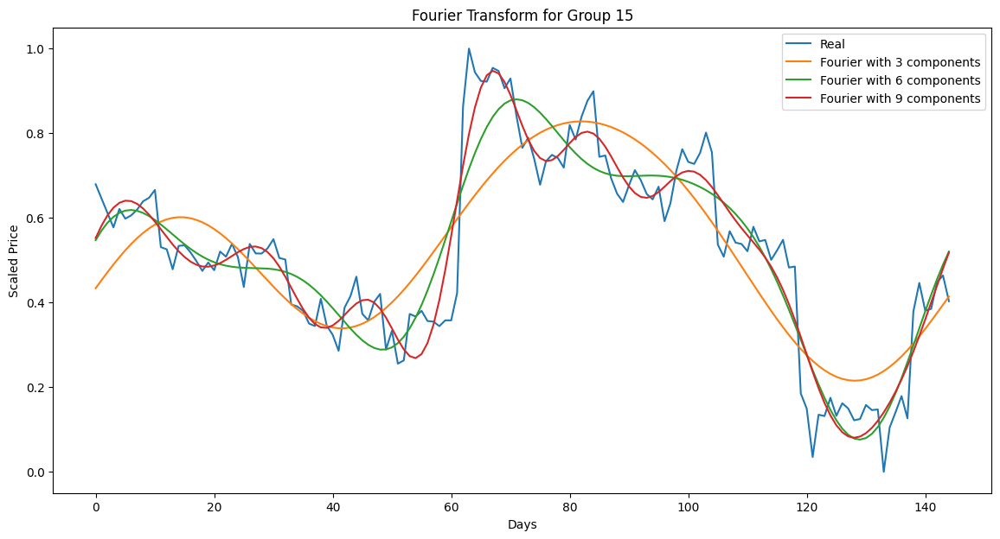

In [11]:
#   تست برای یک گروه » خروجی فوریه و نمودار قیمت با هم  
from sklearn.preprocessing import MinMaxScaler
df_new = pd.DataFrame()
scaler = MinMaxScaler()
for i in df_grouped_bearish['Group'].unique():
    single_group = df_grouped_bearish[df_grouped_bearish['Group'] == i]
    single_group['price_scaled'] = scaler.fit_transform(single_group['level_3'].values.reshape(-1, 1))
    df_new = pd.concat([df_new, single_group], ignore_index=True)


# Fourier Transform for one sample group from df_new (Group == 15)
df_2 = df_new[df_new['Group'] == 15]
data_FT = df_2[['price_scaled']]
close_fft = np.fft.fft(np.asarray(data_FT['price_scaled'].tolist()))
fft_df = pd.DataFrame({'fft': close_fft})
fft_df['absolute'] = fft_df['fft'].apply(lambda x: np.abs(x))
fft_df['angle'] = fft_df['fft'].apply(lambda x: np.angle(x))

plt.figure(figsize=(14, 7), dpi=100)
plt.plot(np.asarray(data_FT['price_scaled'].tolist()), label='Real')
for num_ in [3, 6, 9]:
    fft_copy = np.copy(close_fft)
    fft_copy[num_:-num_] = 0
    plt.plot(np.fft.ifft(fft_copy), label=f'Fourier with {num_} components')
plt.xlabel('Days')
plt.ylabel('Scaled Price')
plt.title('Fourier Transform for Group 15')
plt.legend()
plt.show()


c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


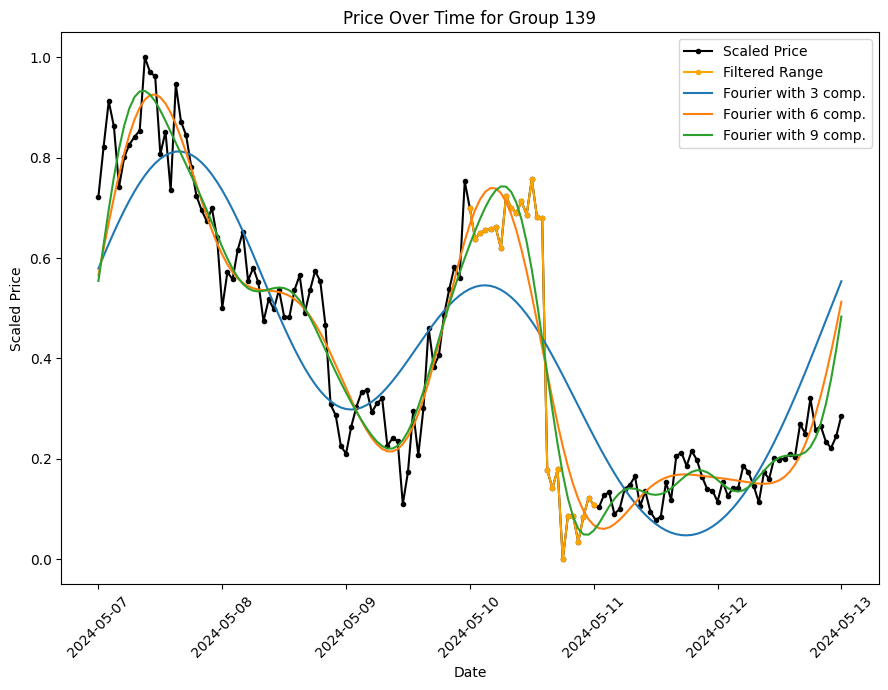

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


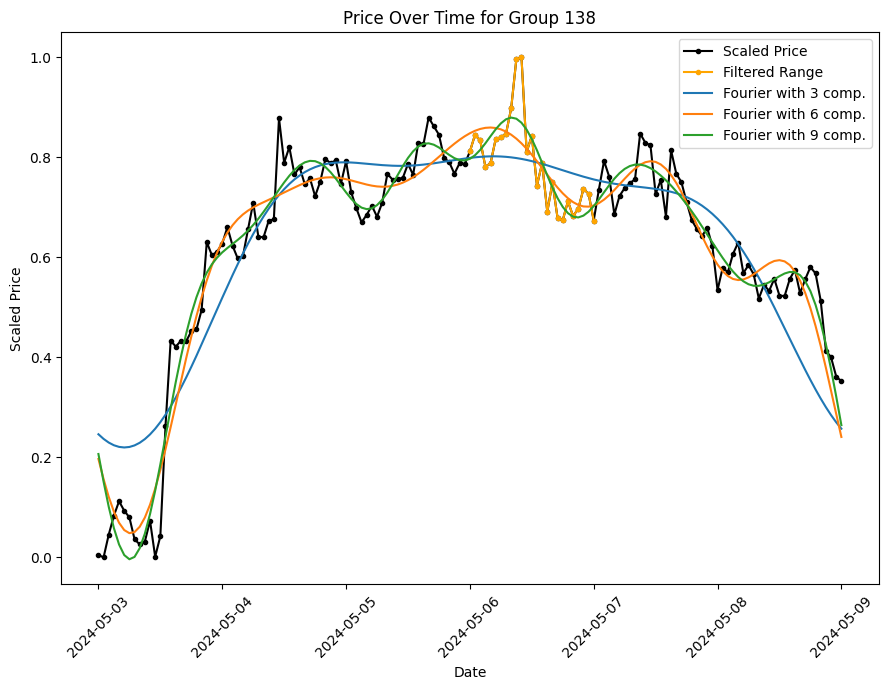

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


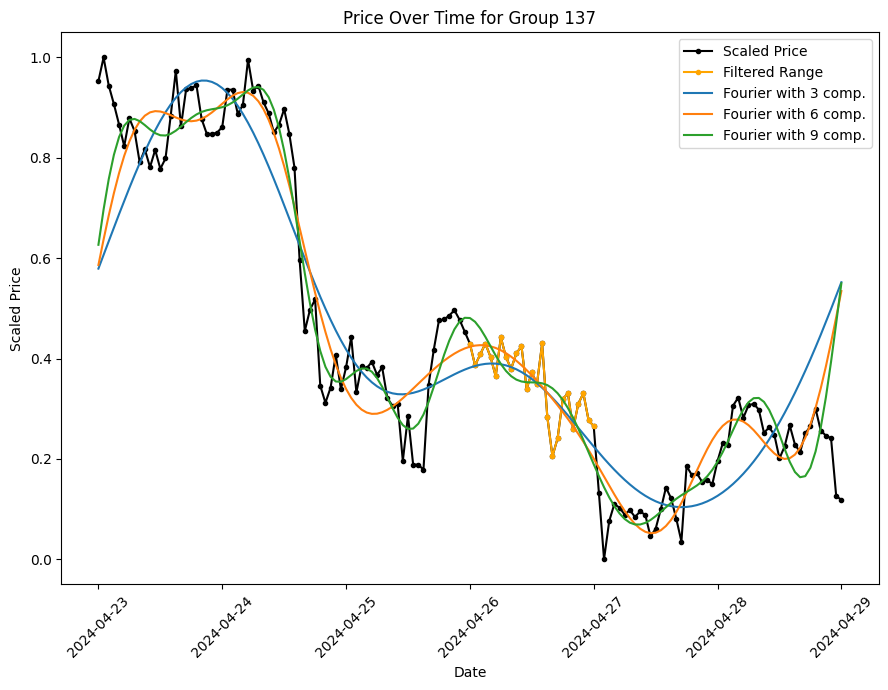

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


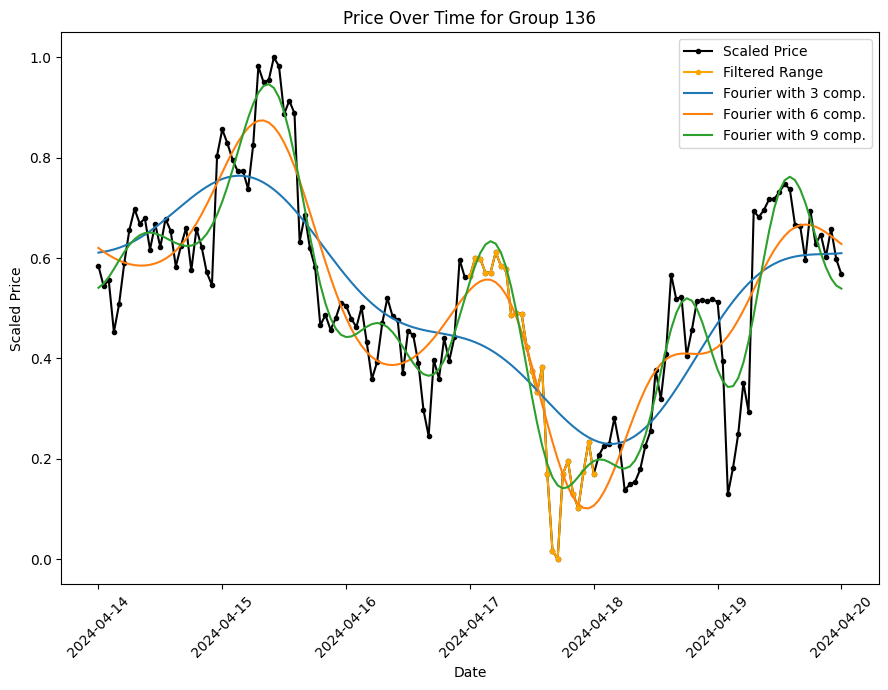

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


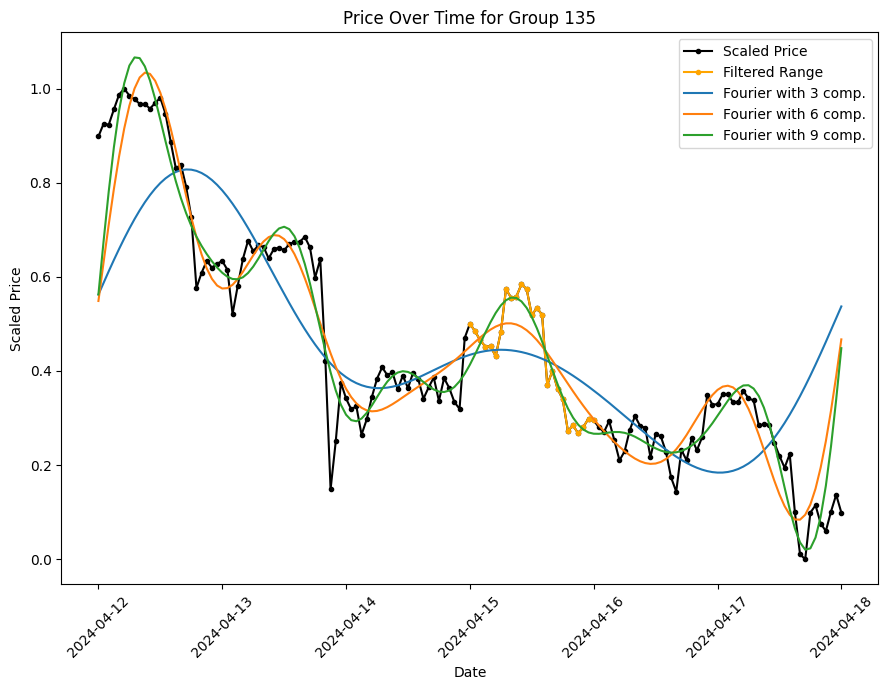

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


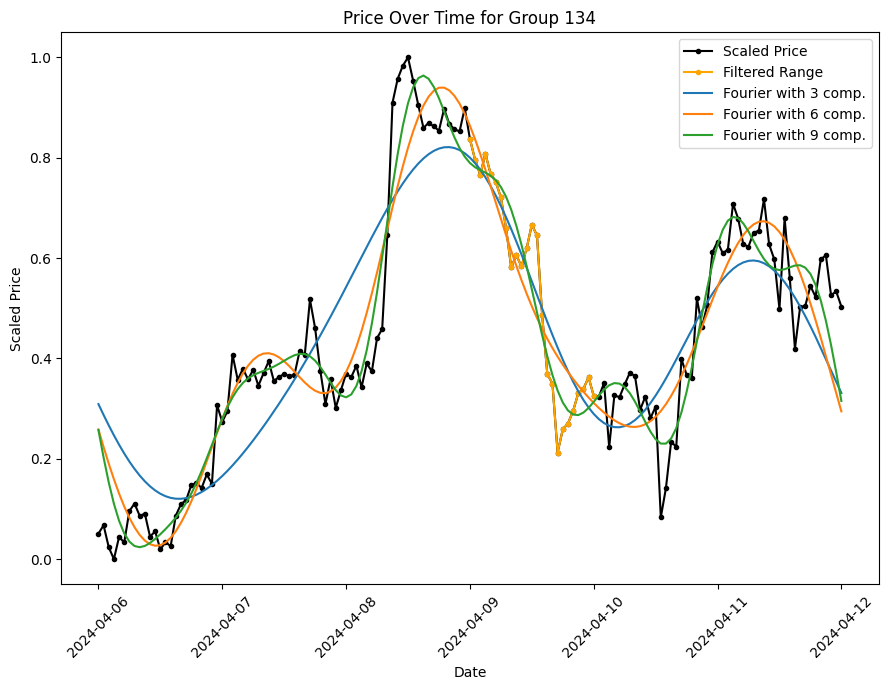

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


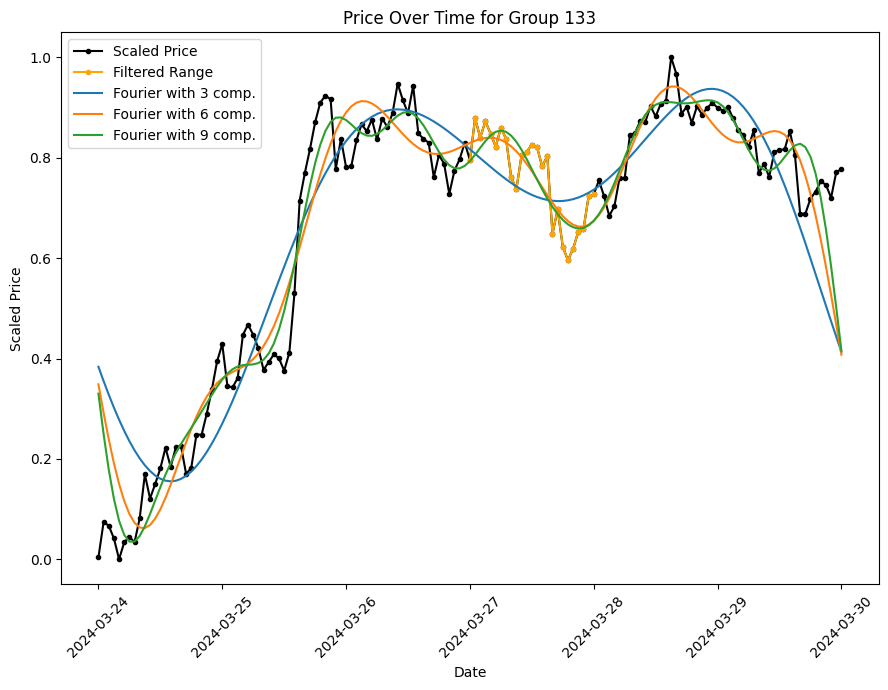

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


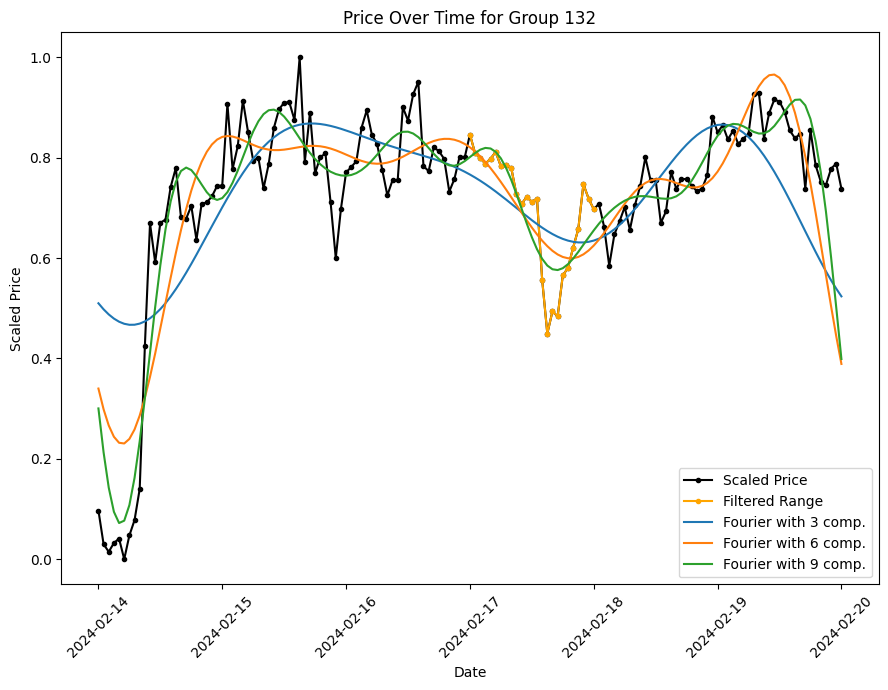

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


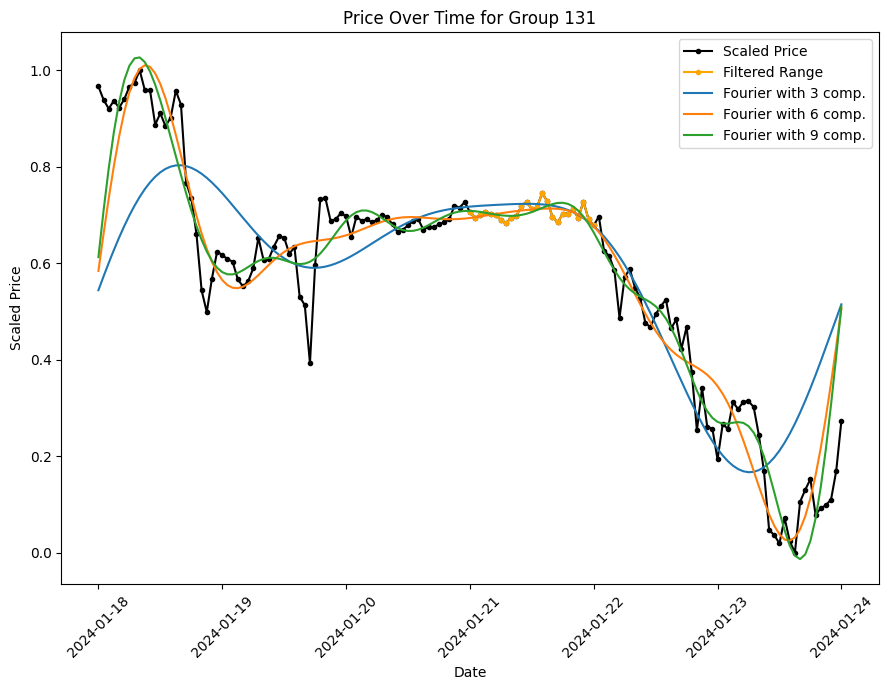

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


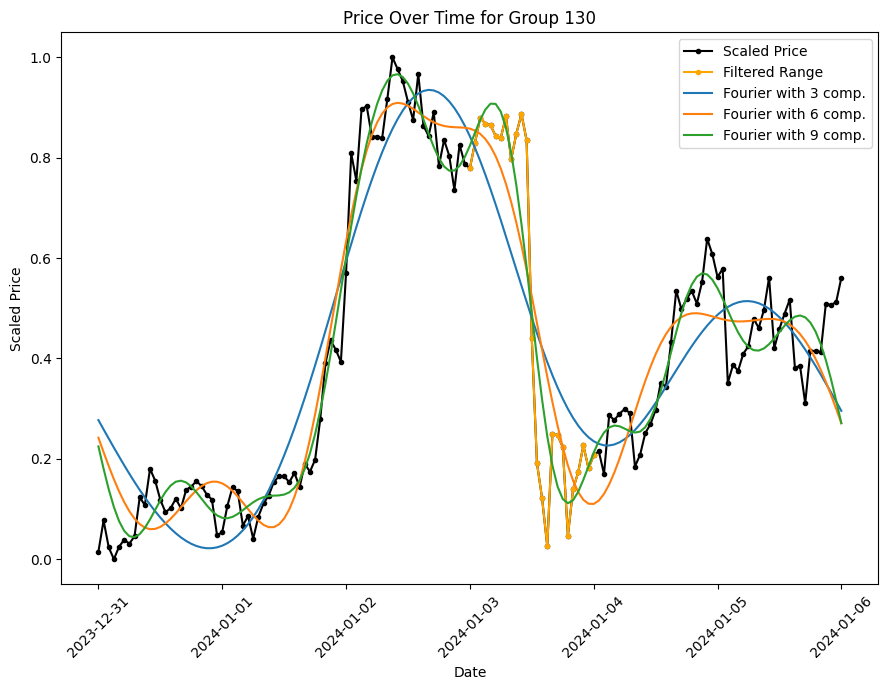

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


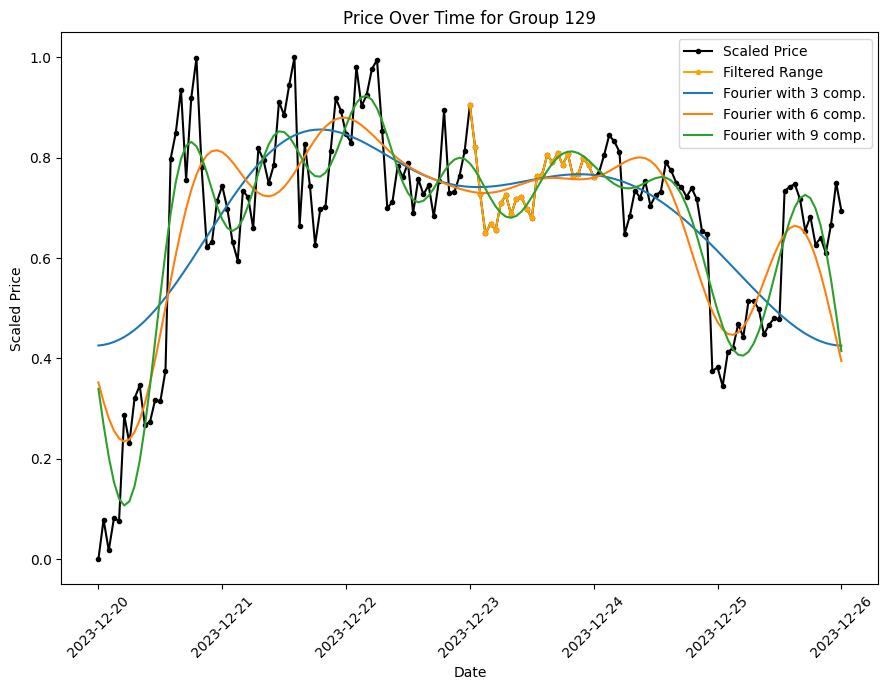

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


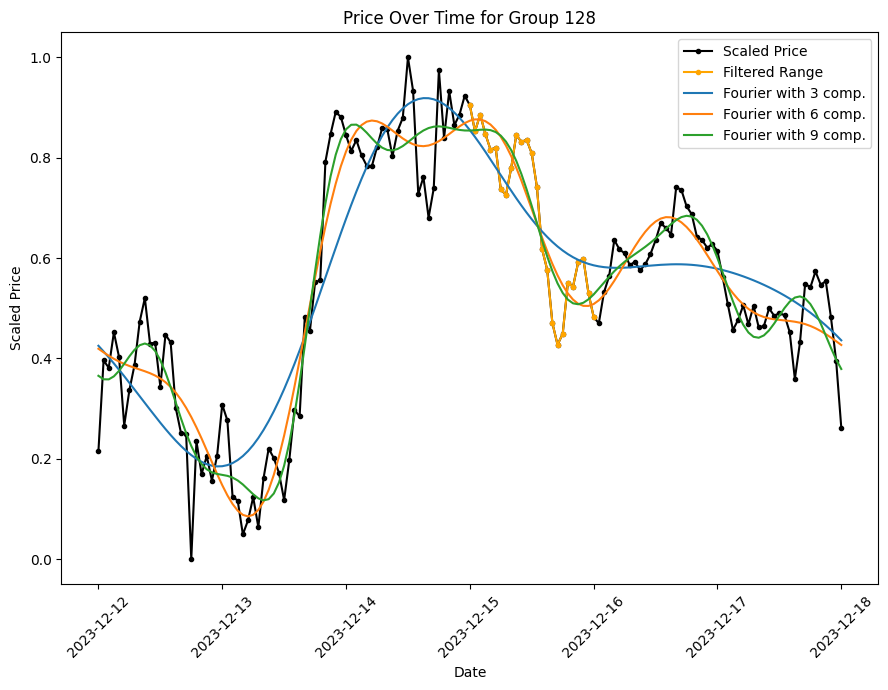

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


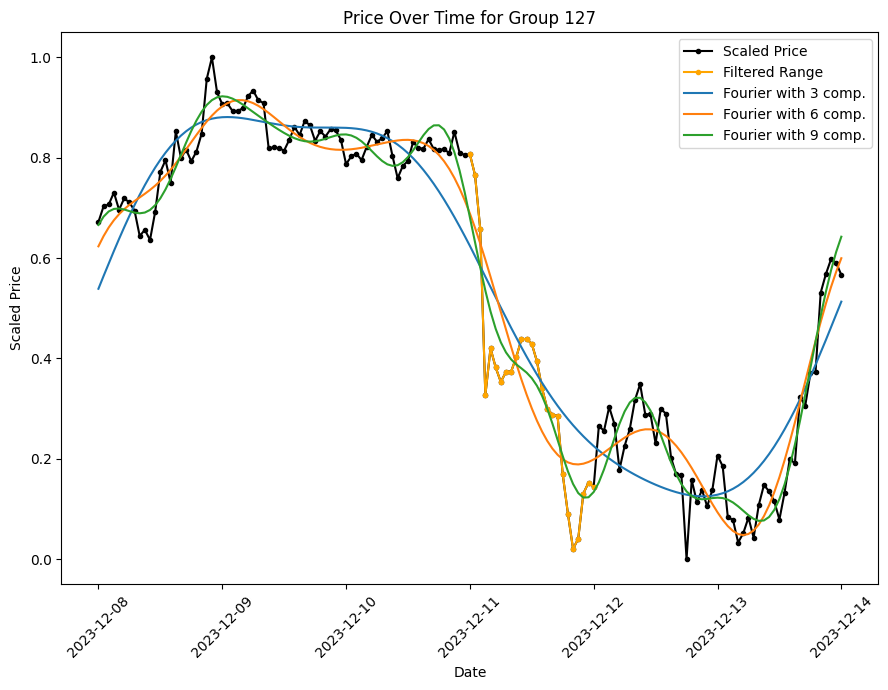

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


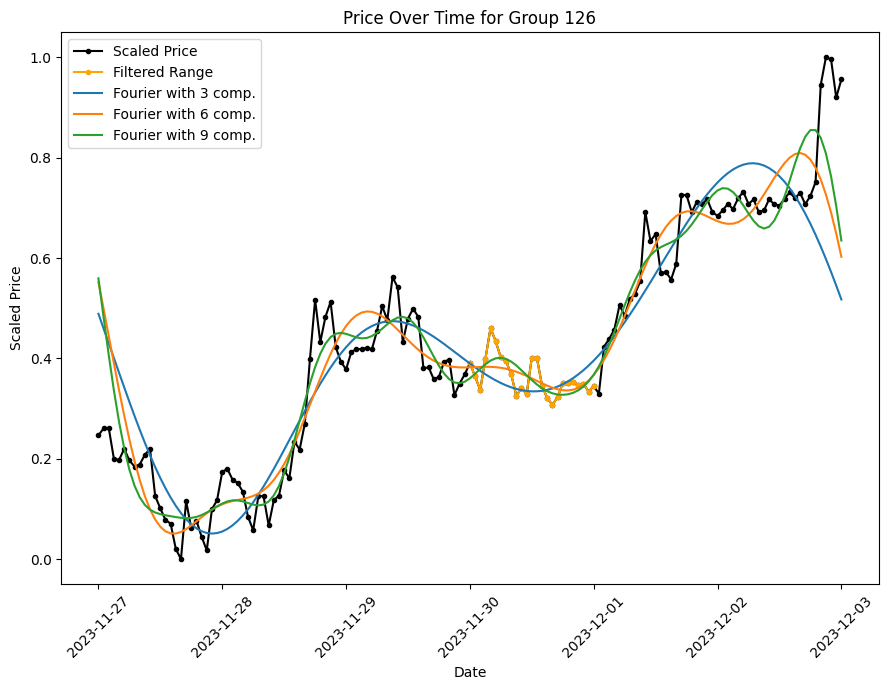

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


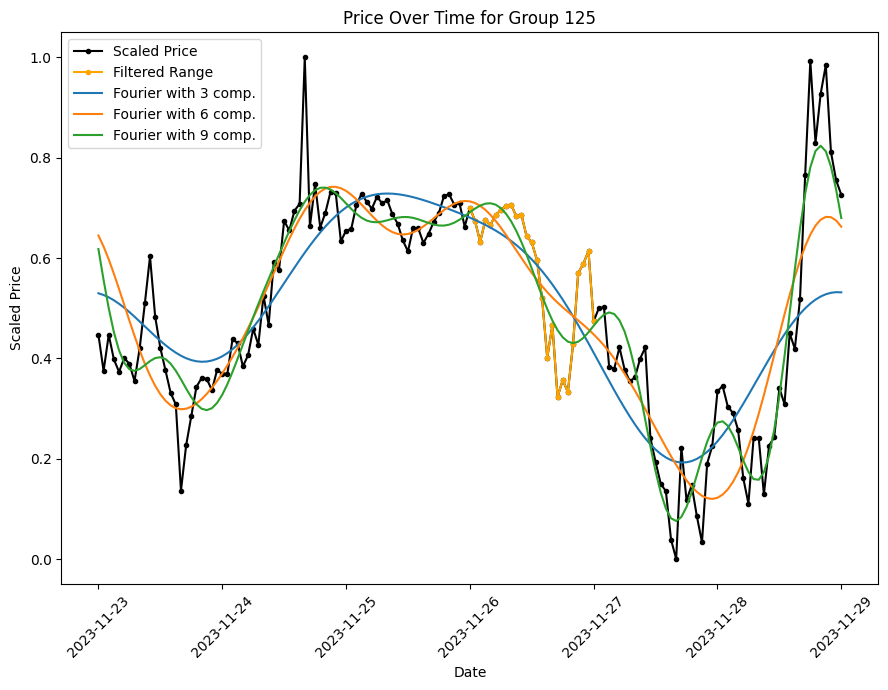

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


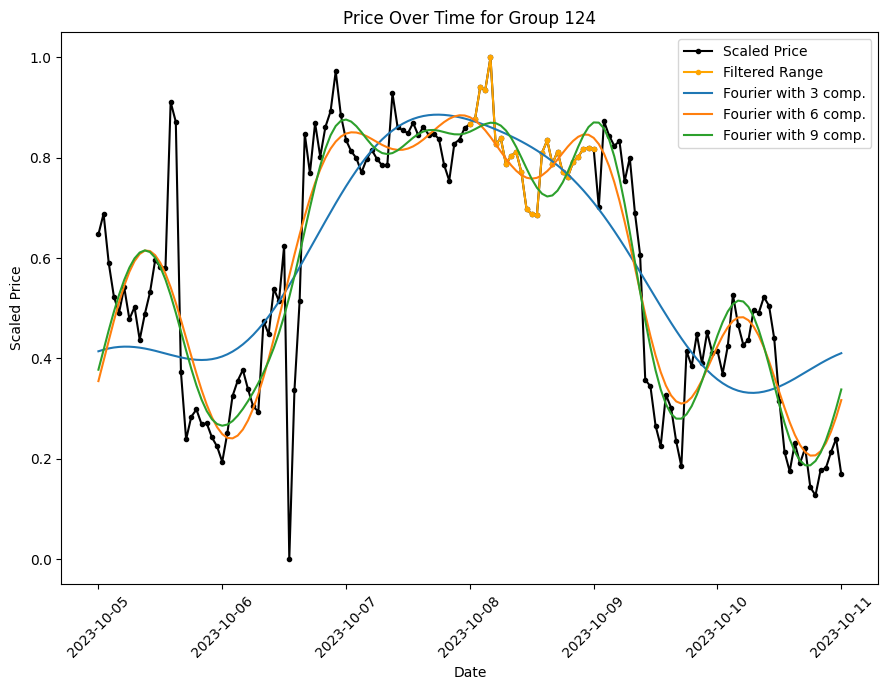

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


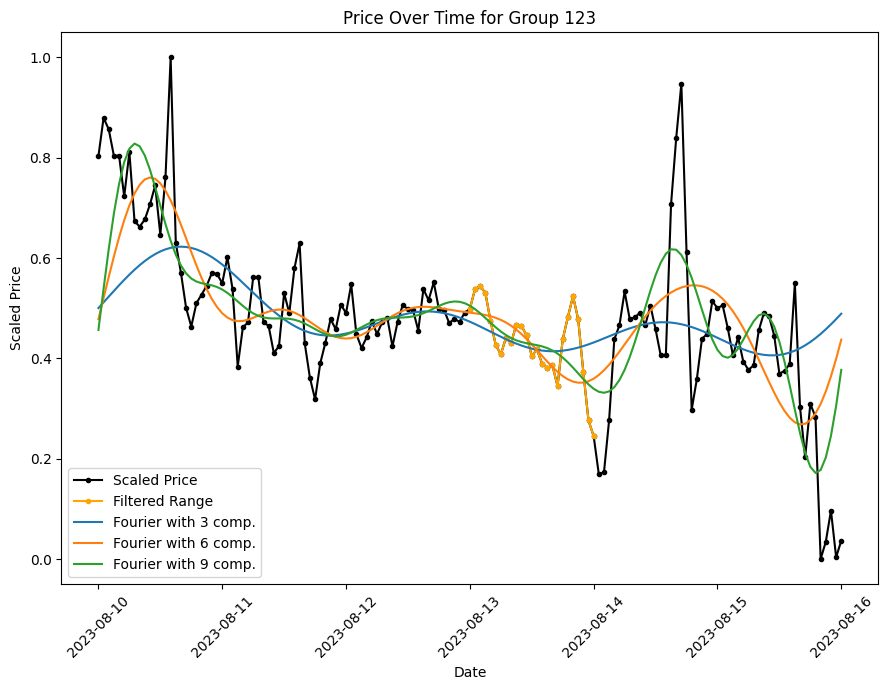

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


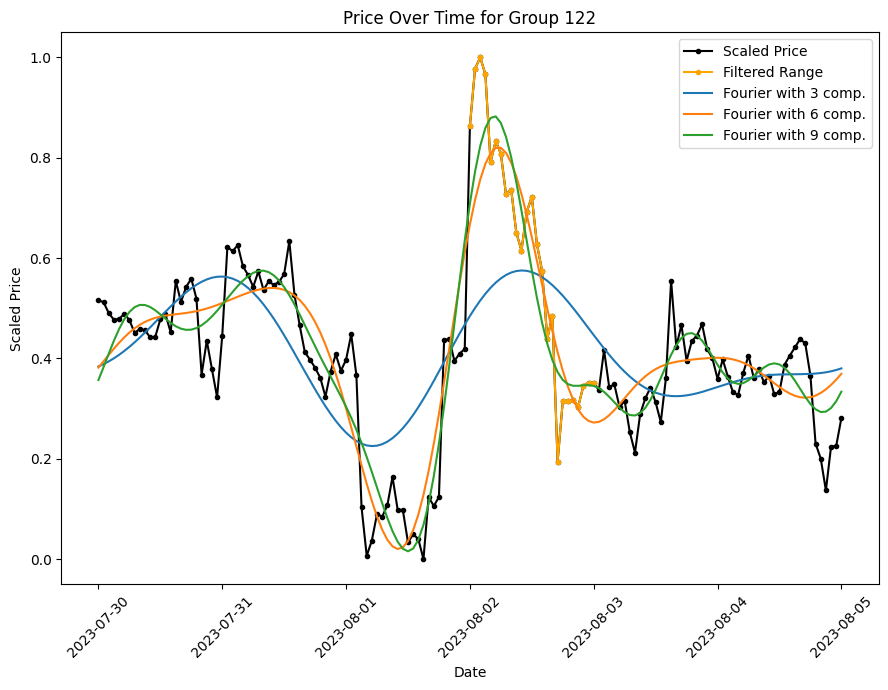

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


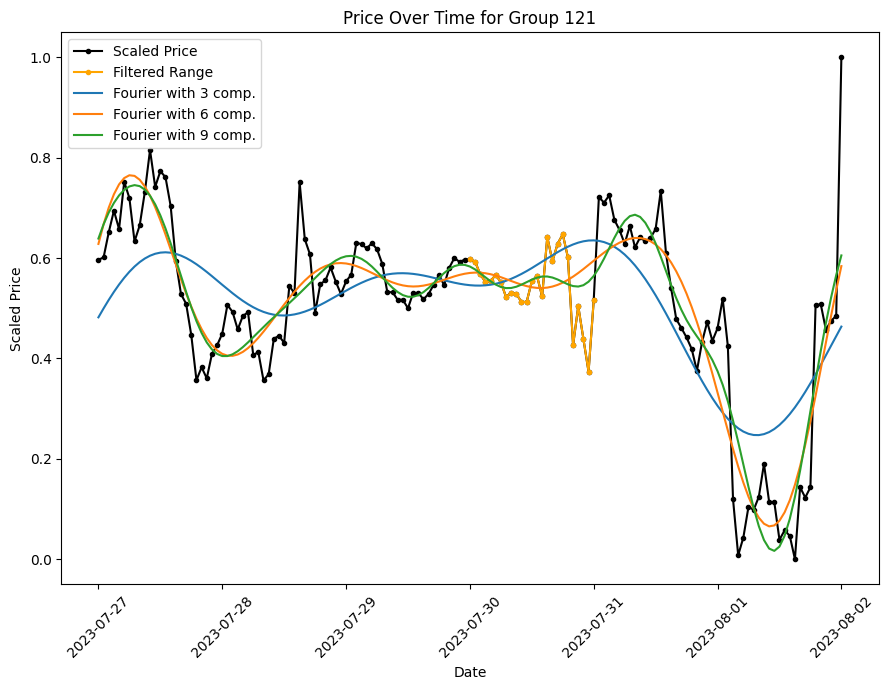

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


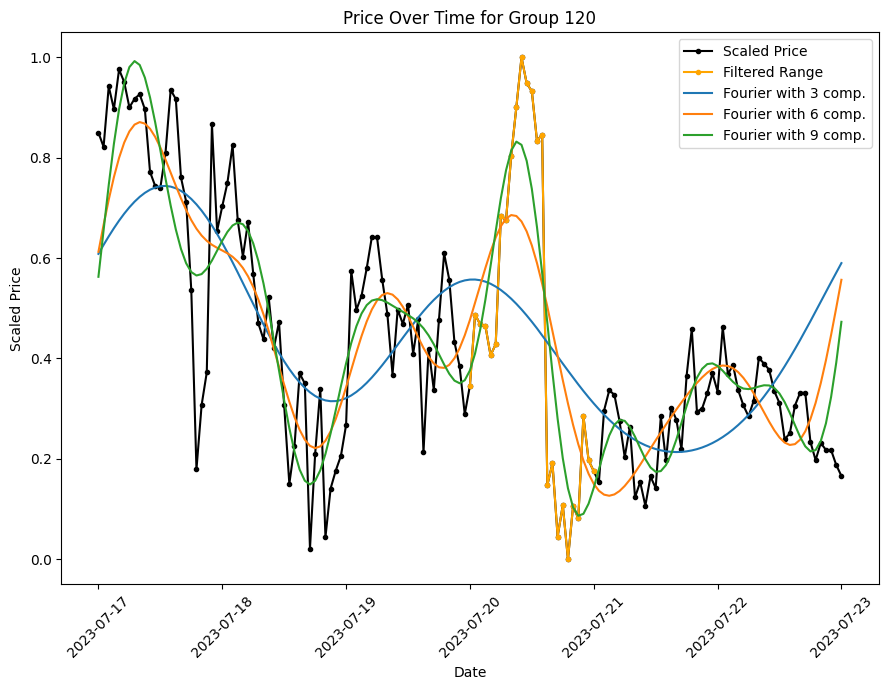

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


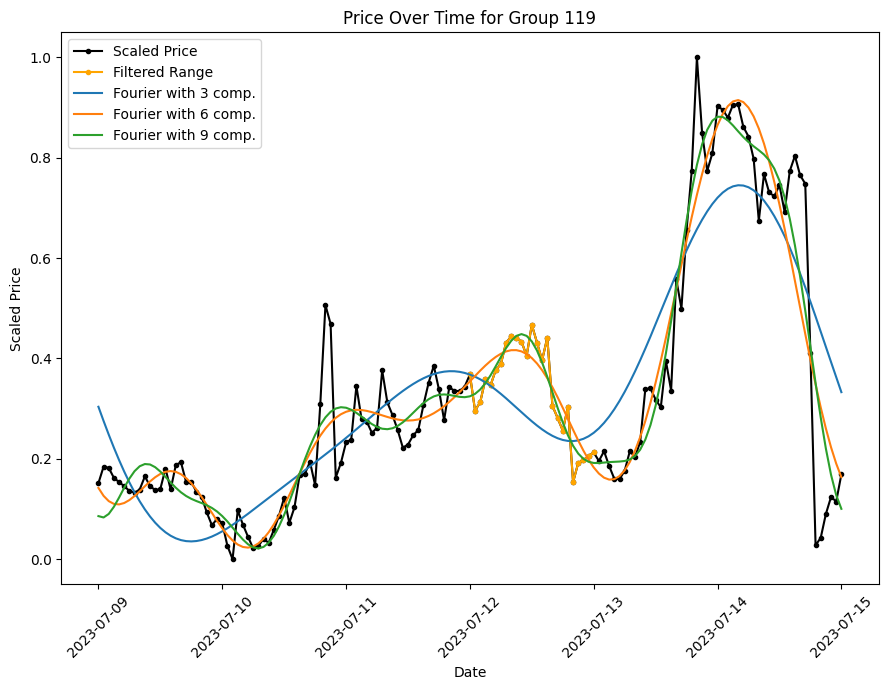

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


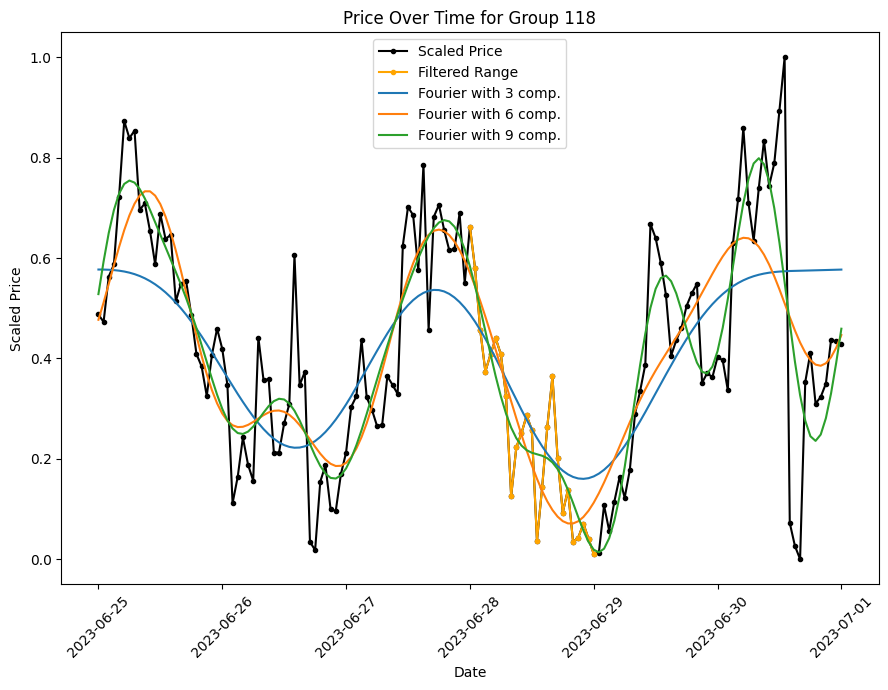

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


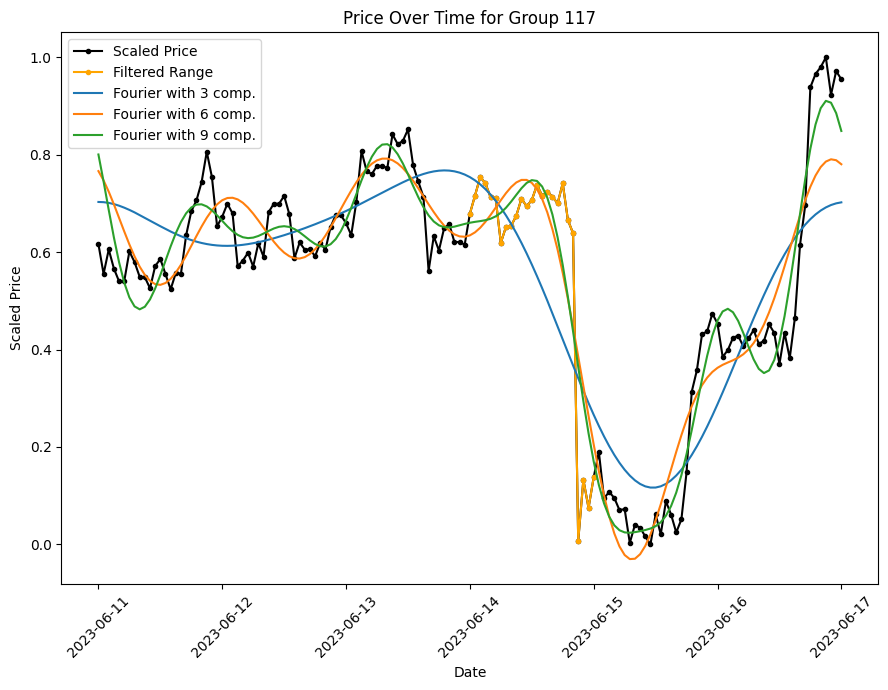

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


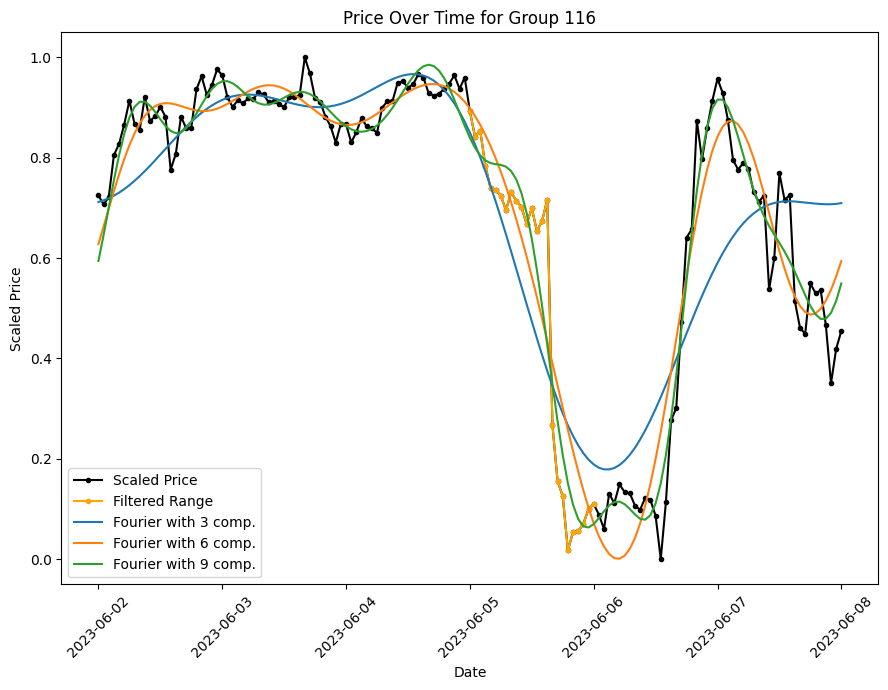

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


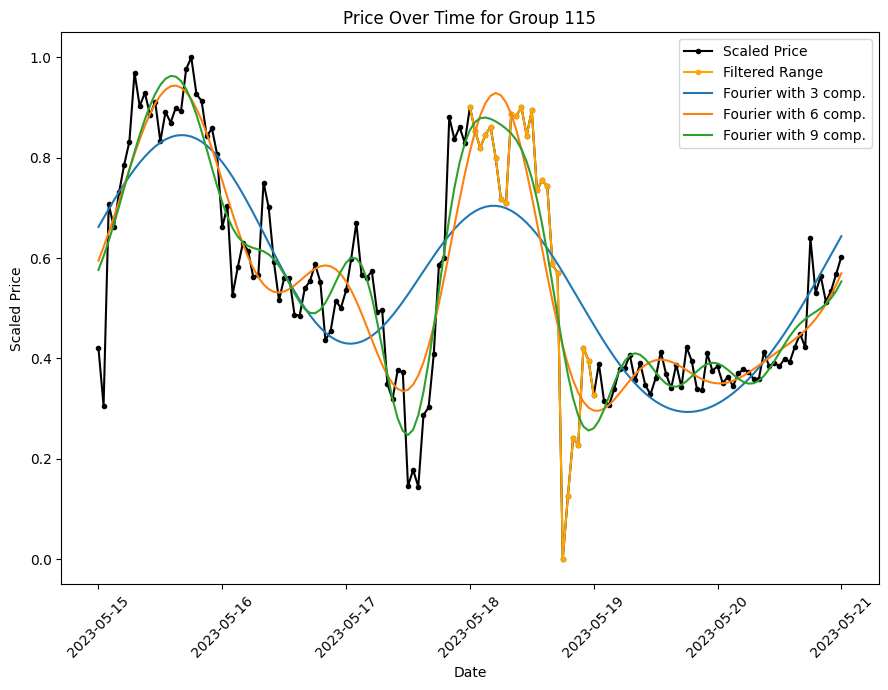

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


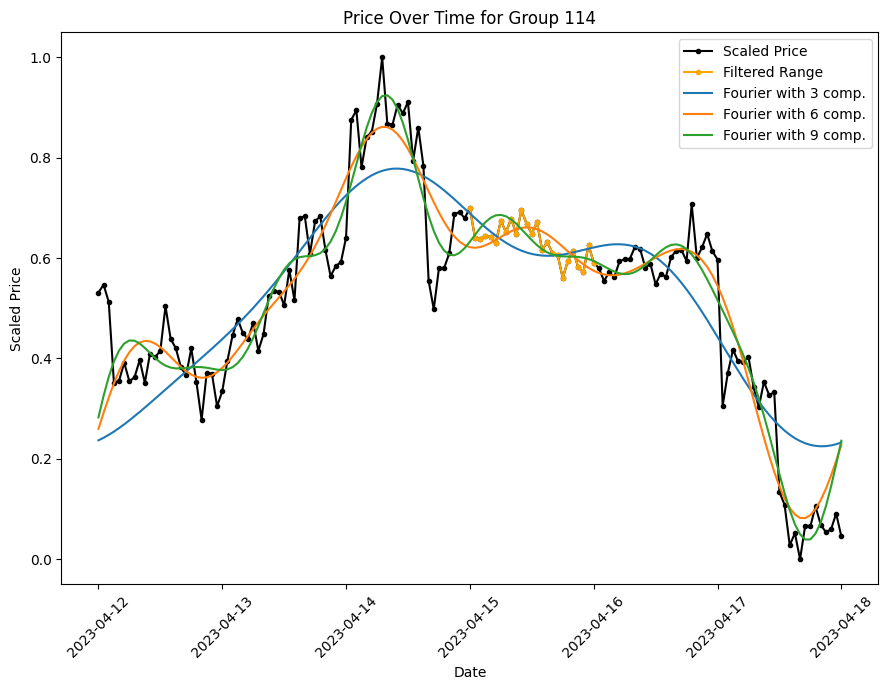

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


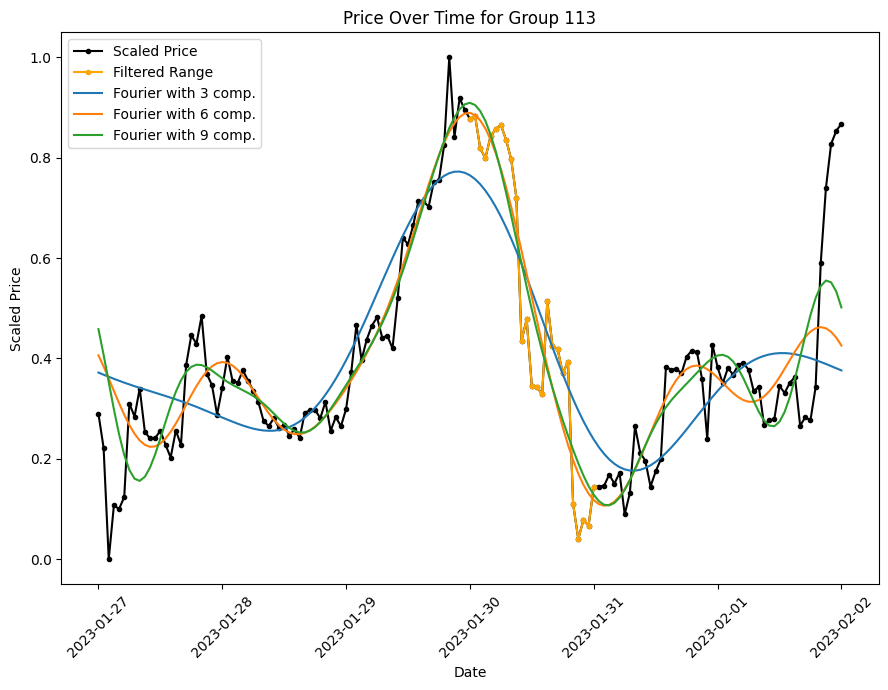

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


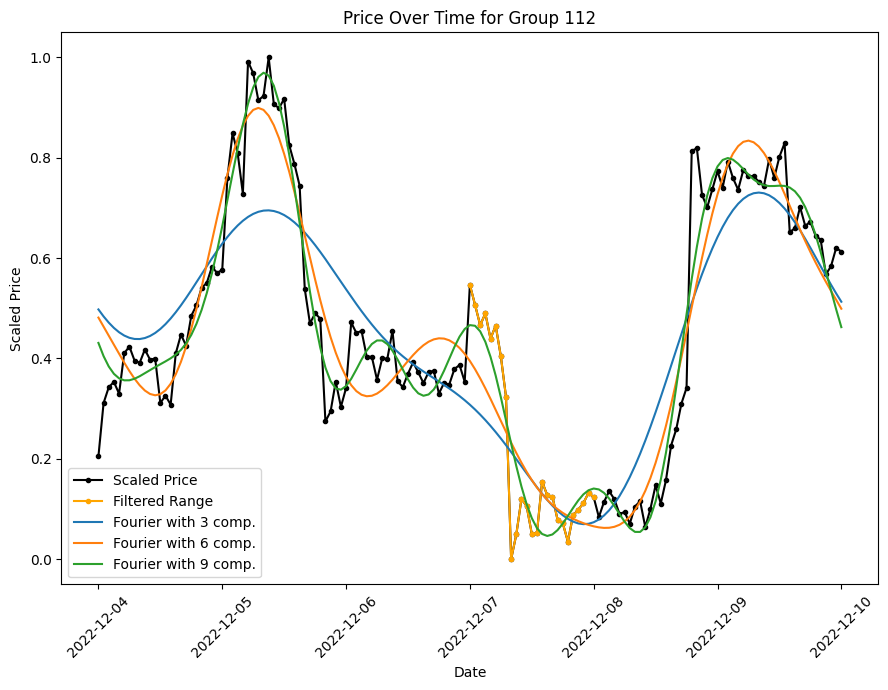

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


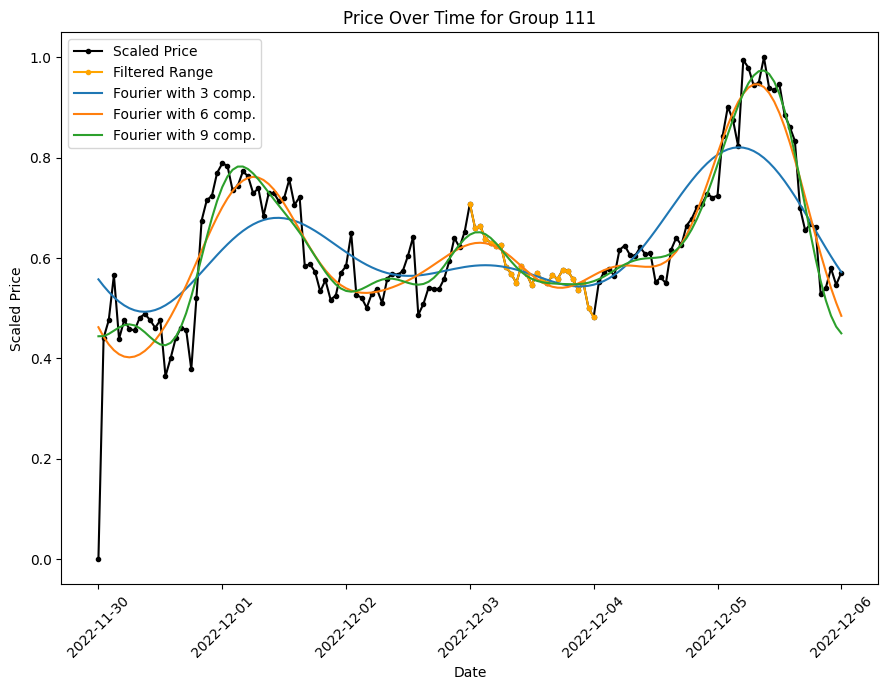

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


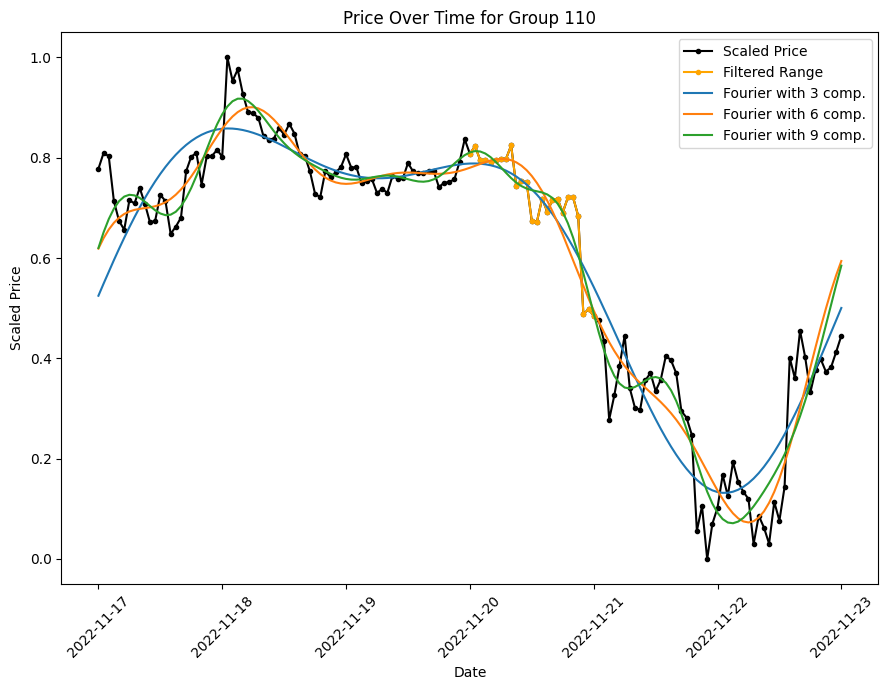

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


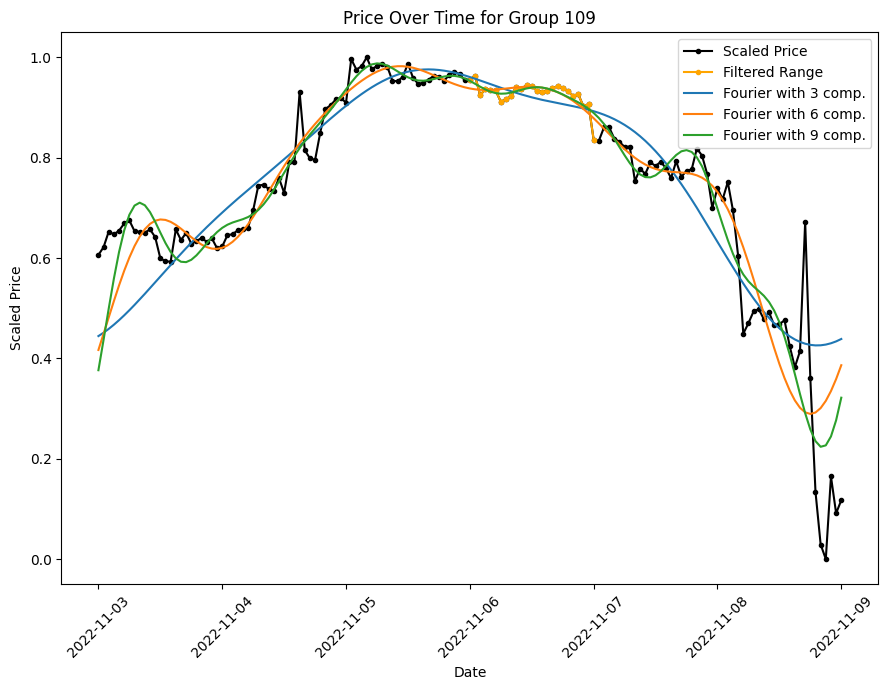

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


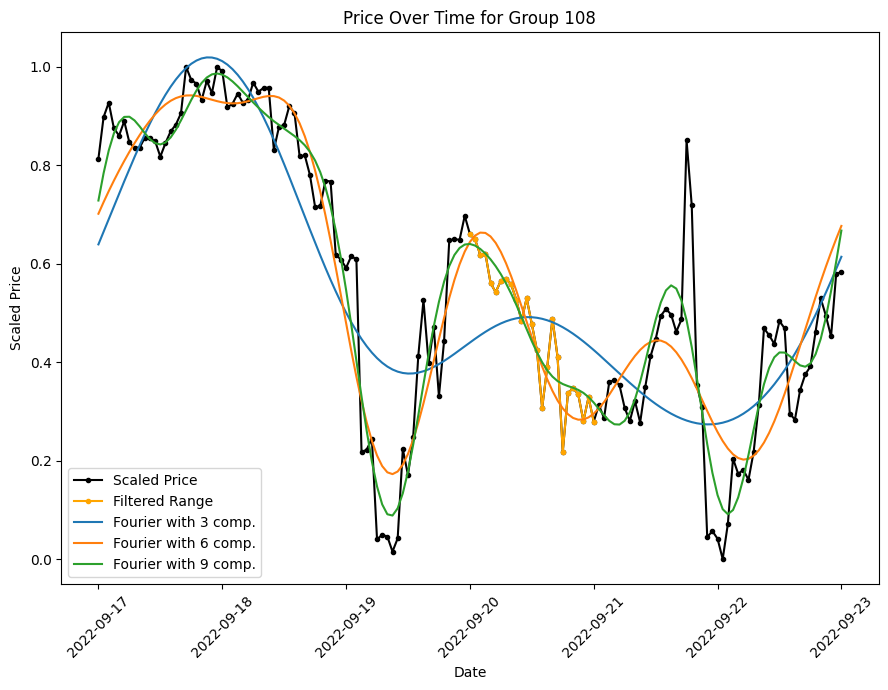

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


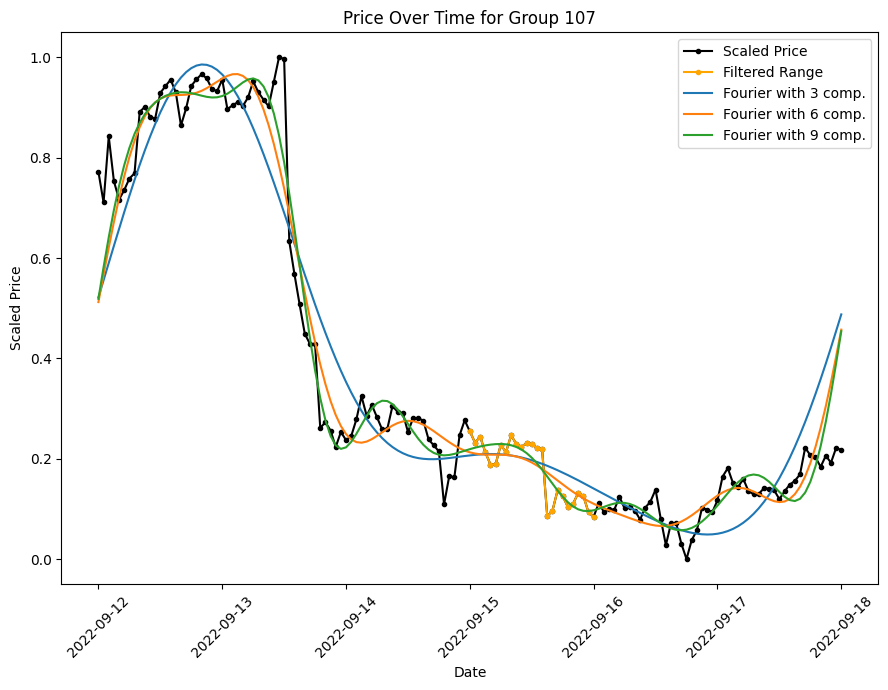

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


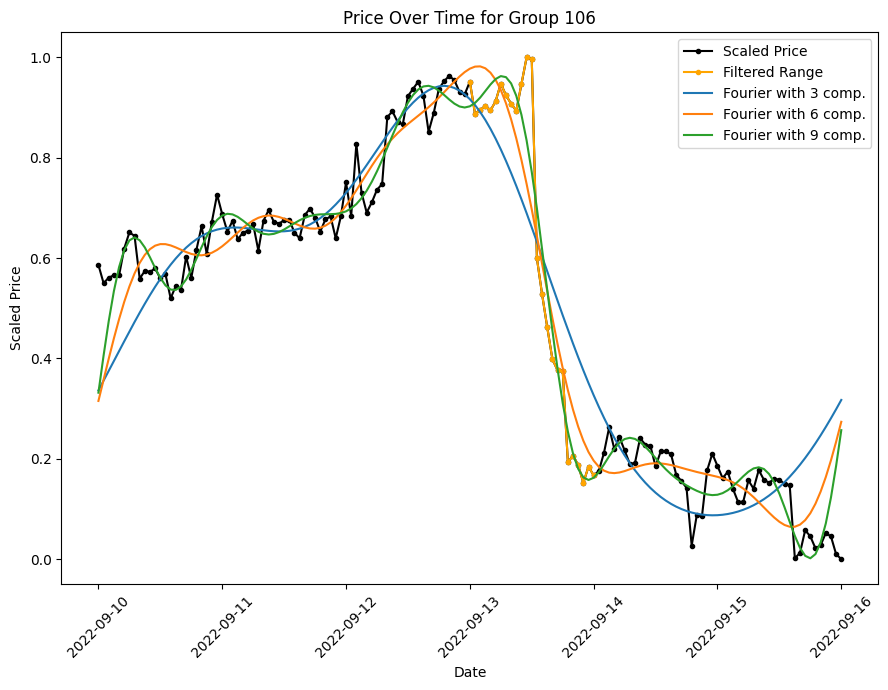

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


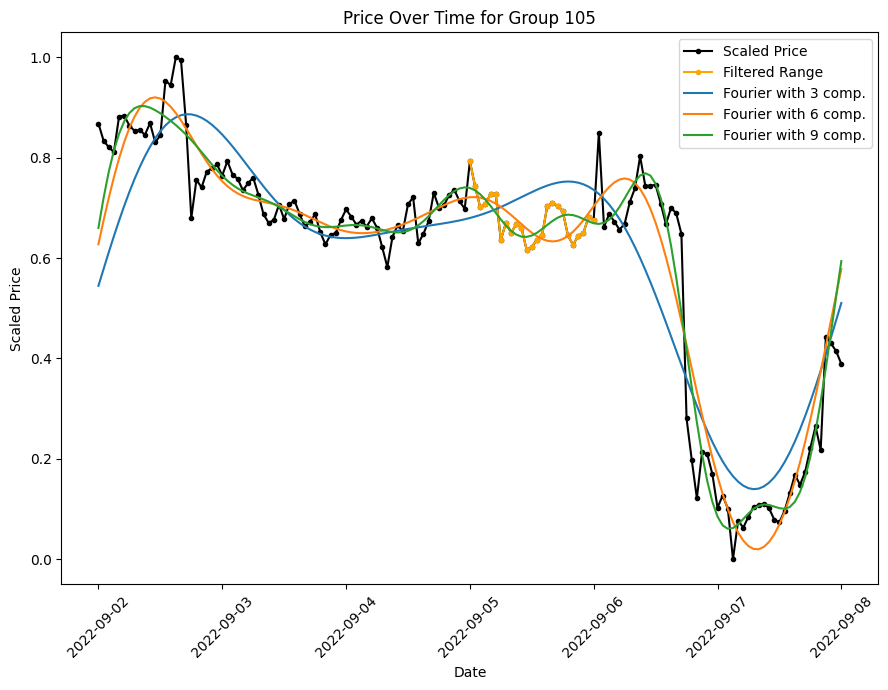

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


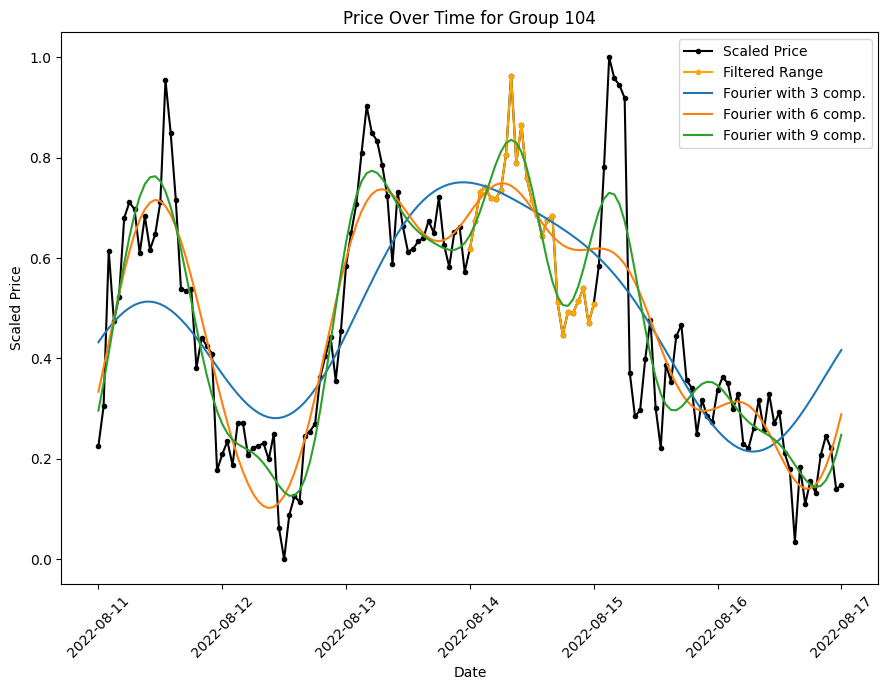

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


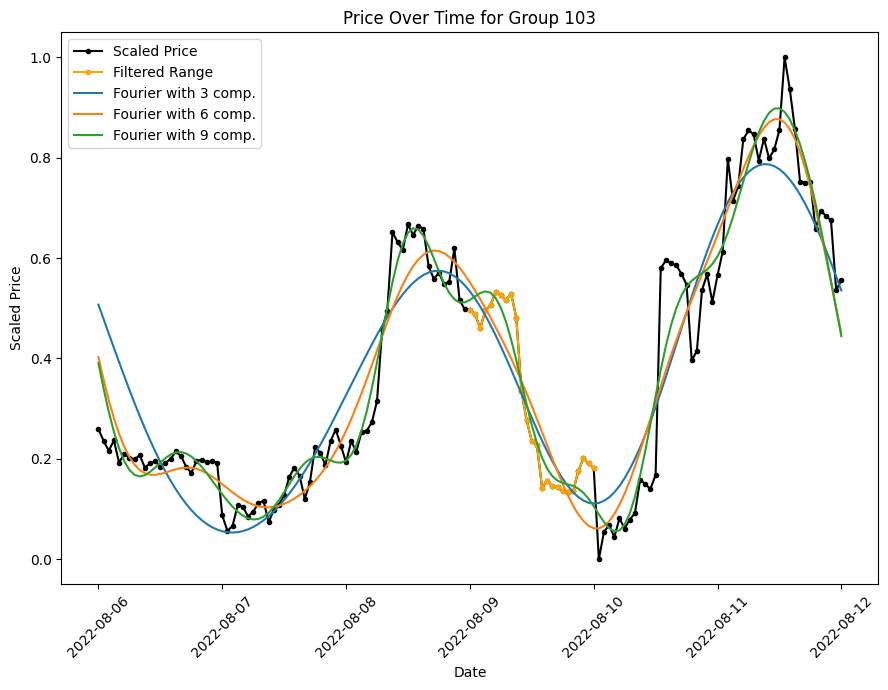

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


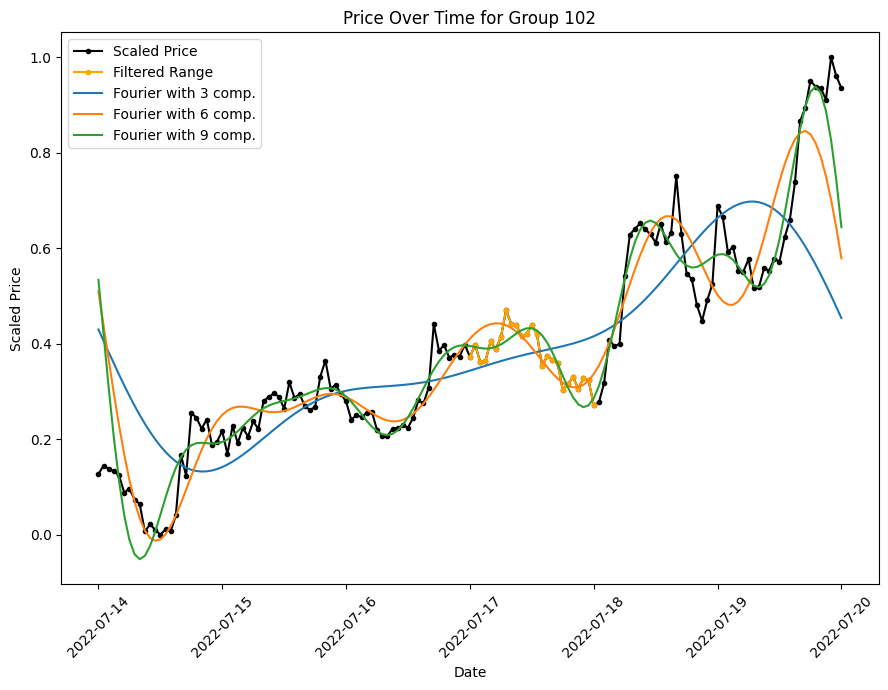

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


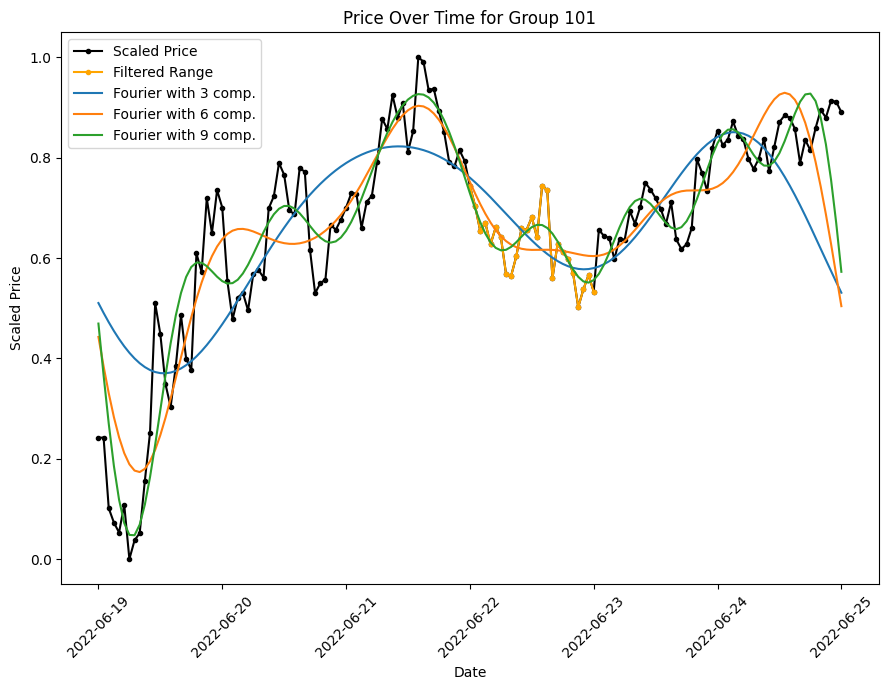

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


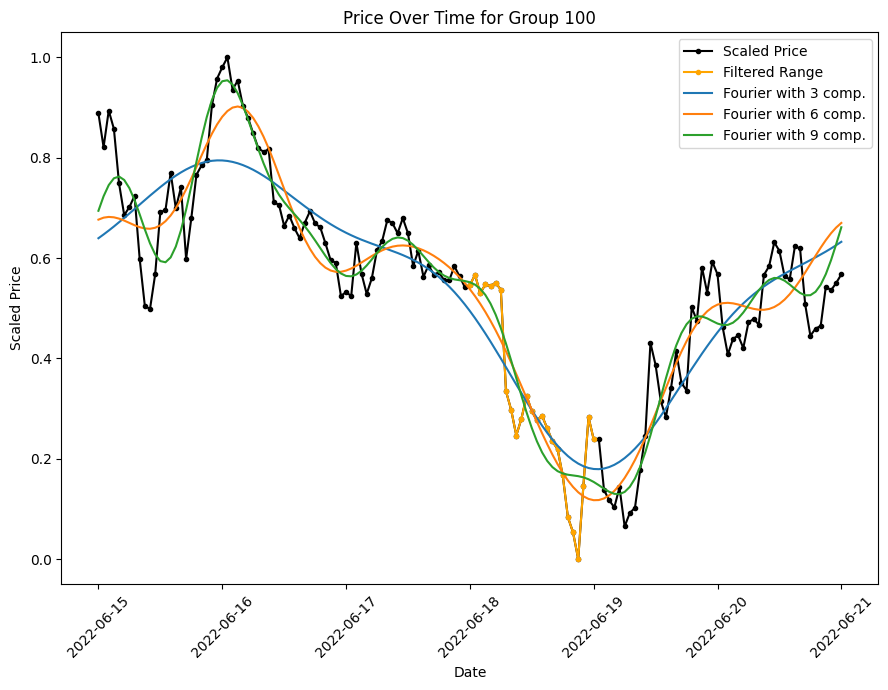

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


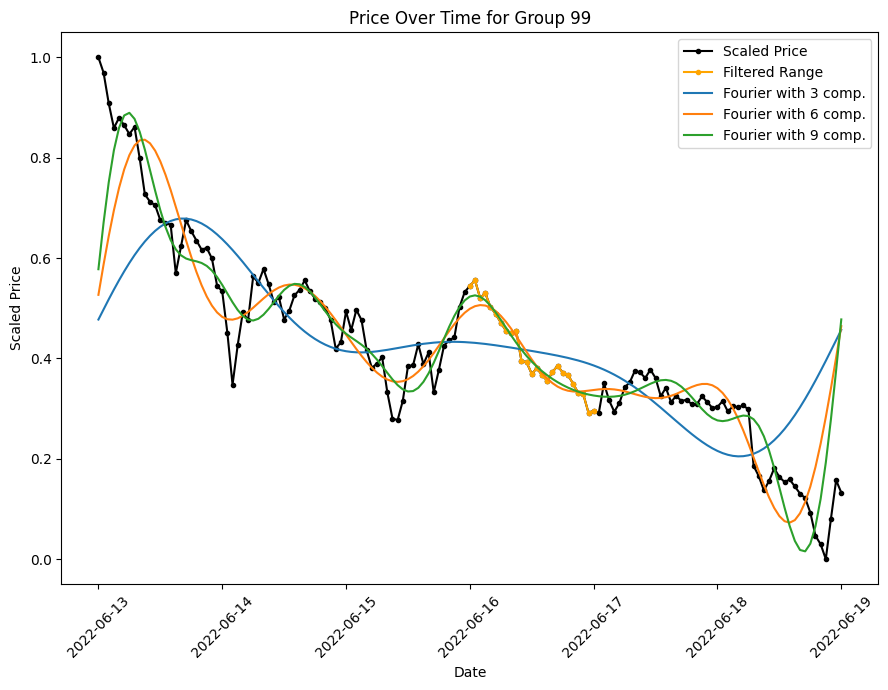

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


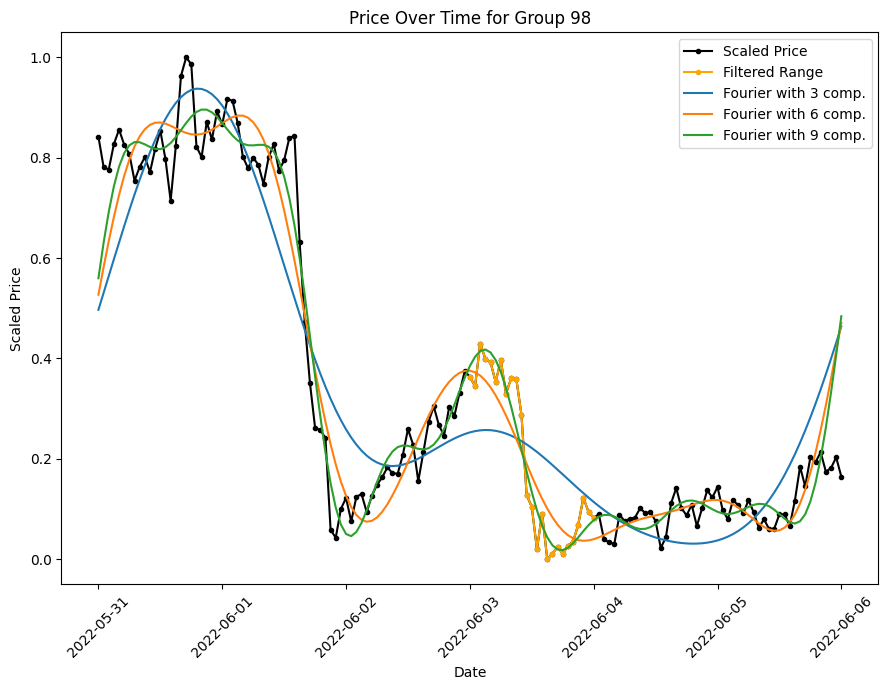

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


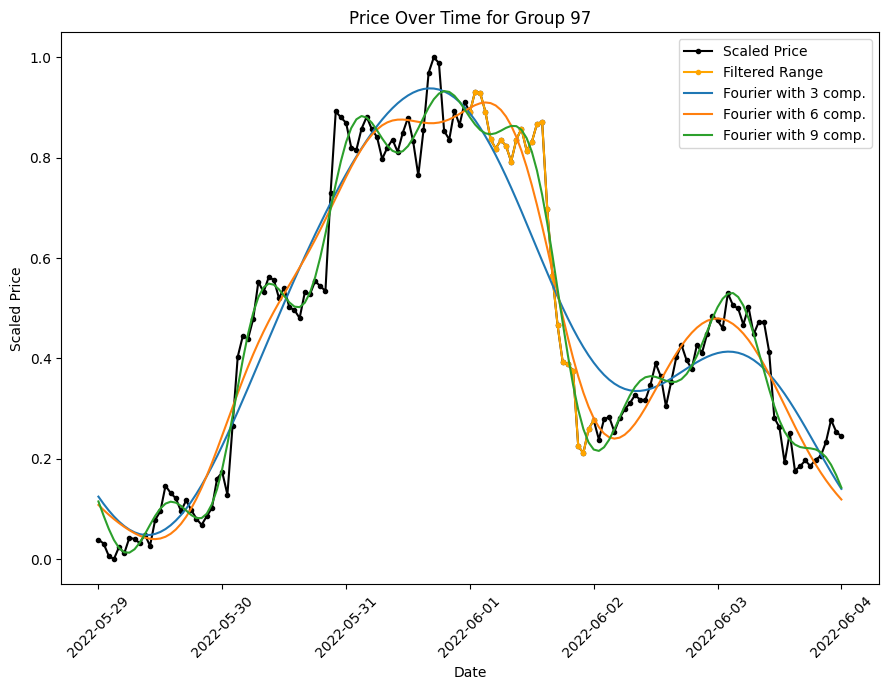

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


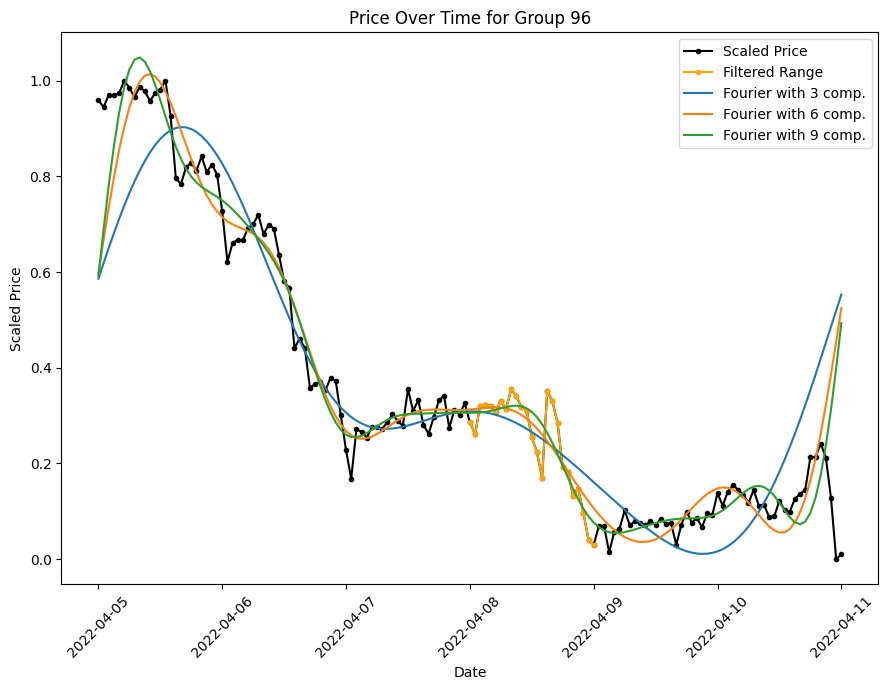

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


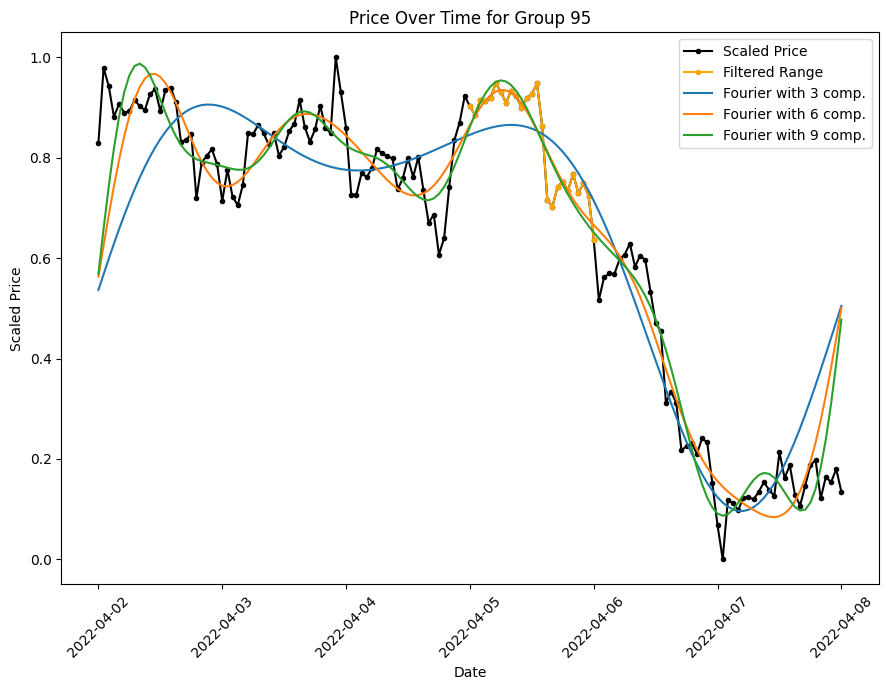

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


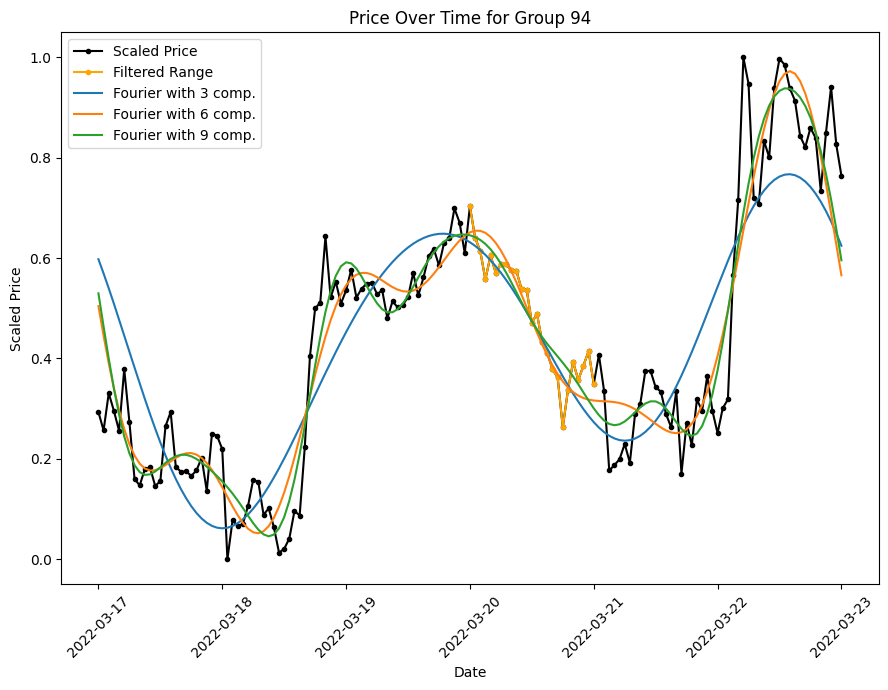

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


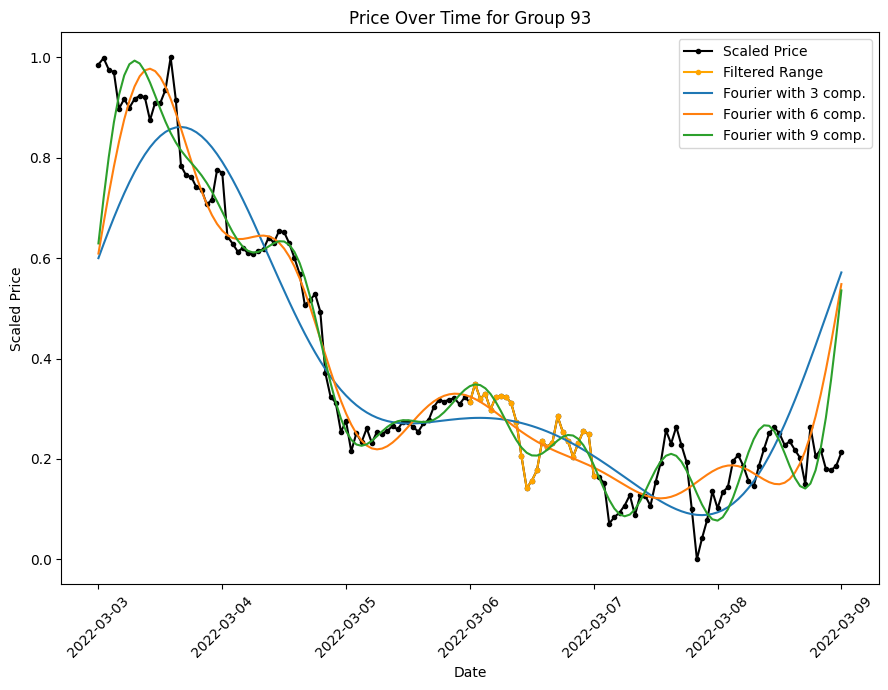

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


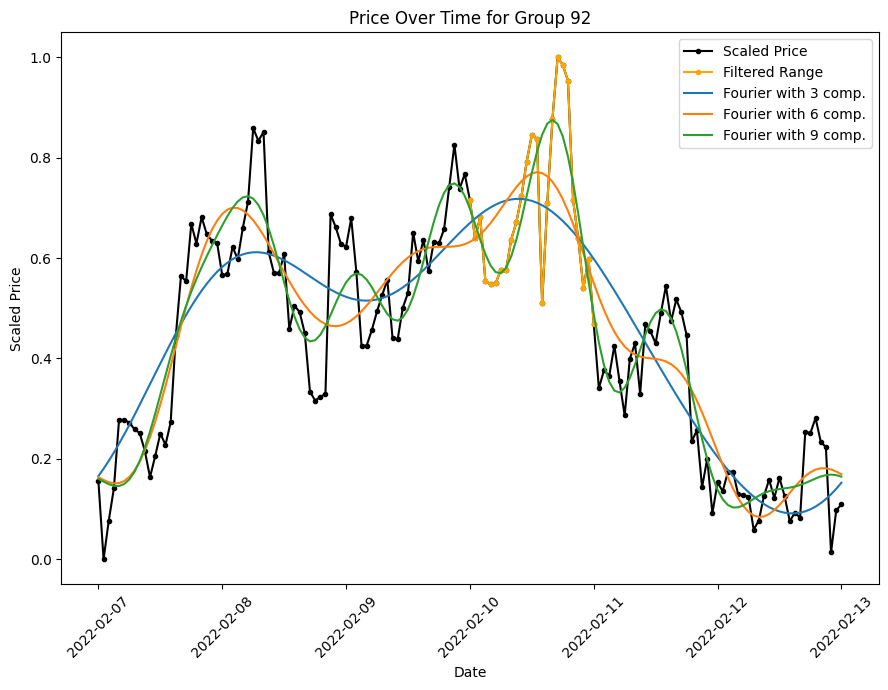

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


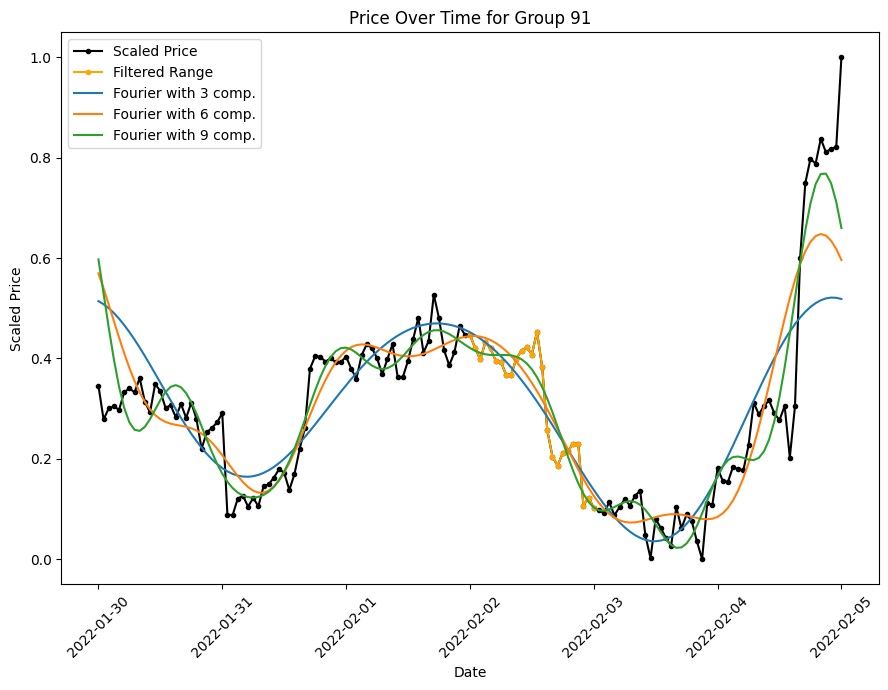

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


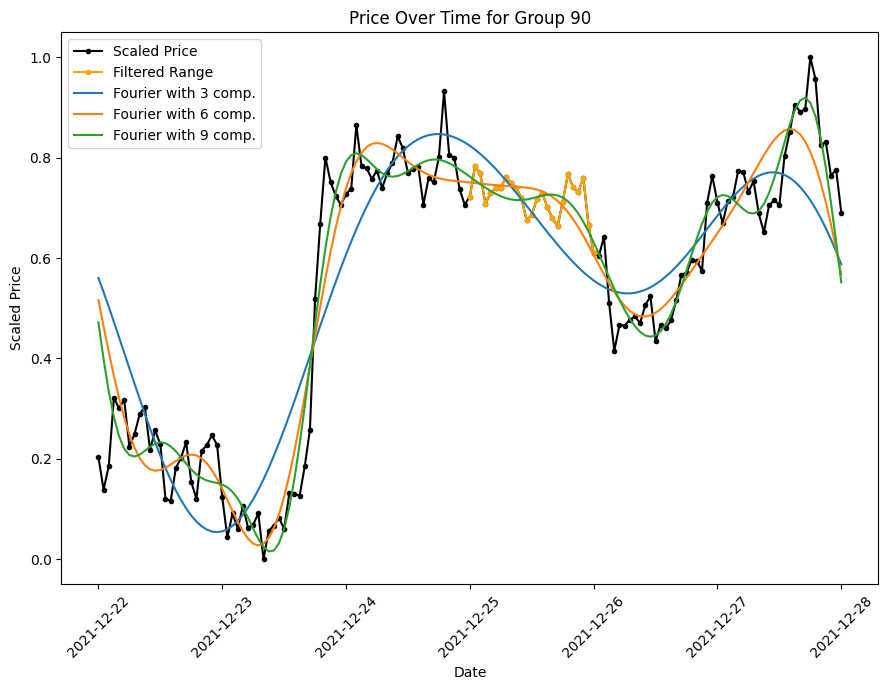

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


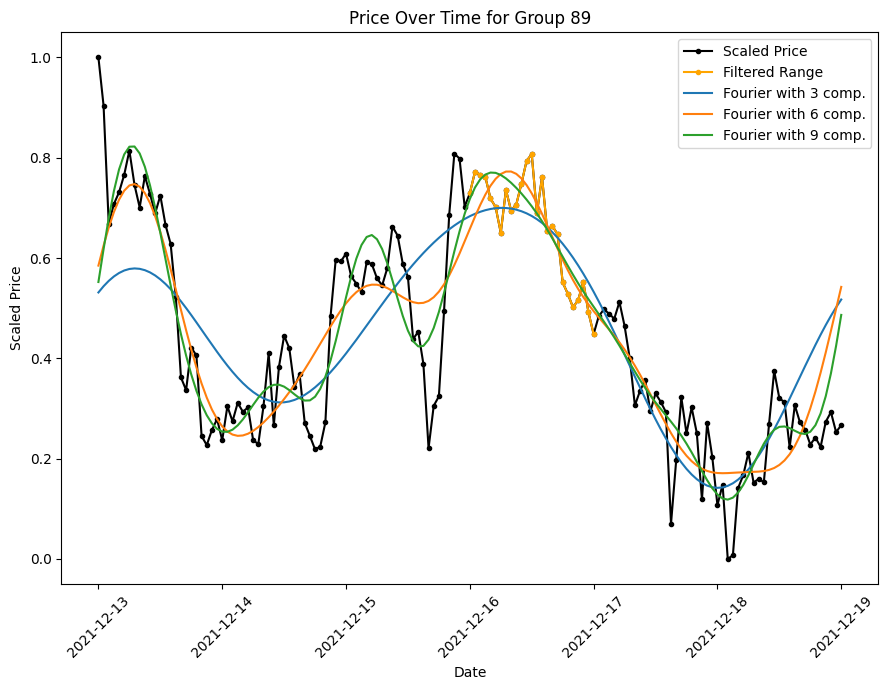

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


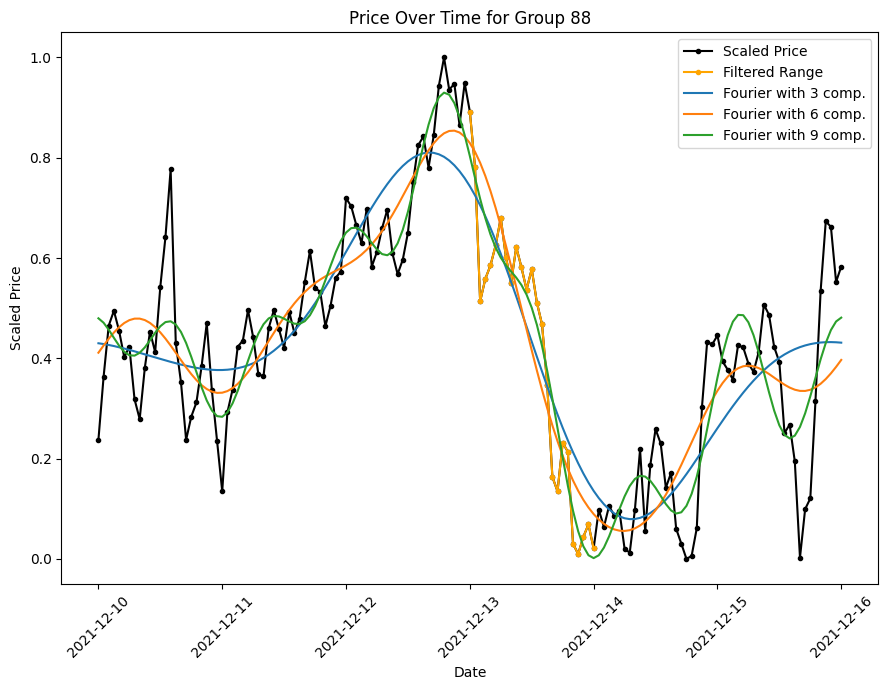

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


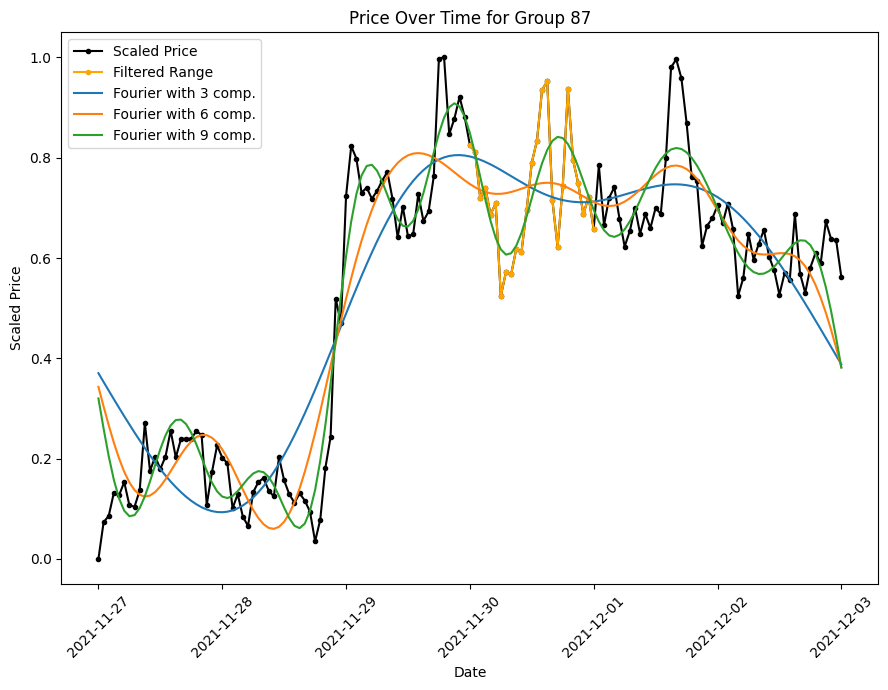

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


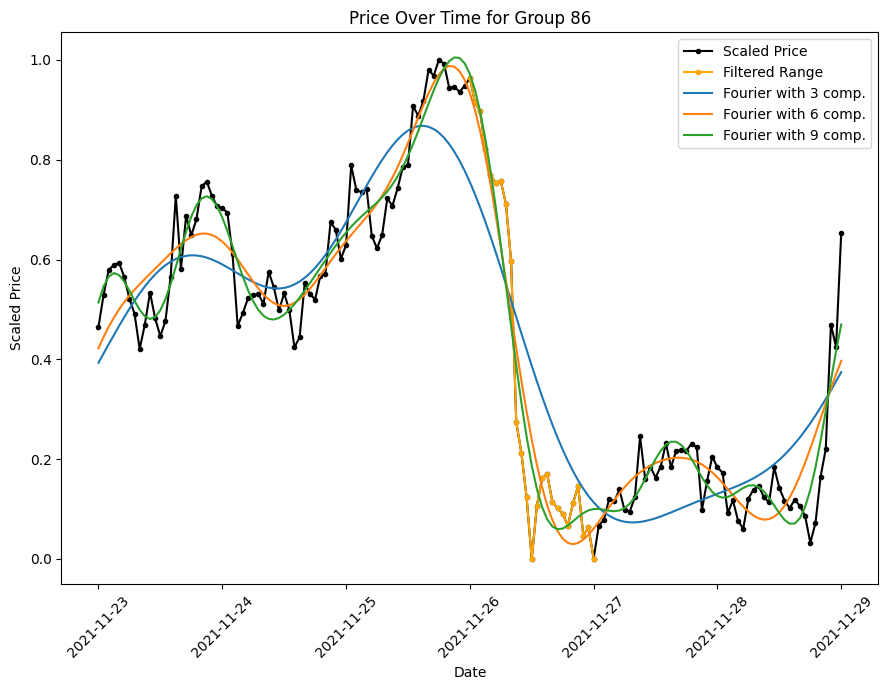

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


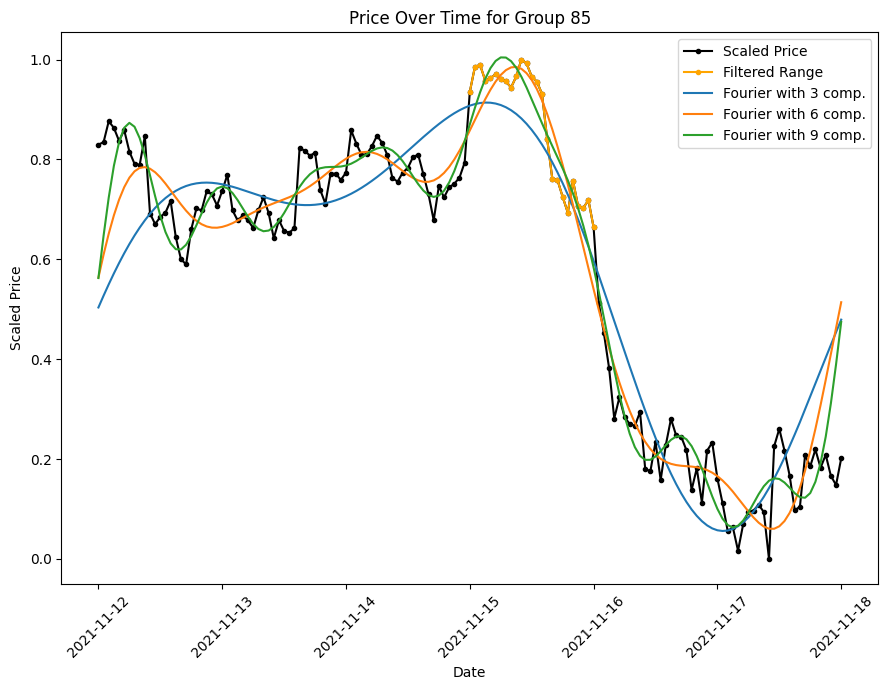

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


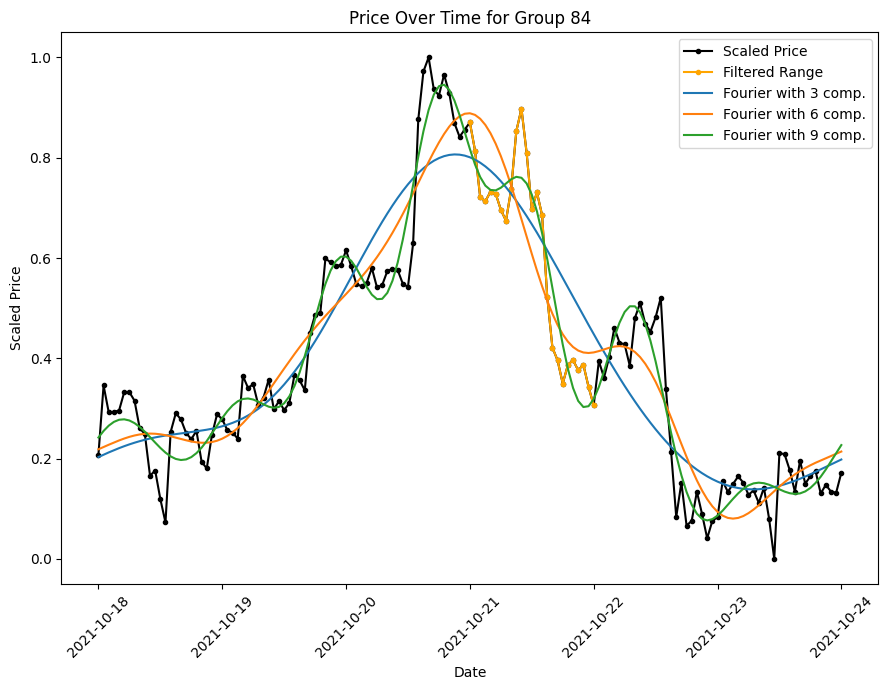

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


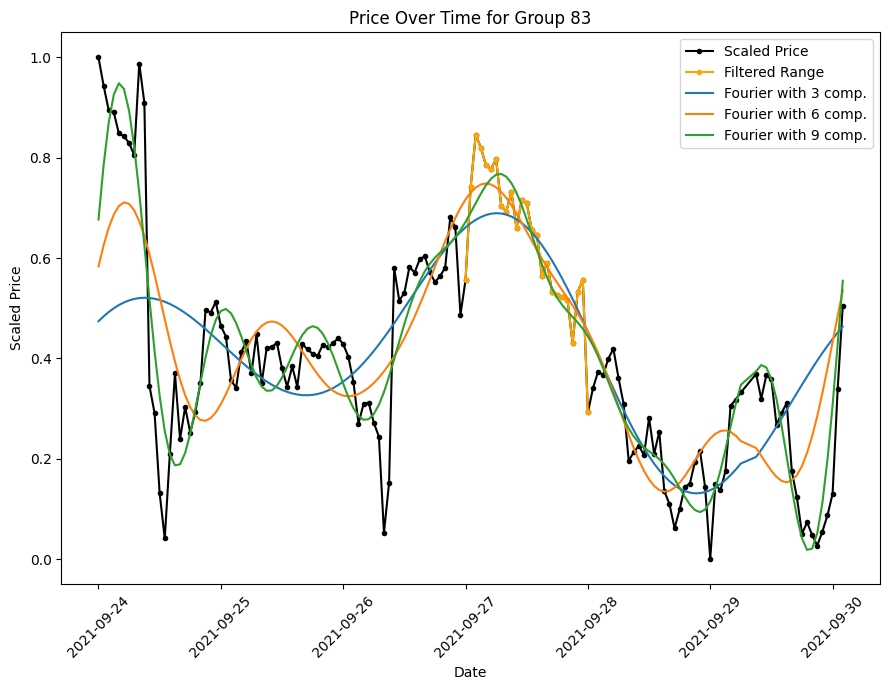

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


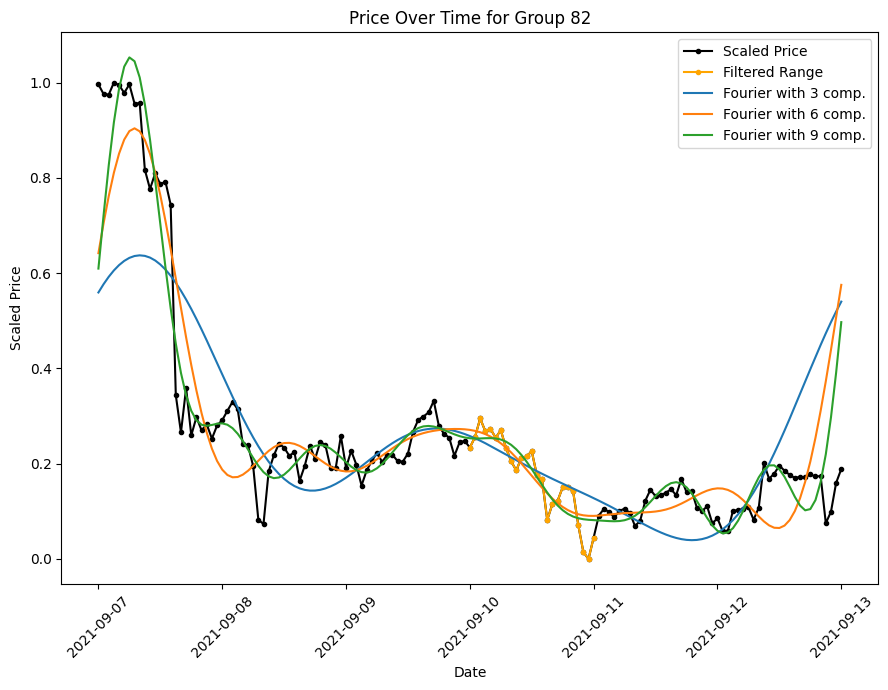

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


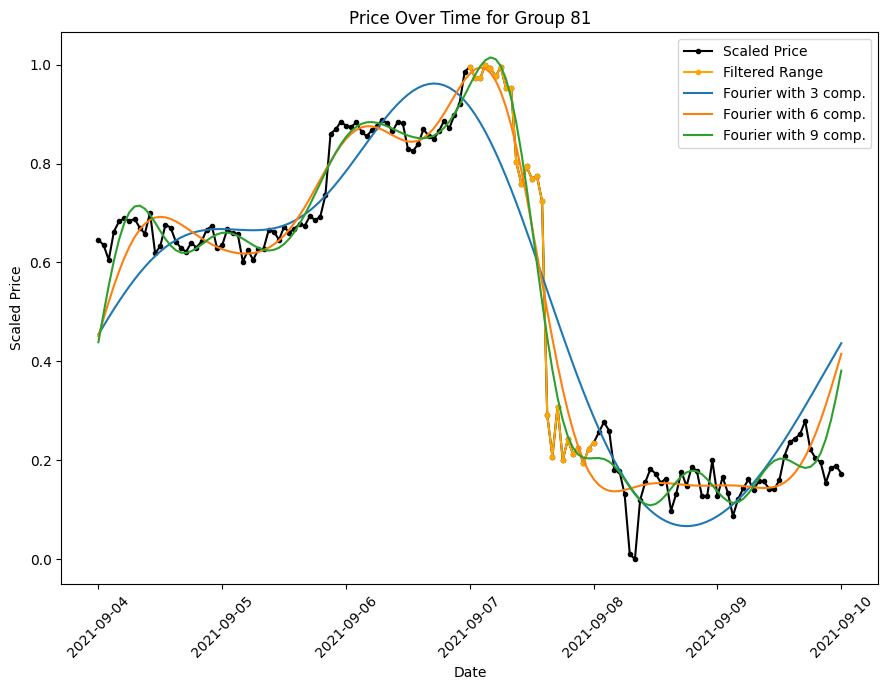

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


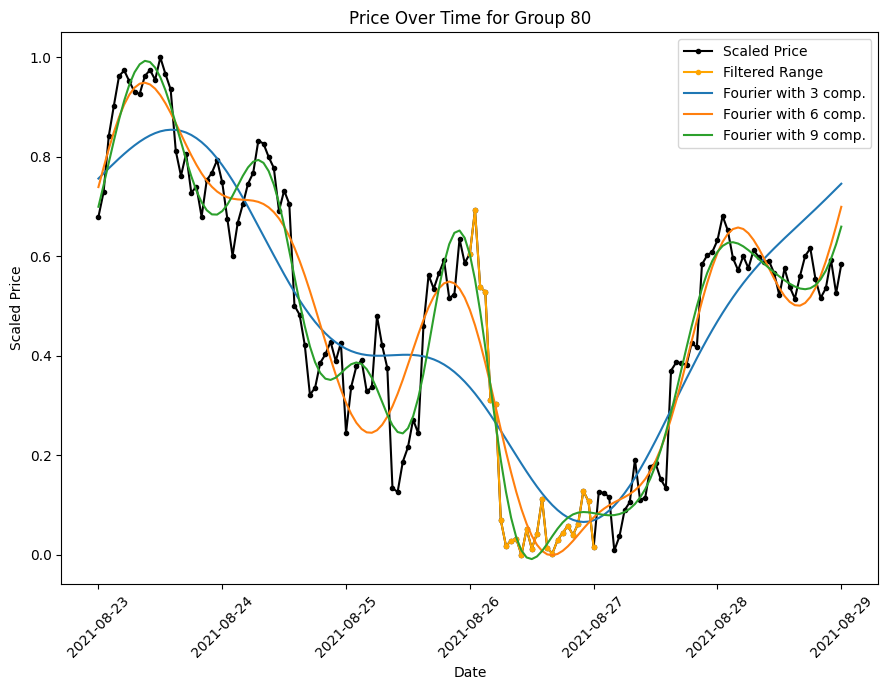

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


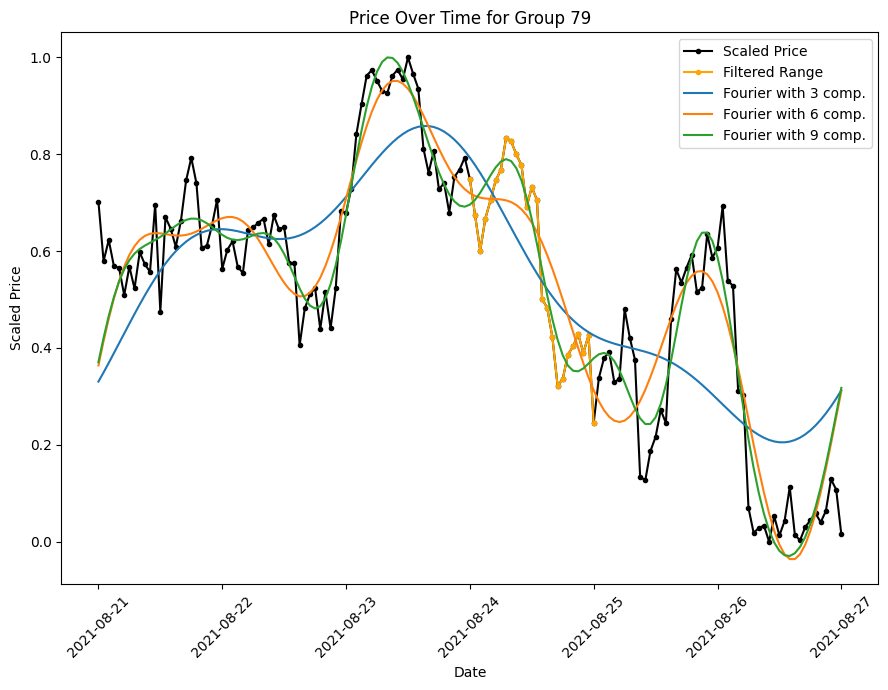

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


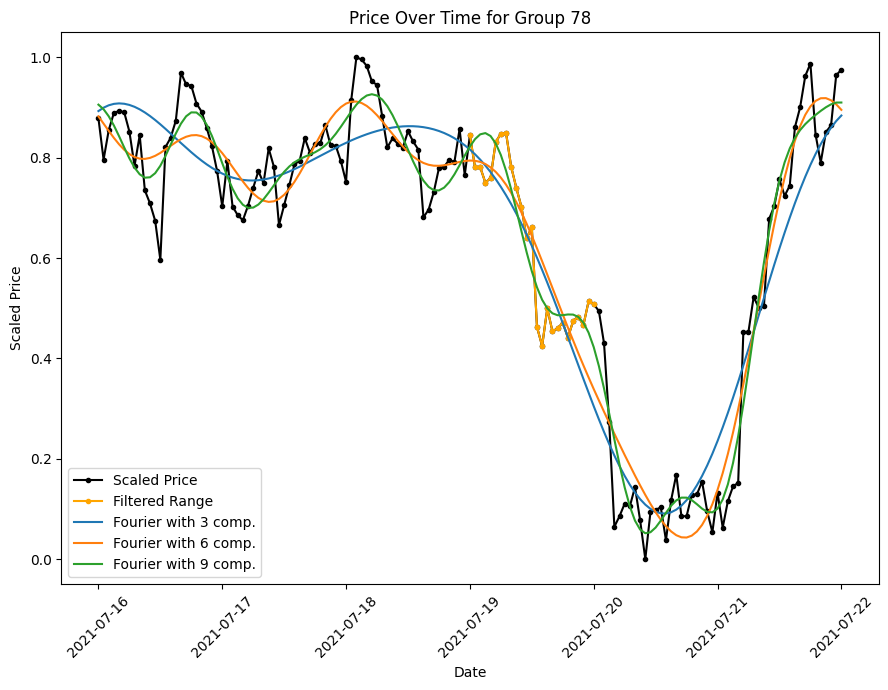

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


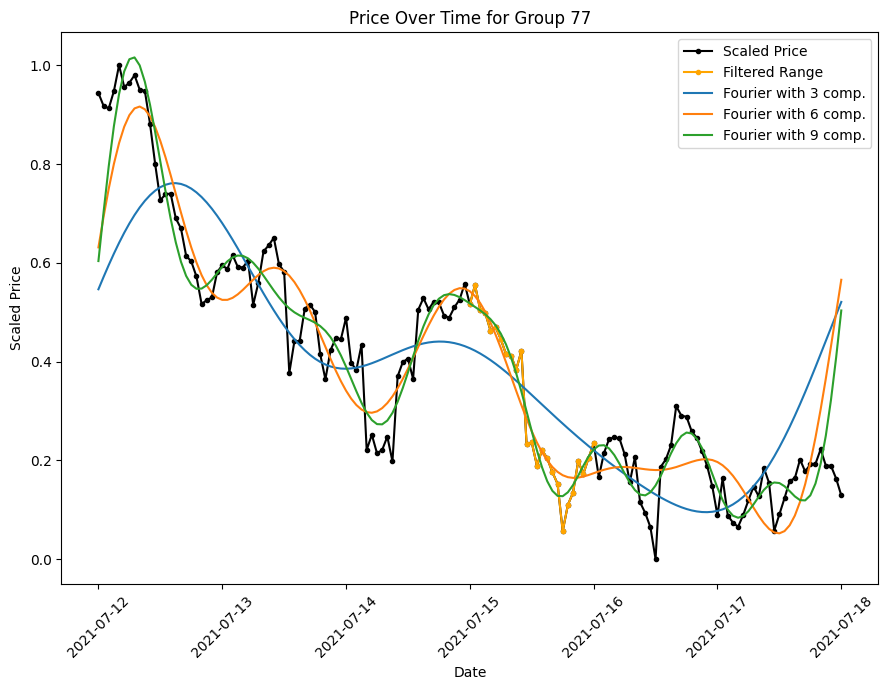

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


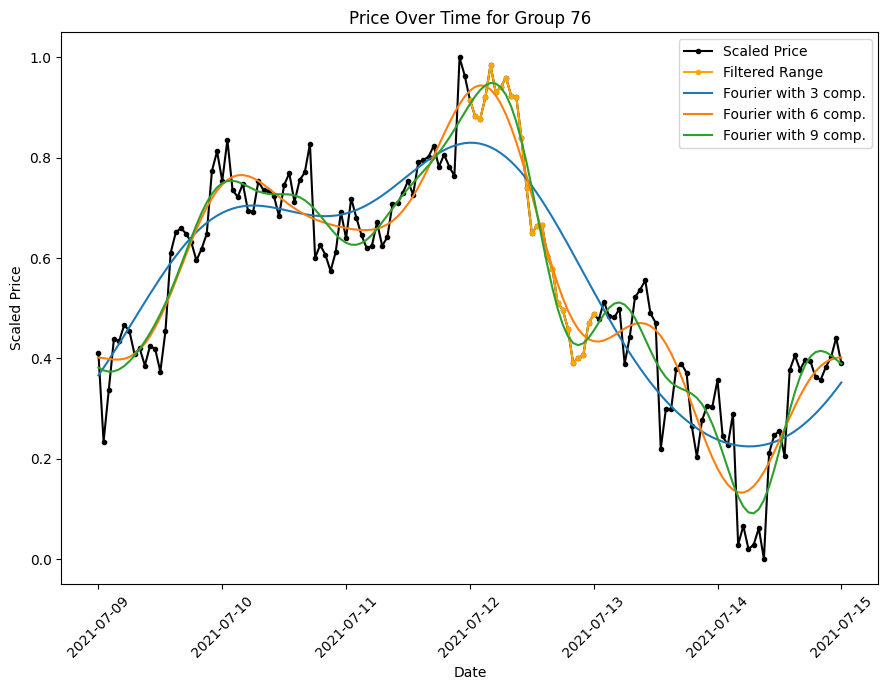

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


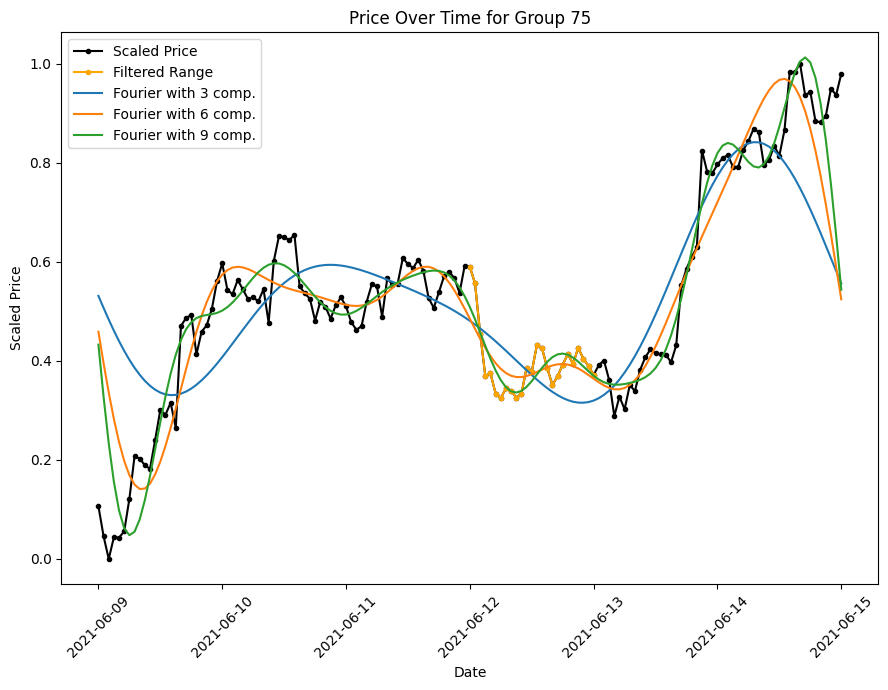

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


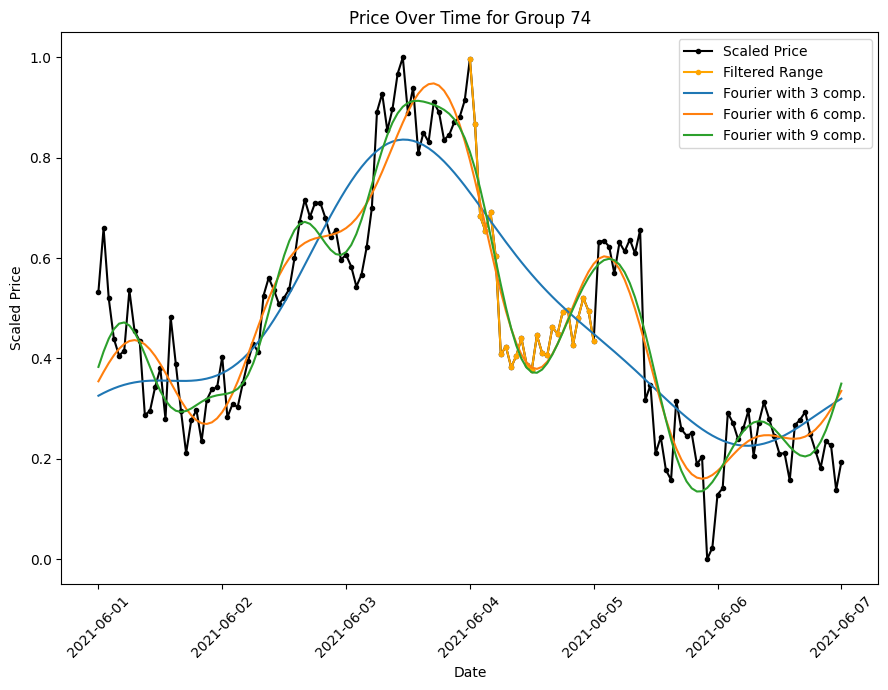

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


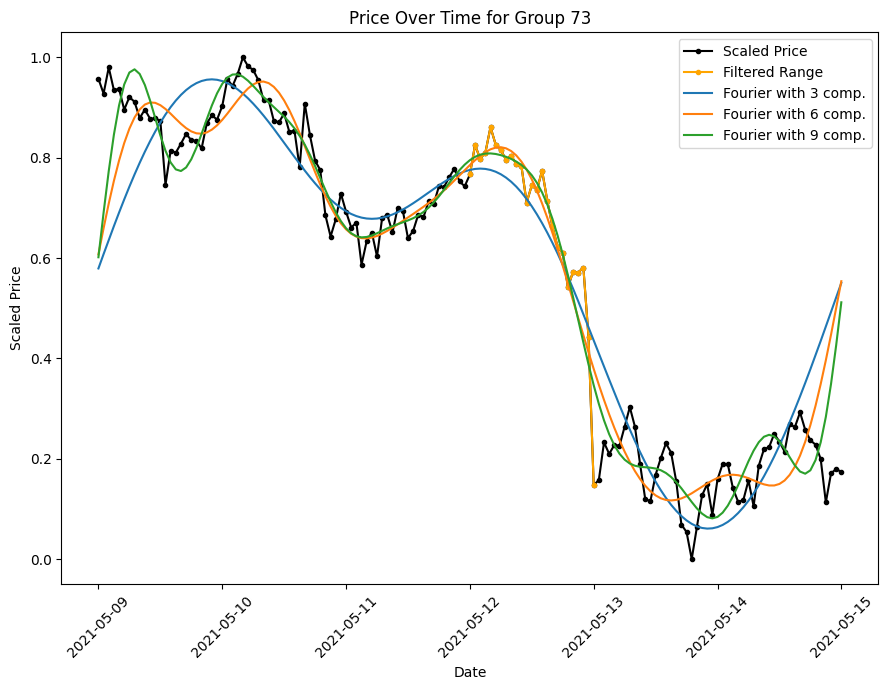

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


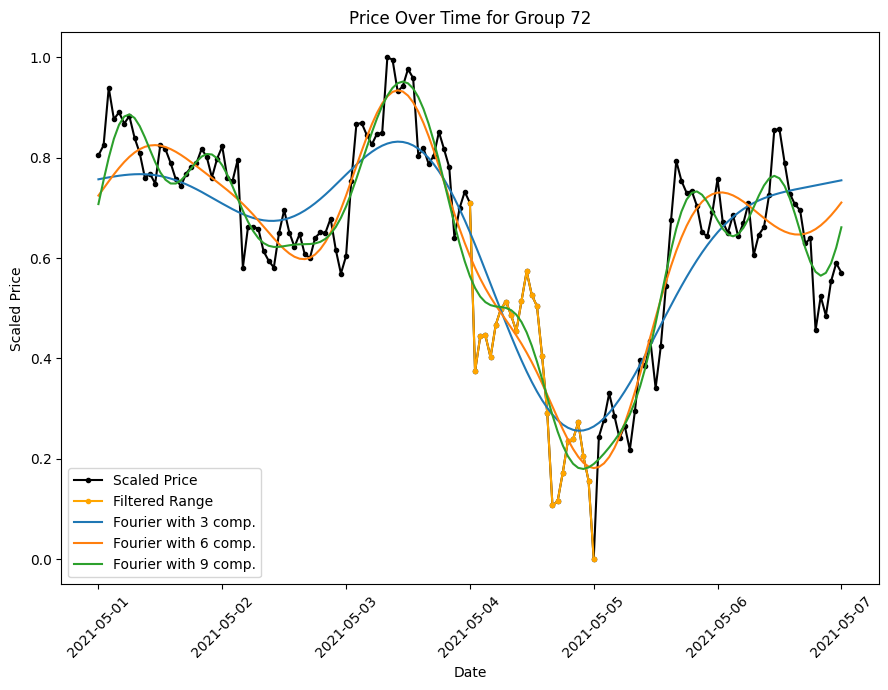

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


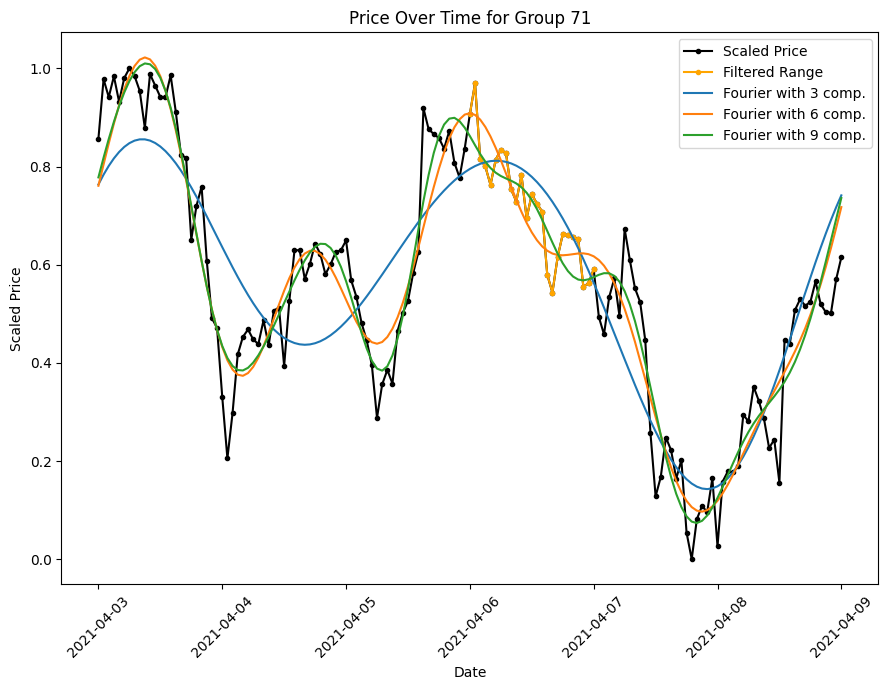

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


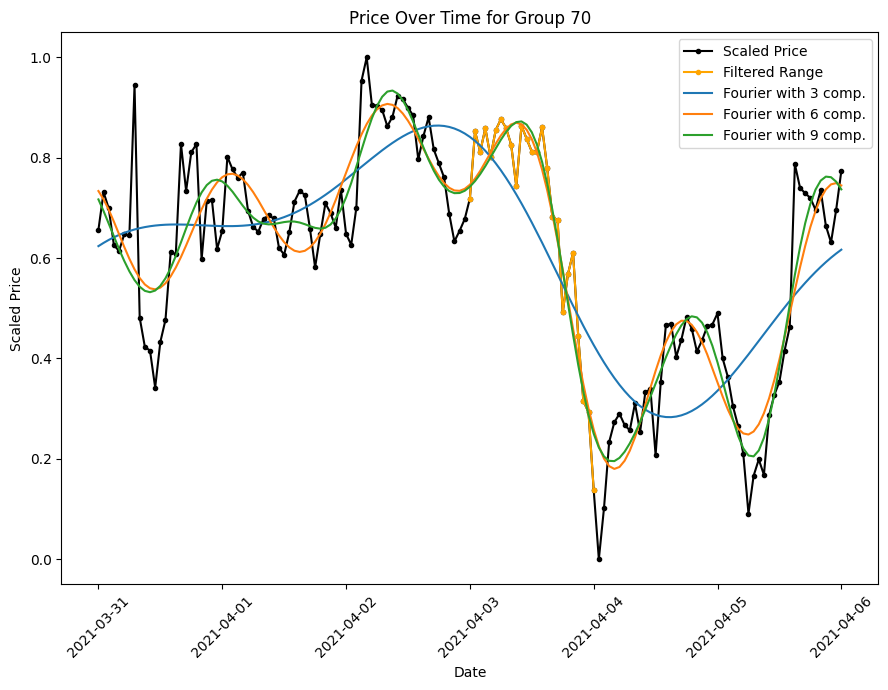

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


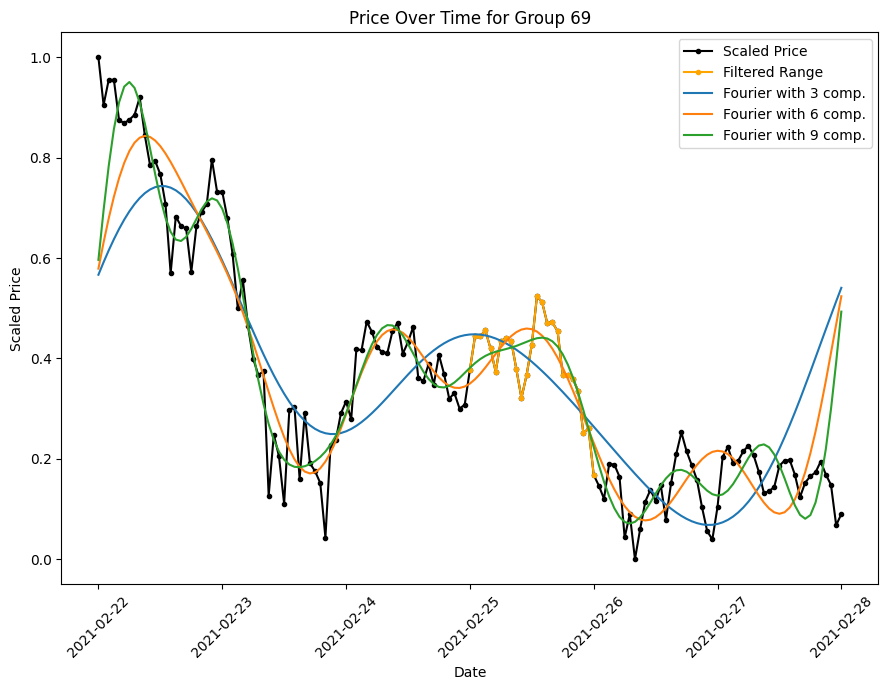

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


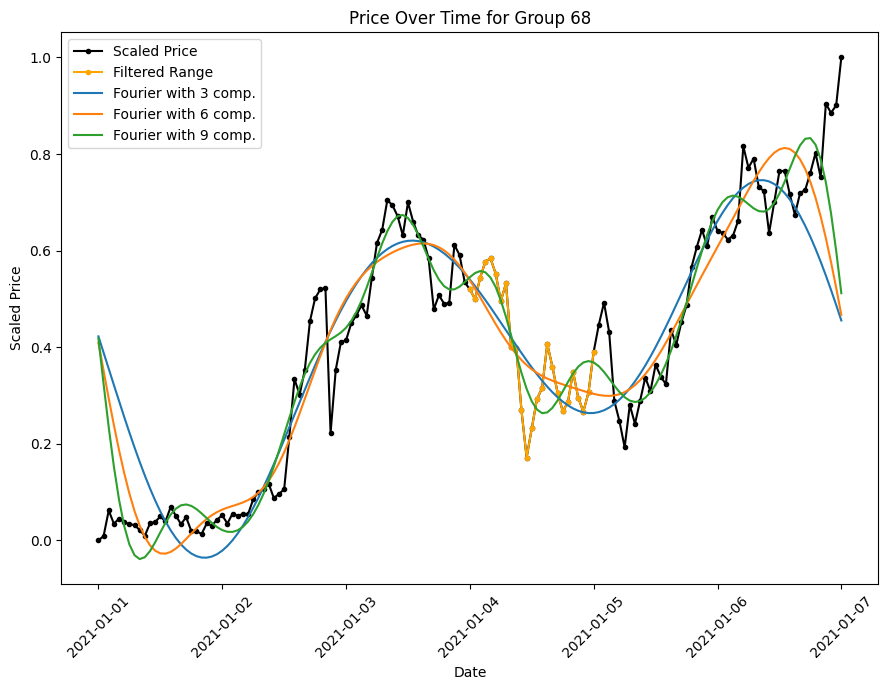

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


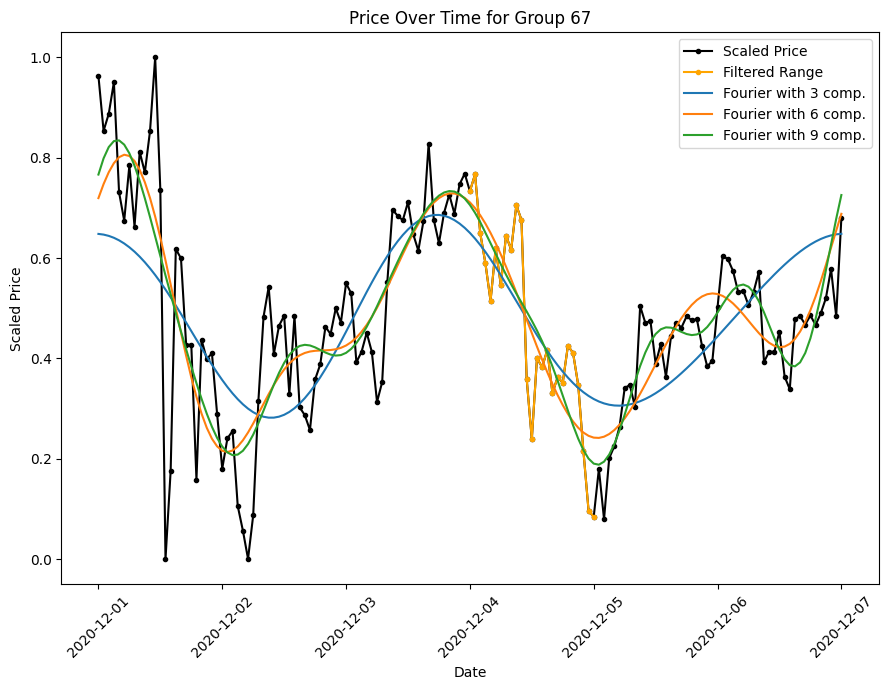

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


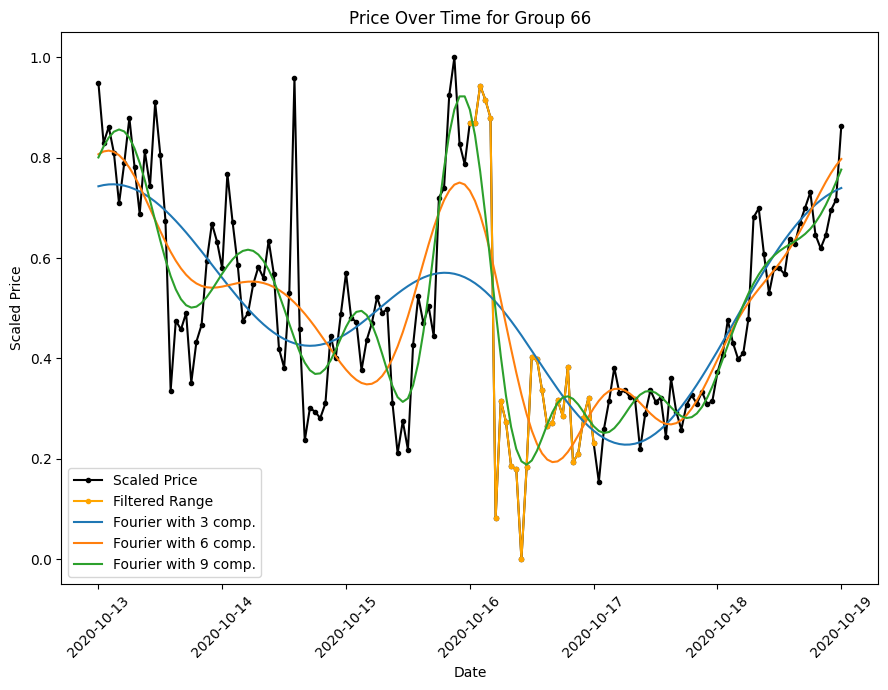

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


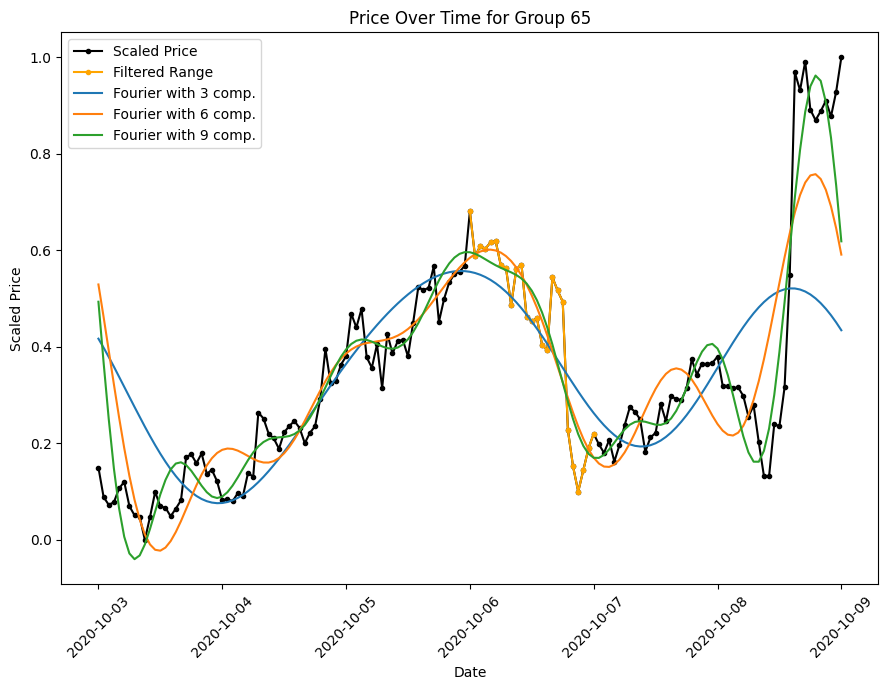

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


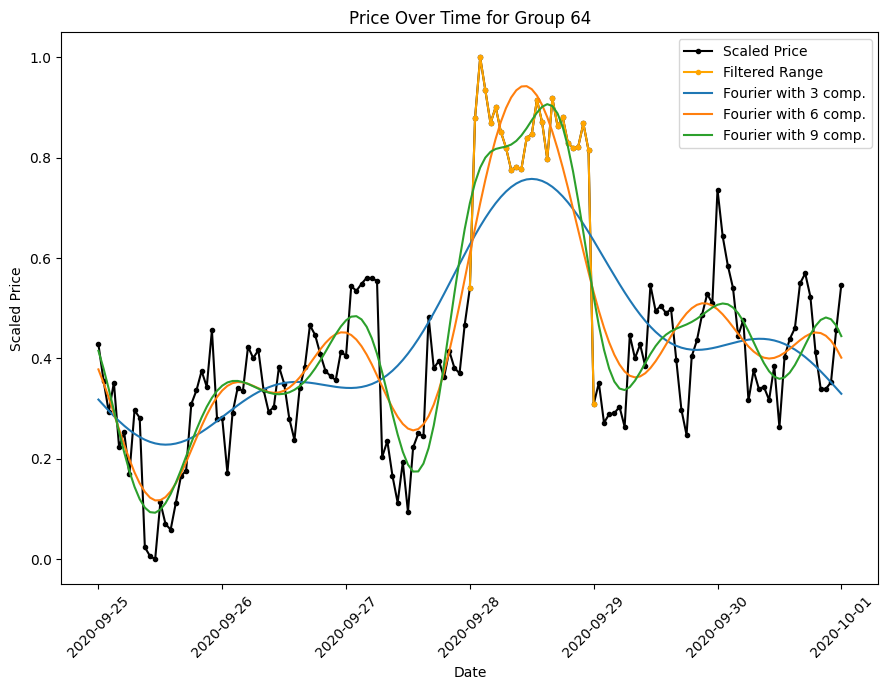

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


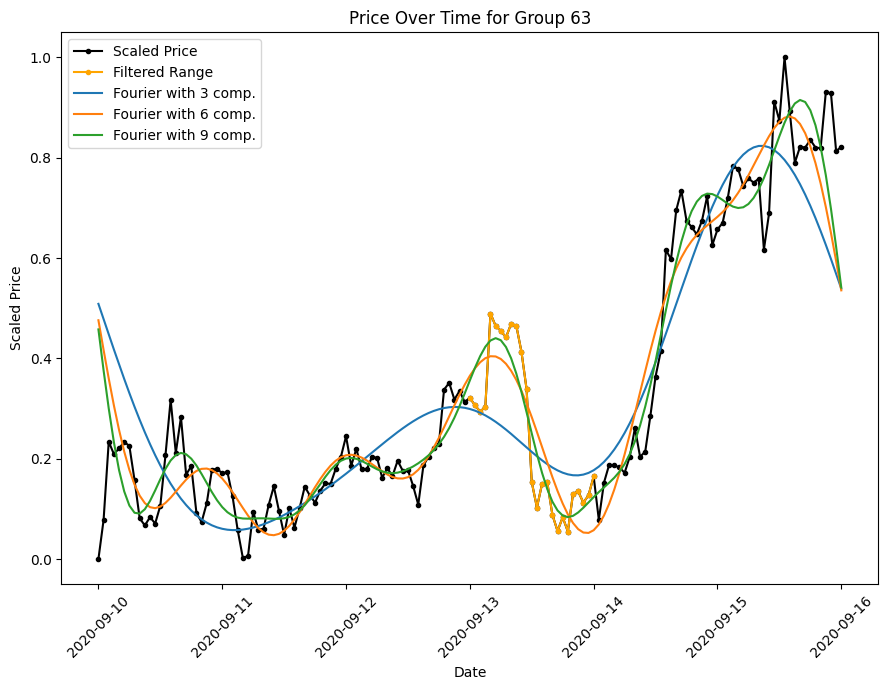

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


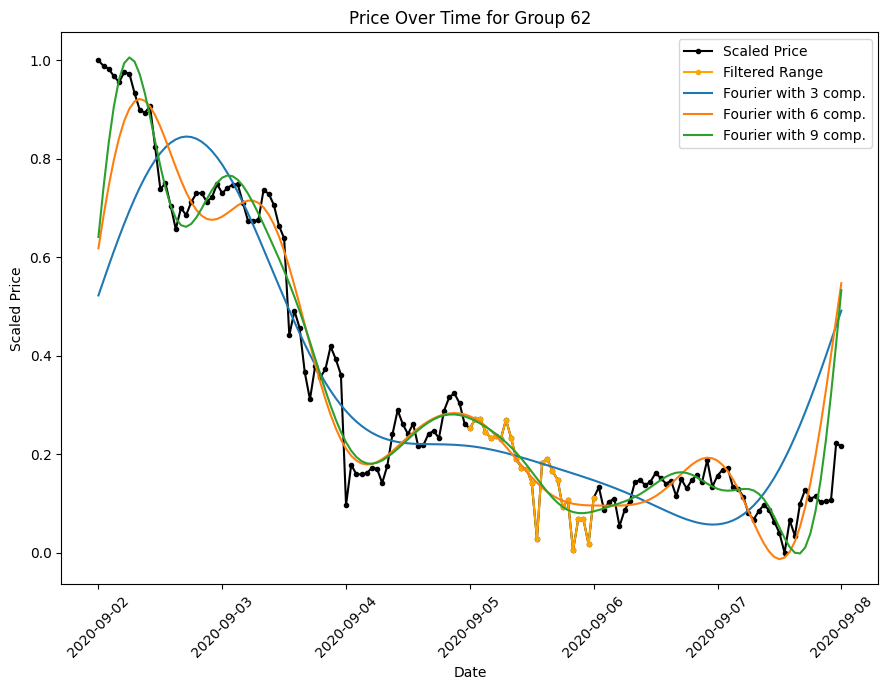

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


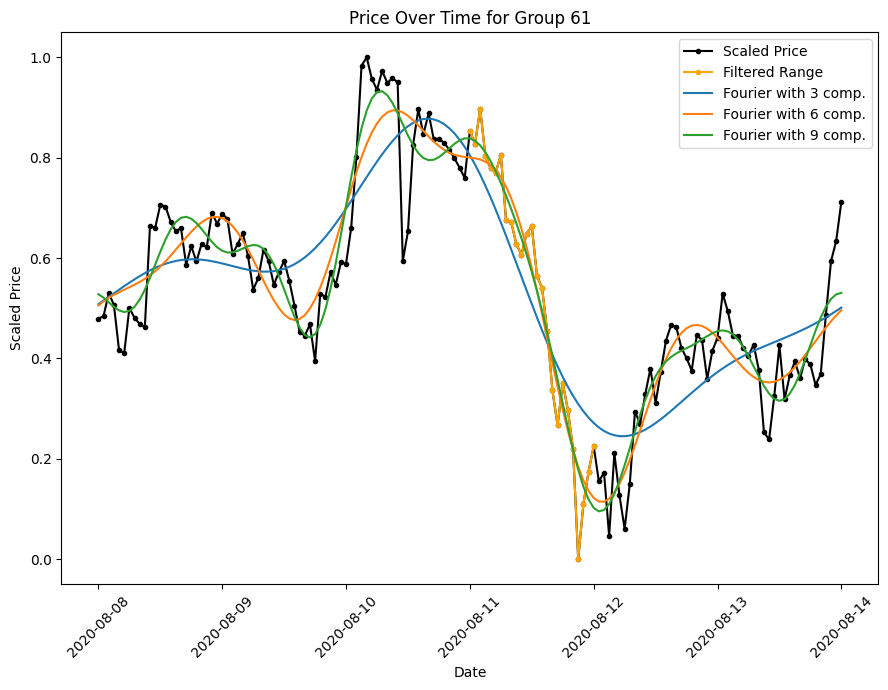

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


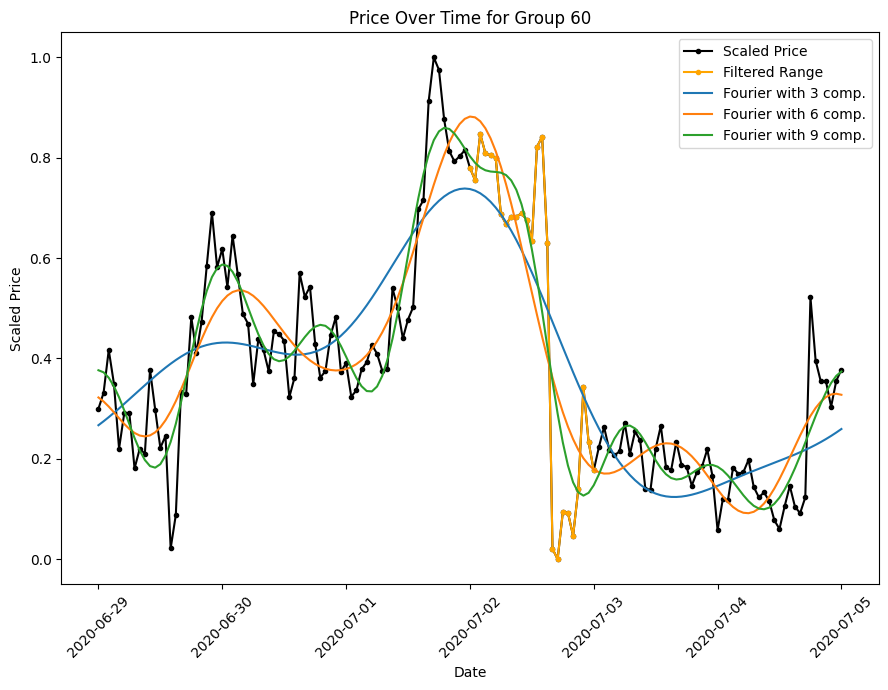

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


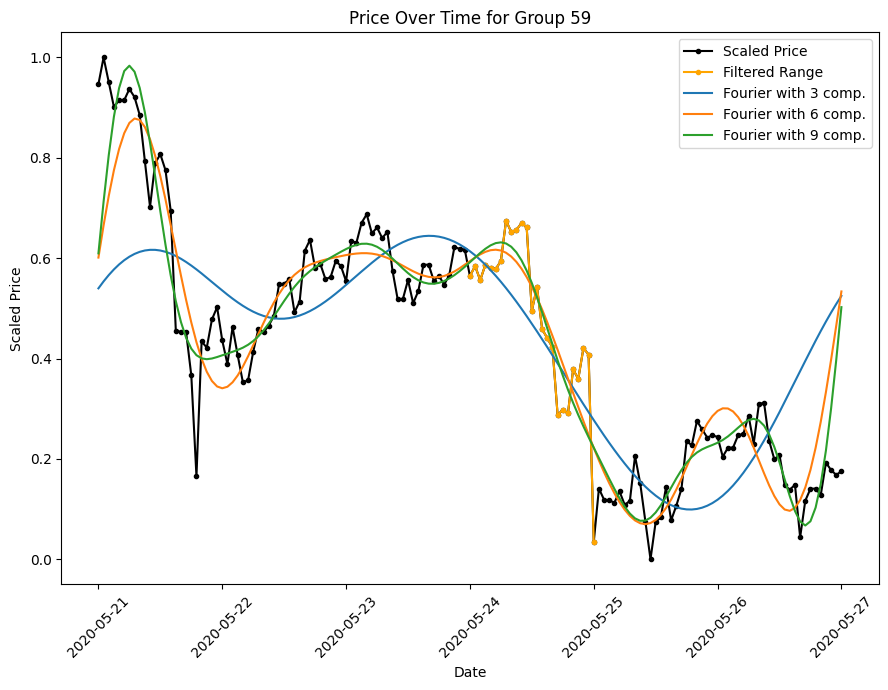

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


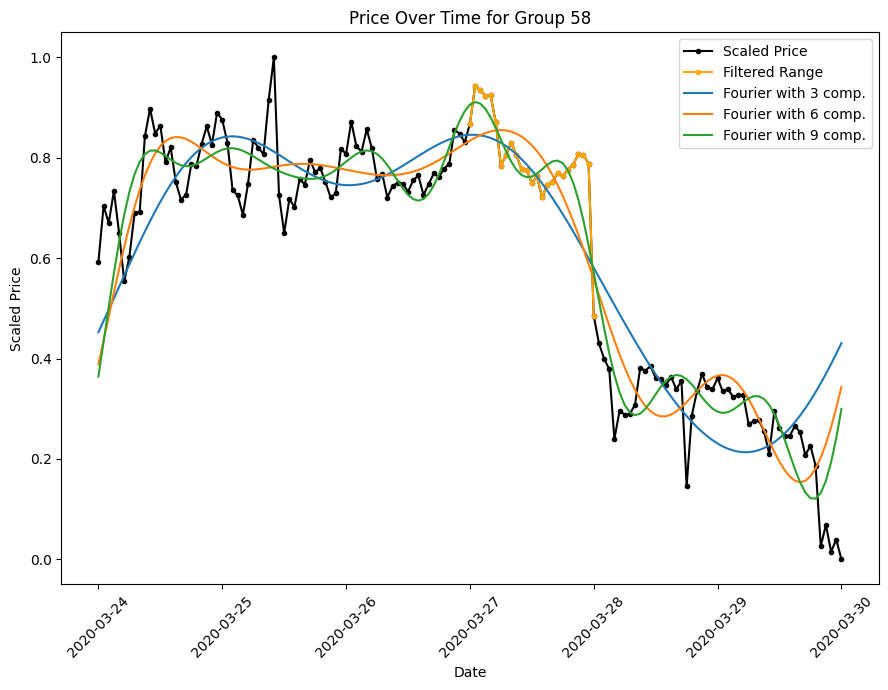

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


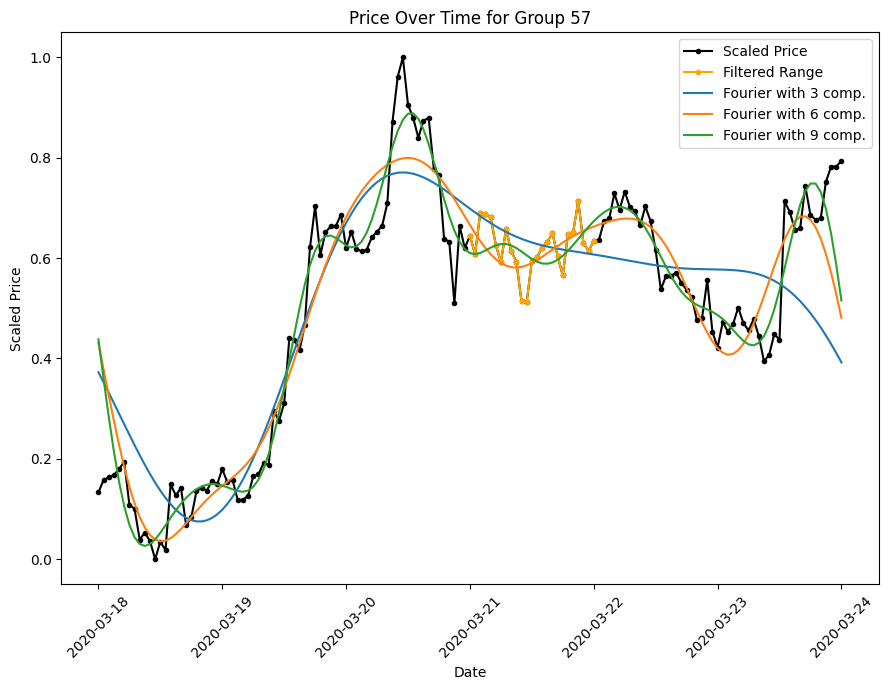

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


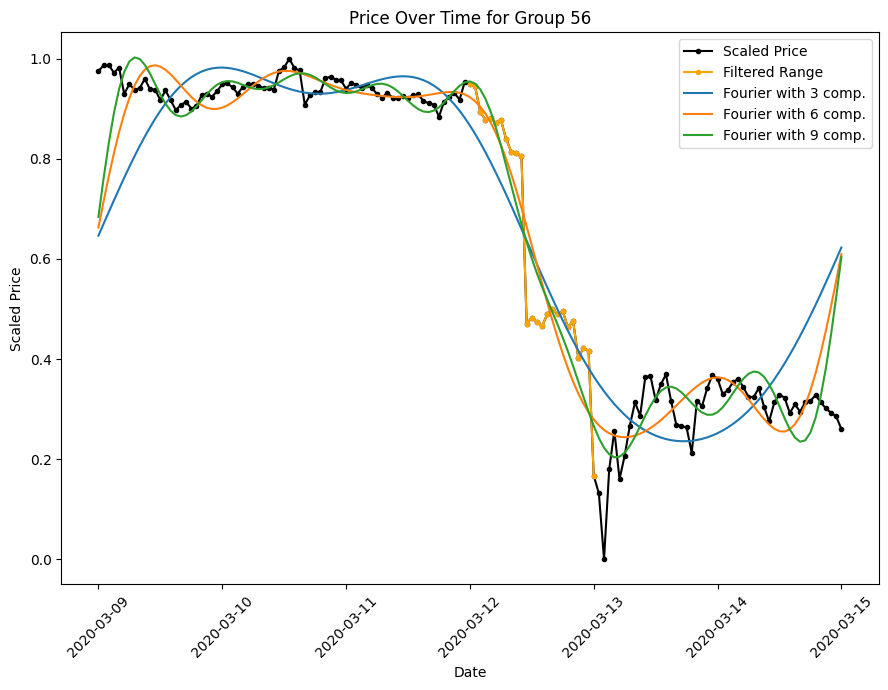

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


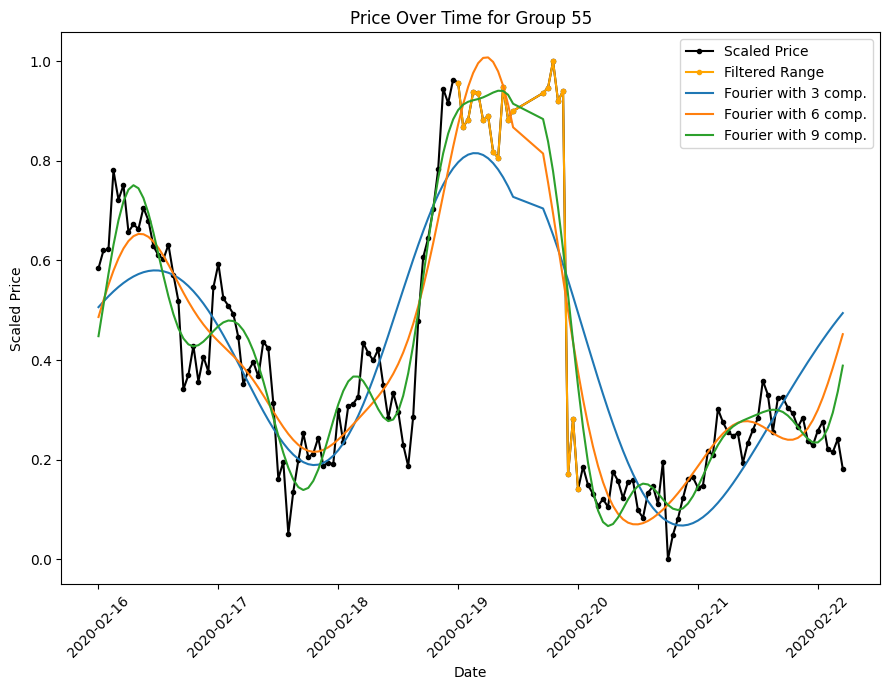

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


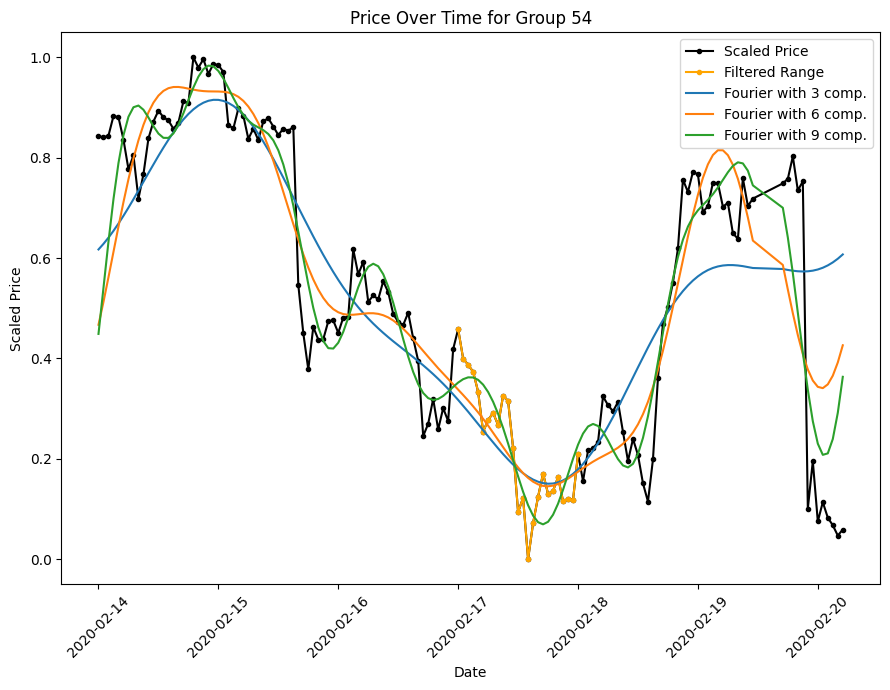

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


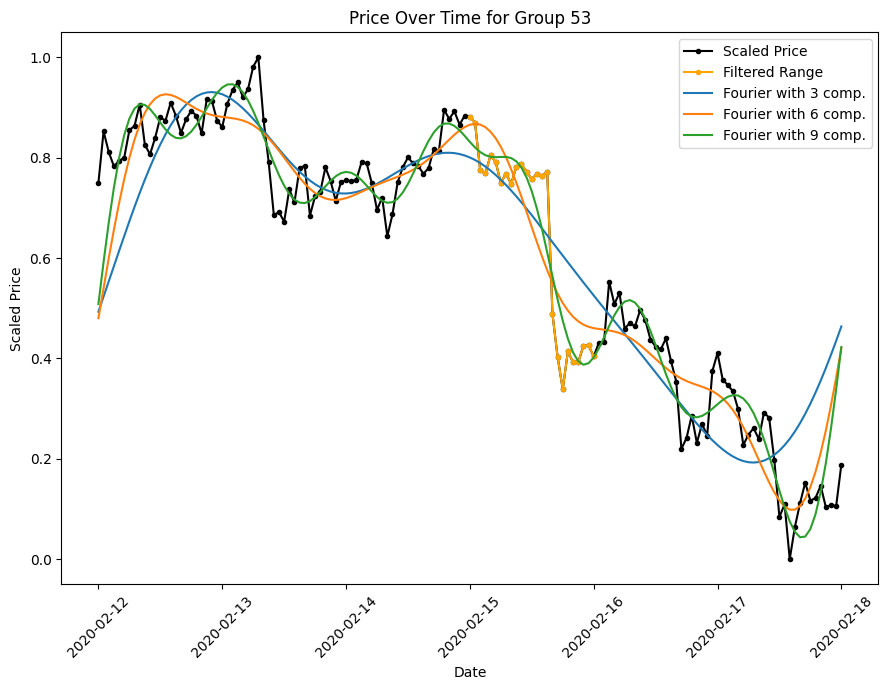

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


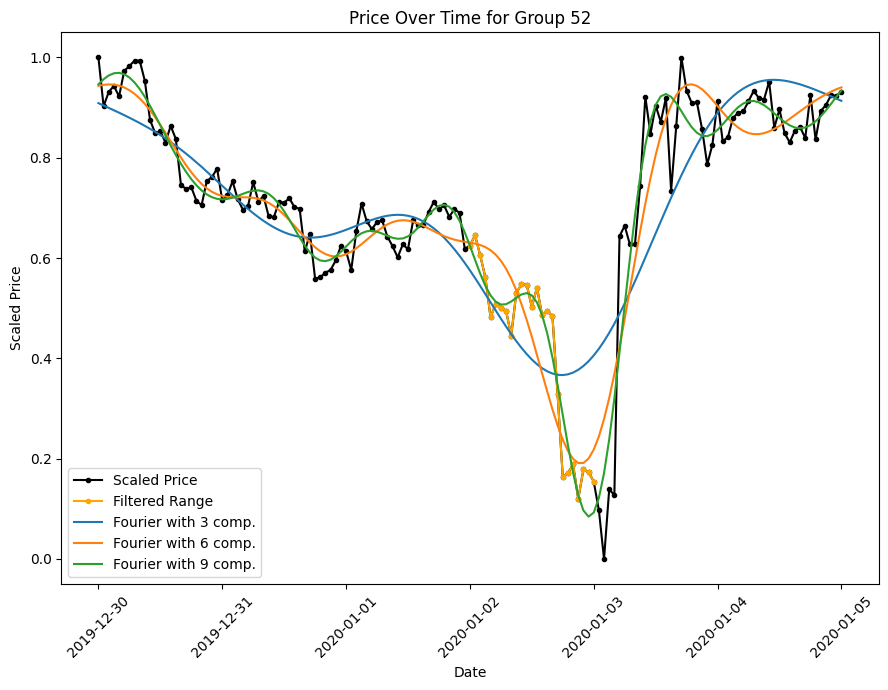

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


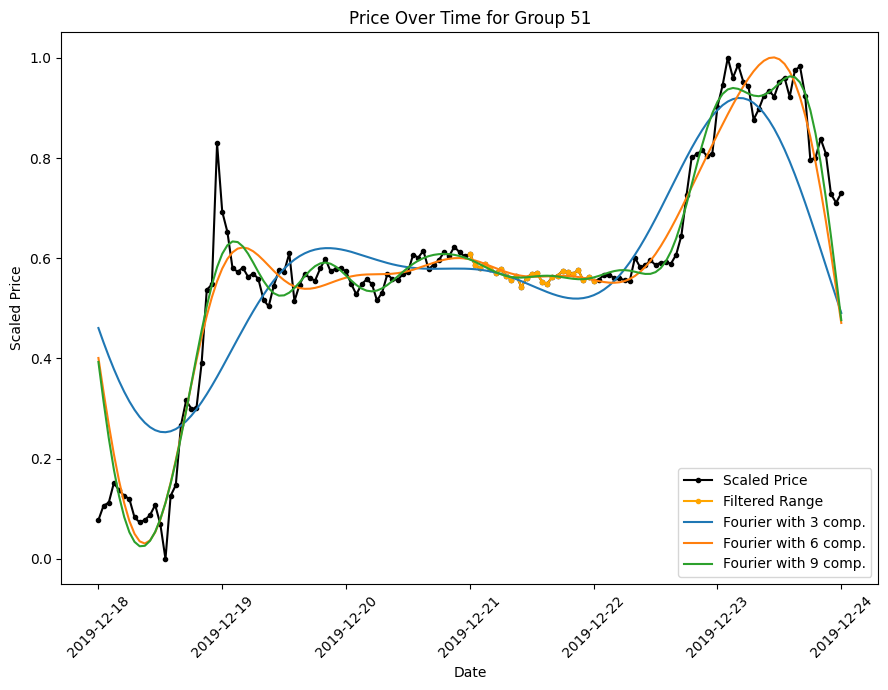

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


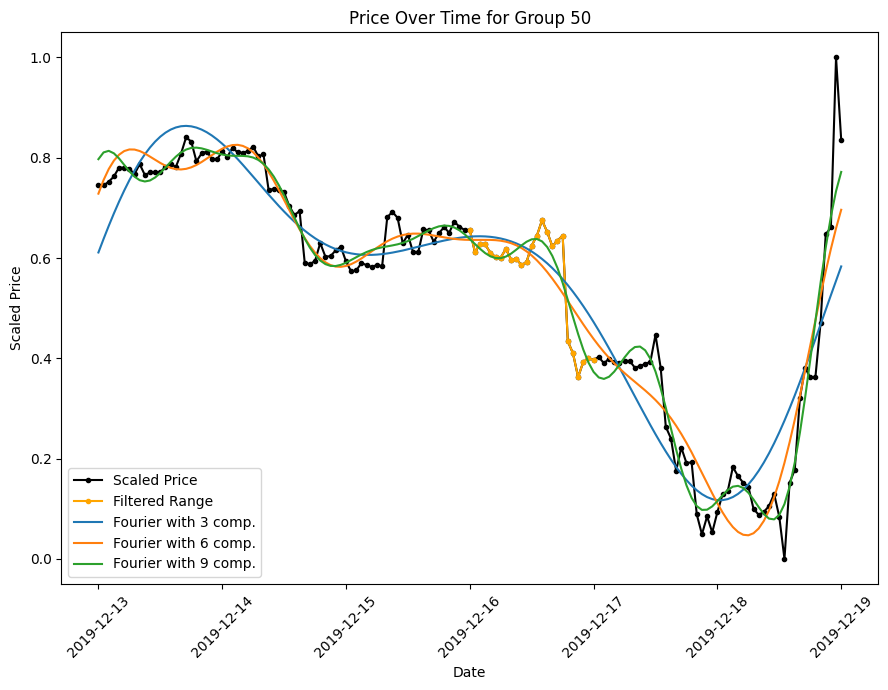

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


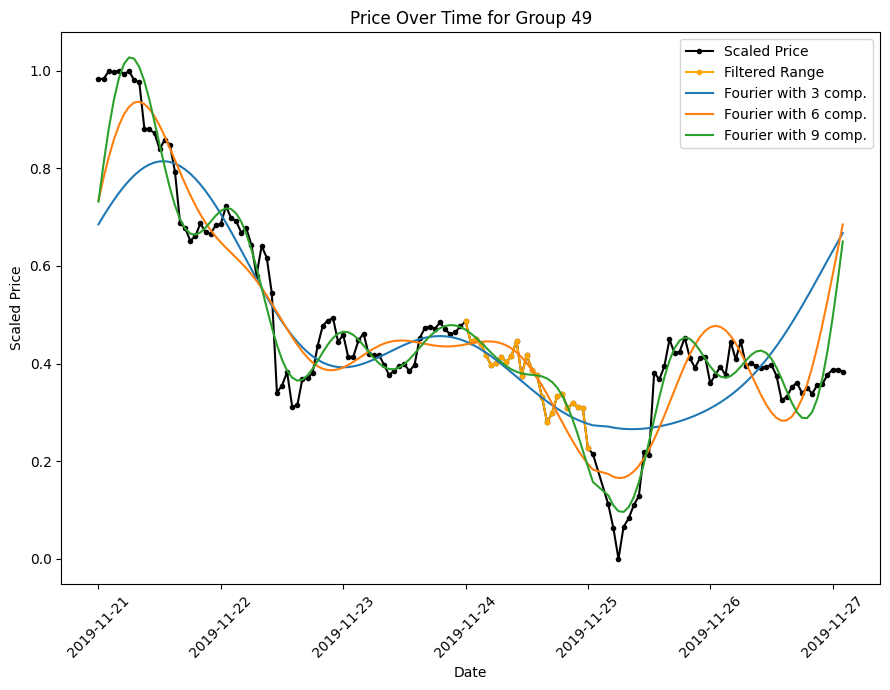

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


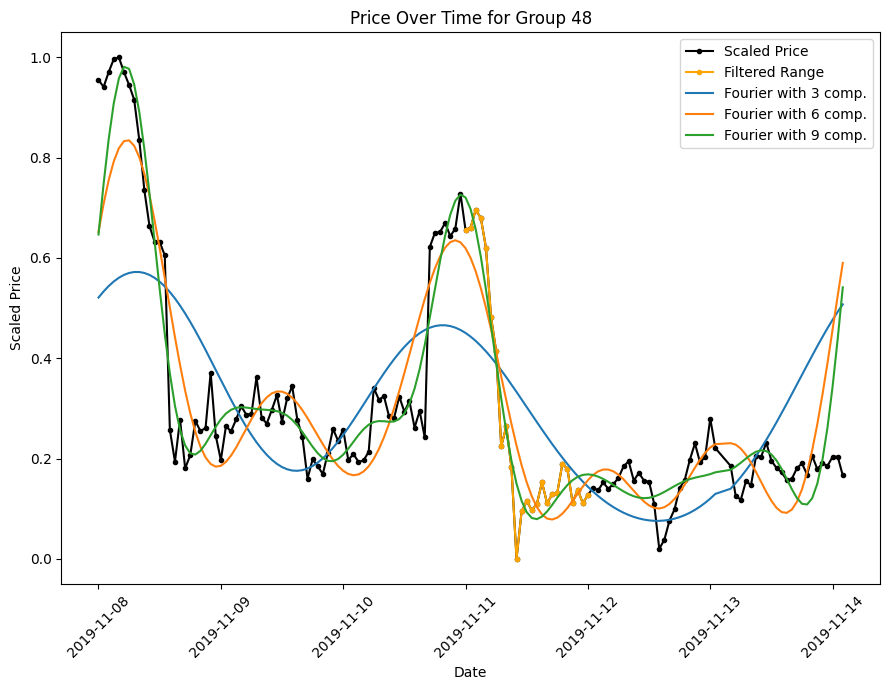

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


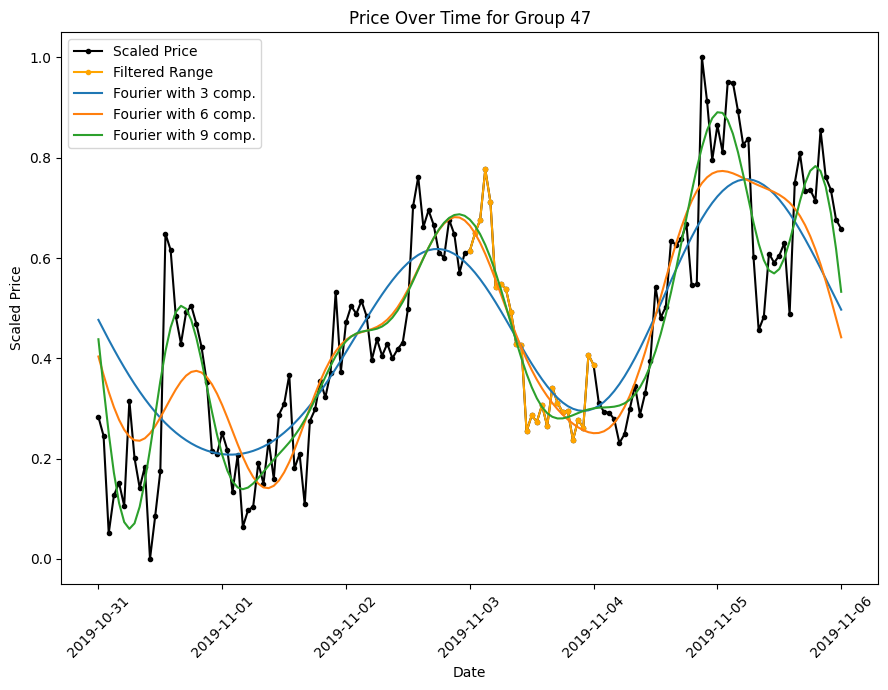

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


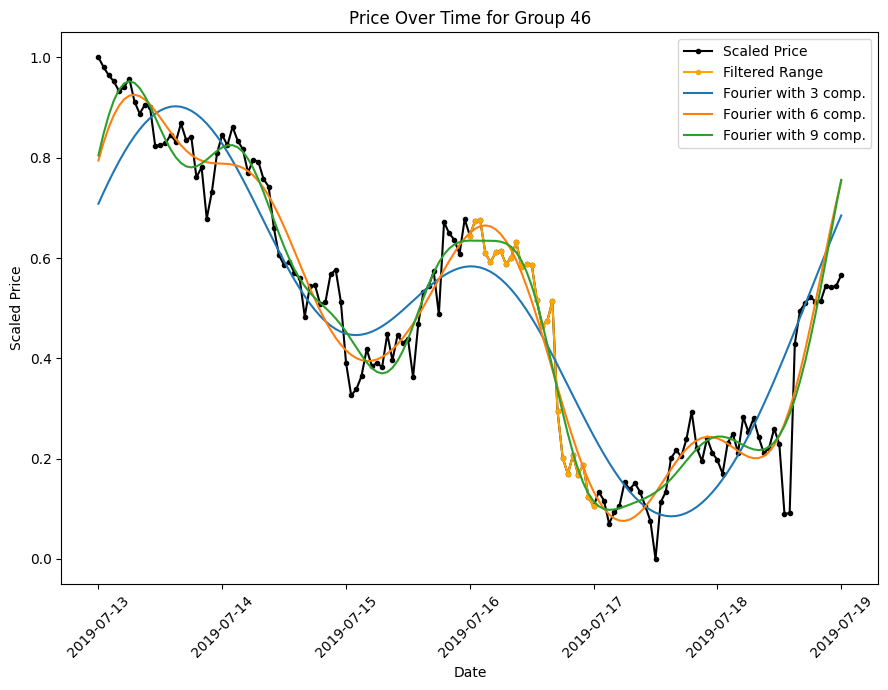

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


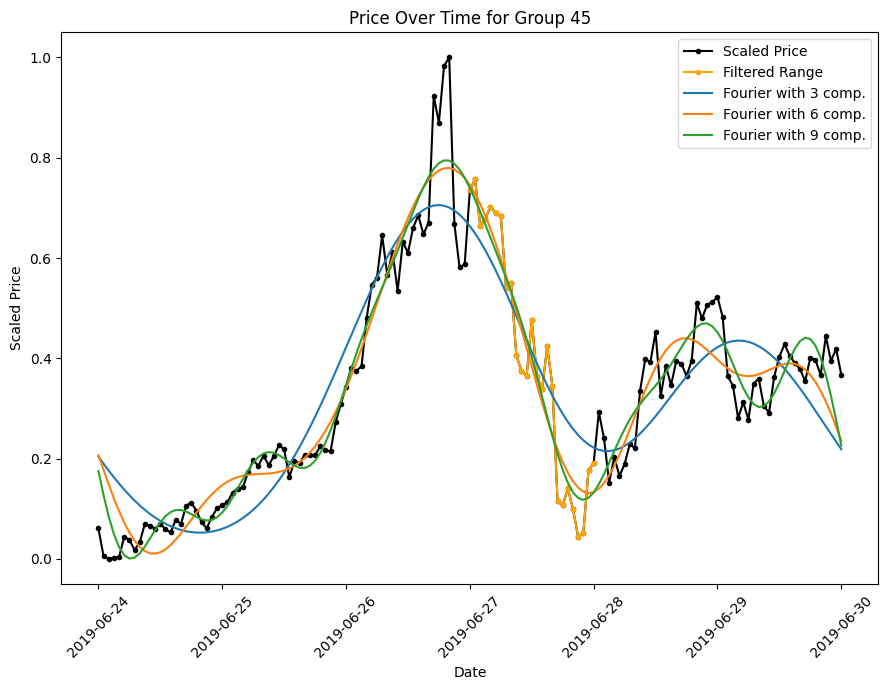

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


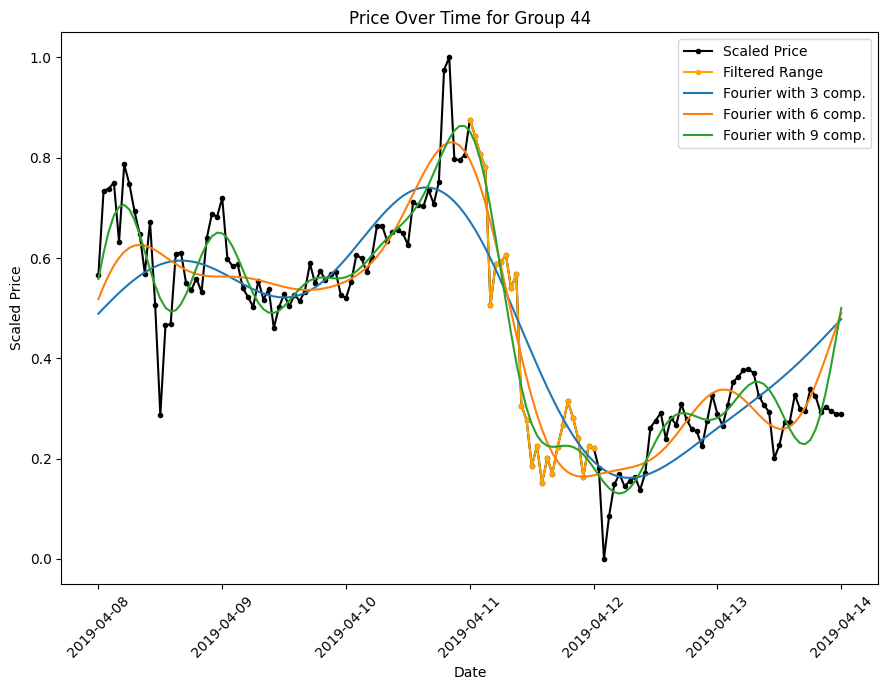

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


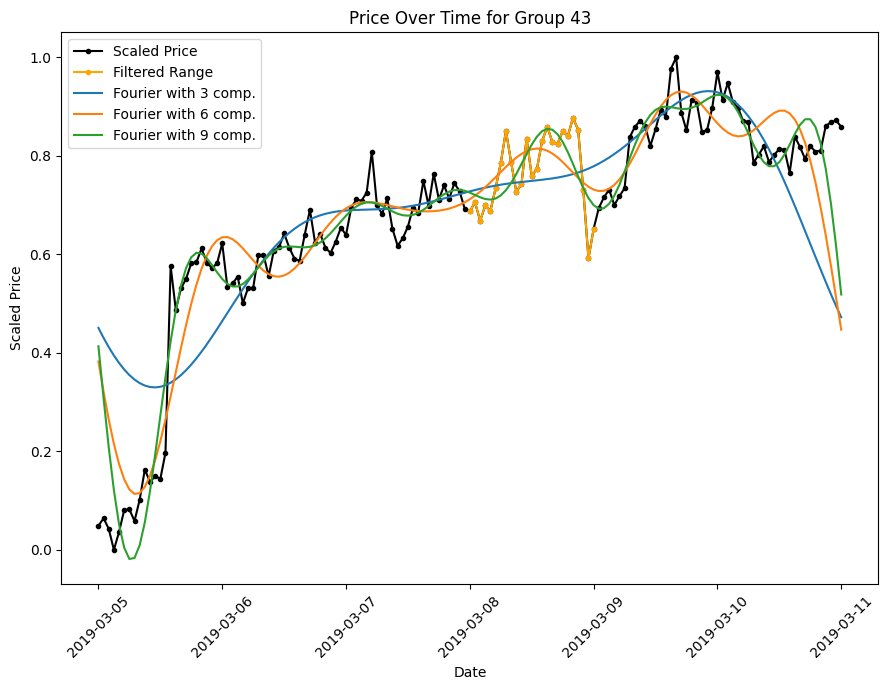

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


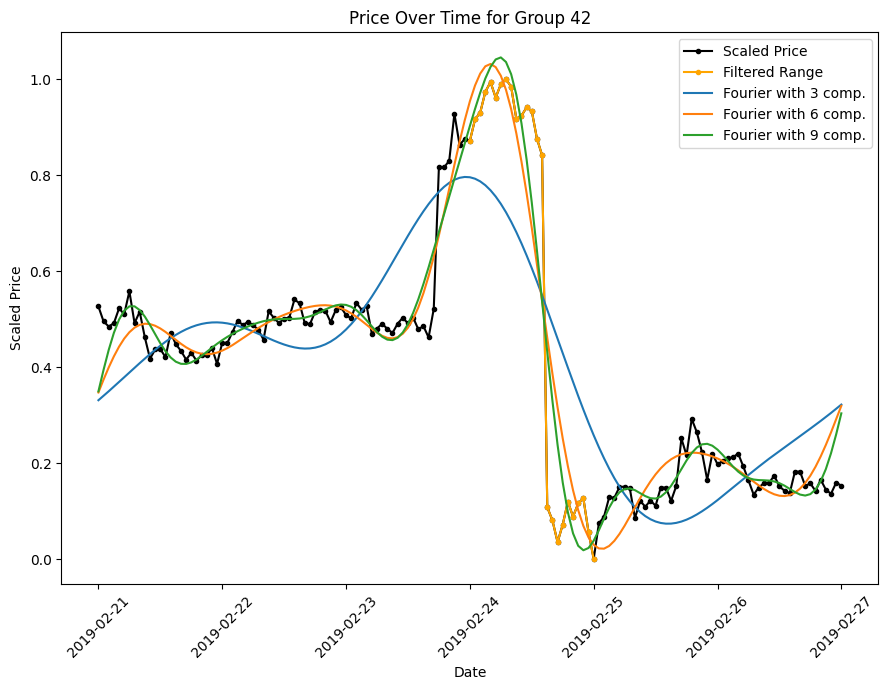

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


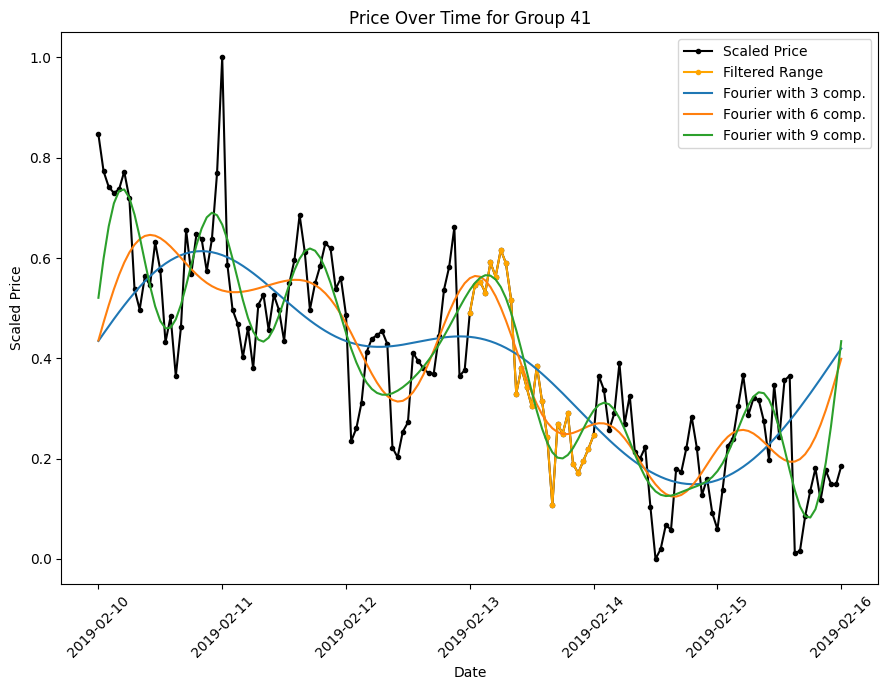

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


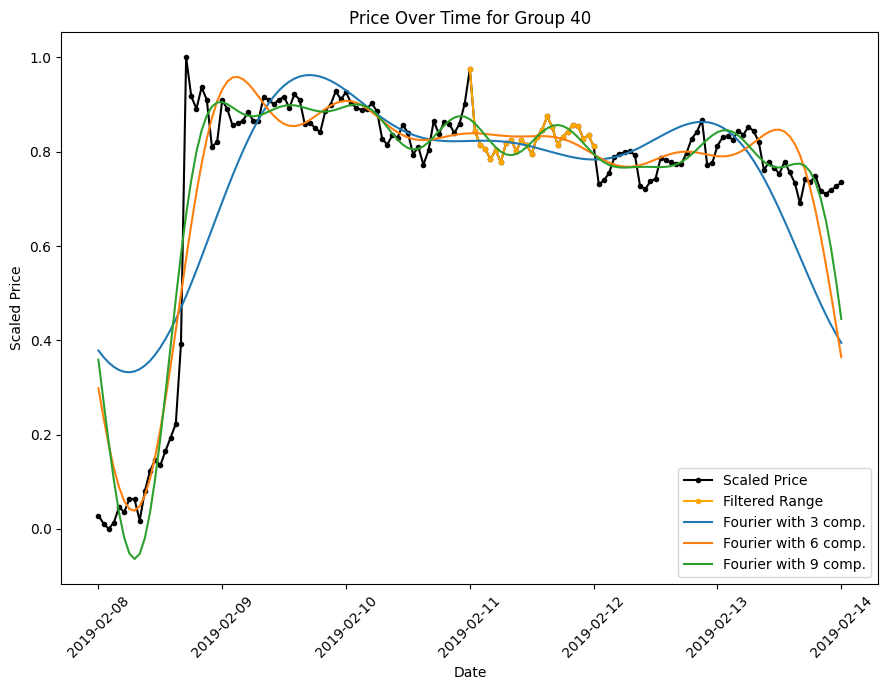

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


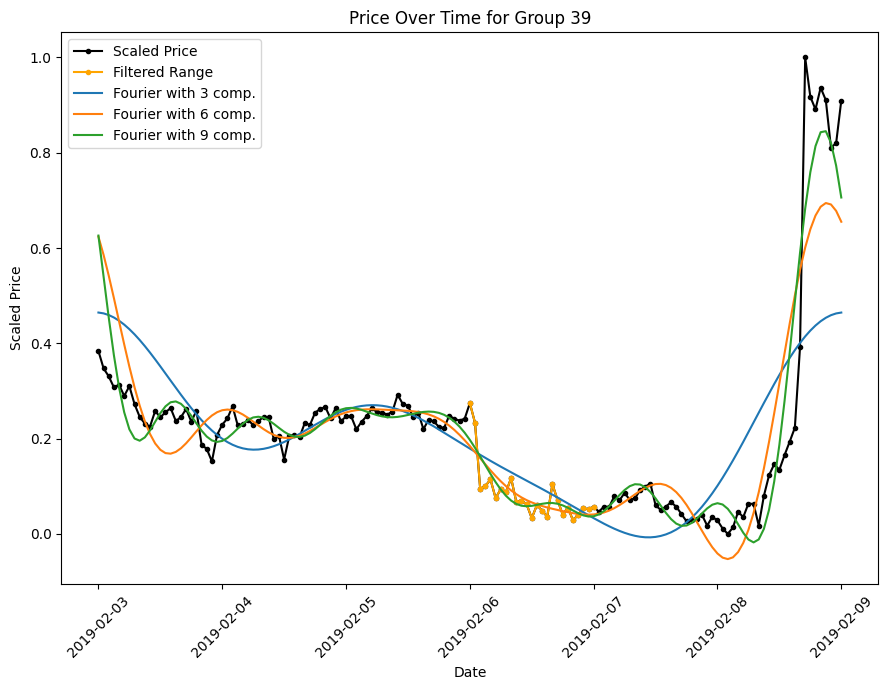

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


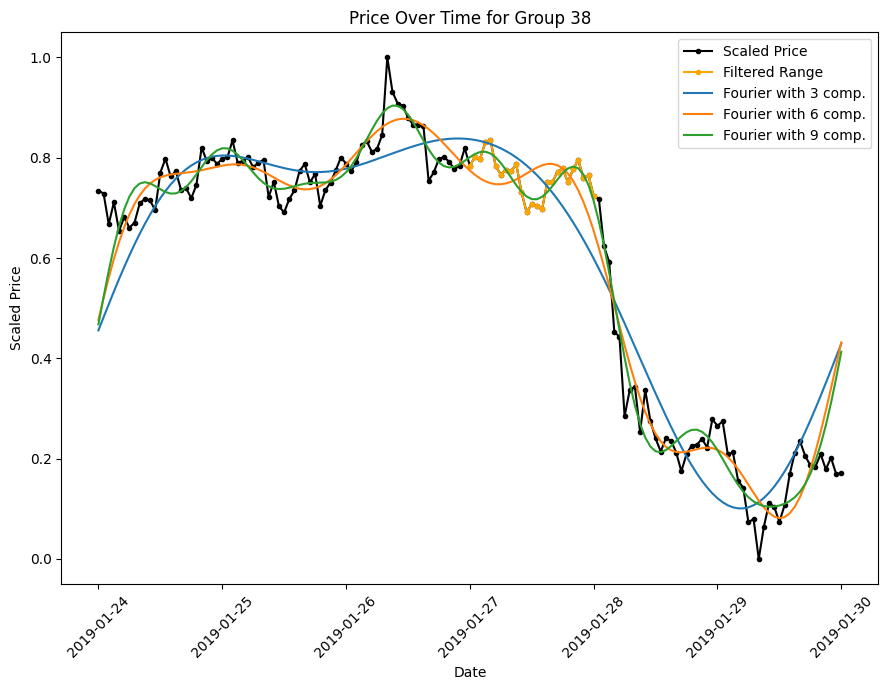

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


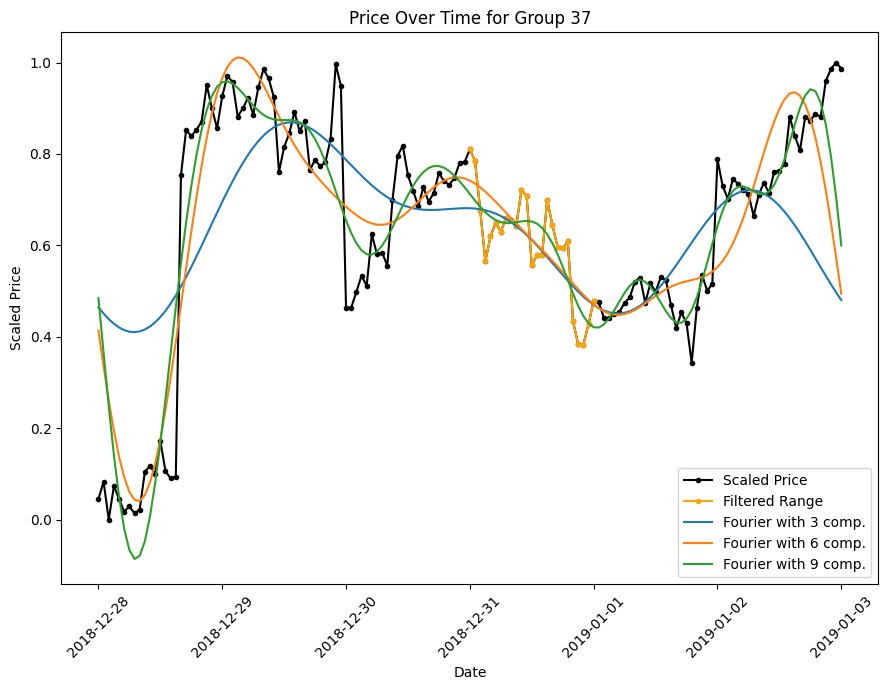

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


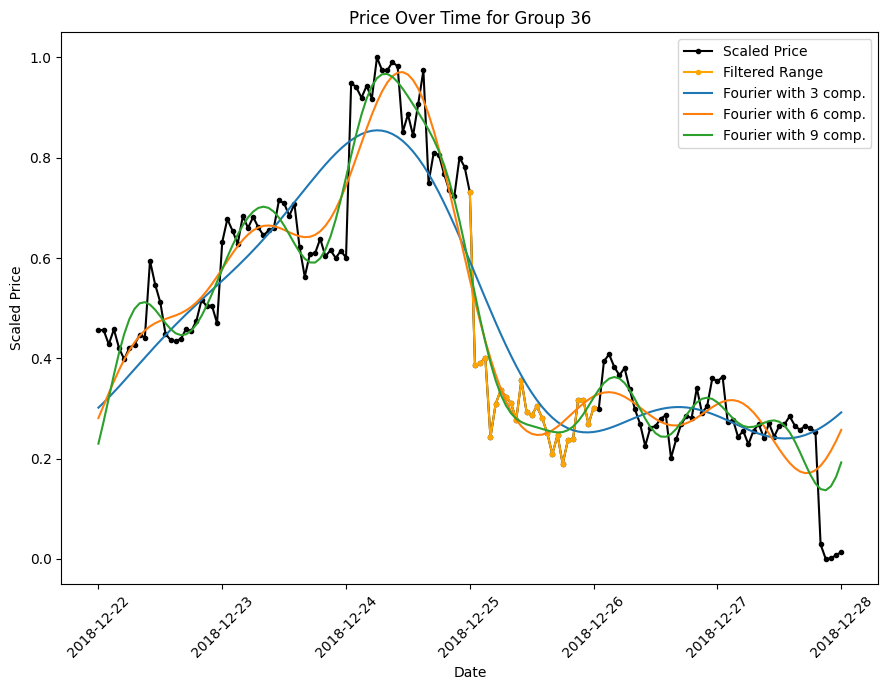

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


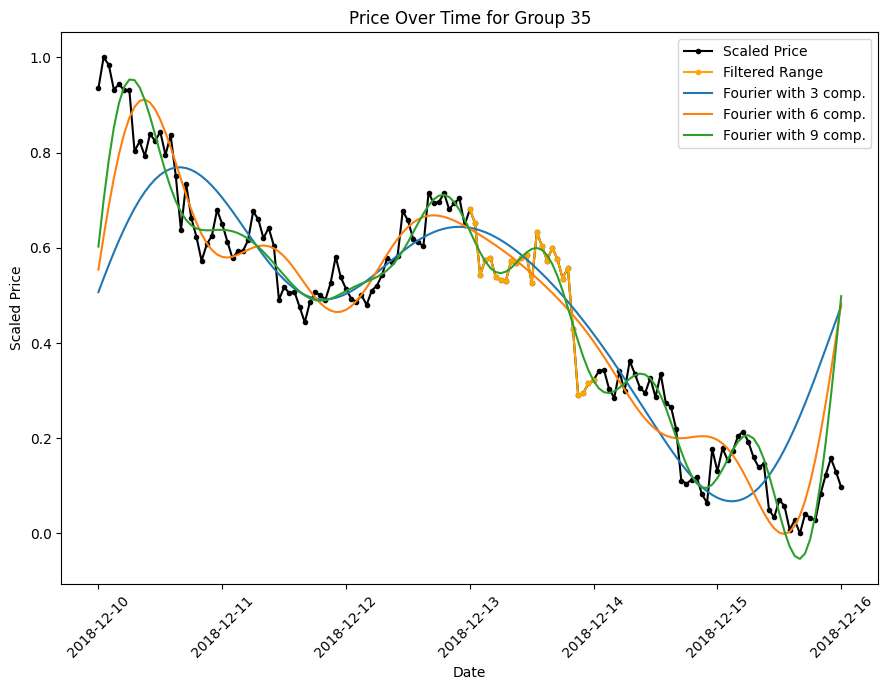

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


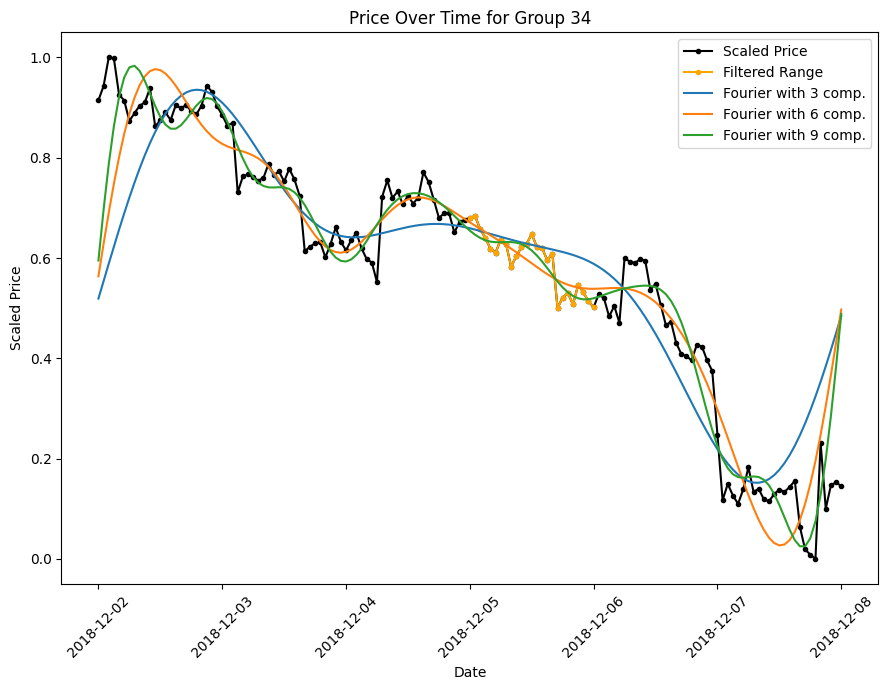

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


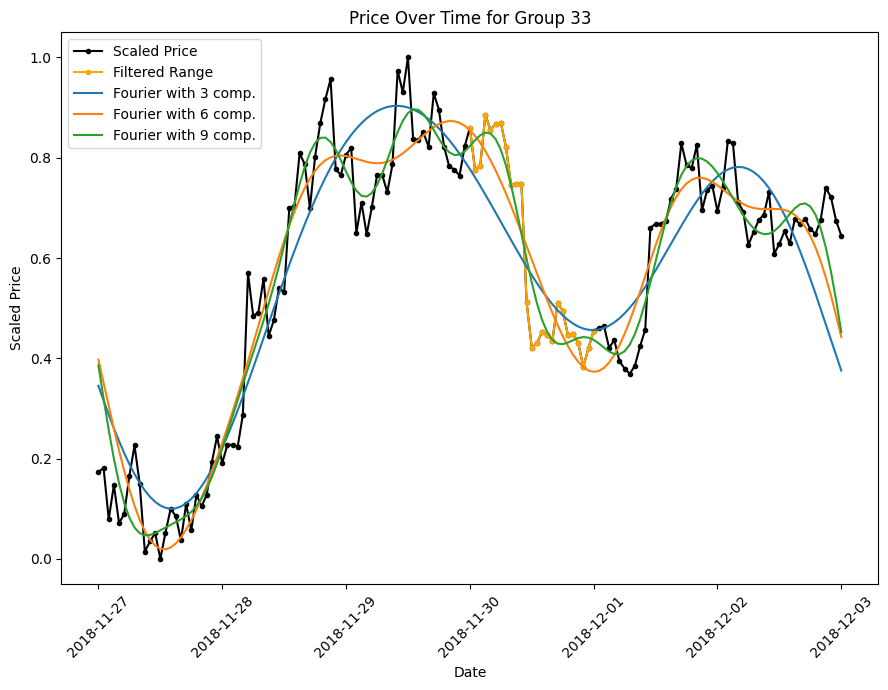

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


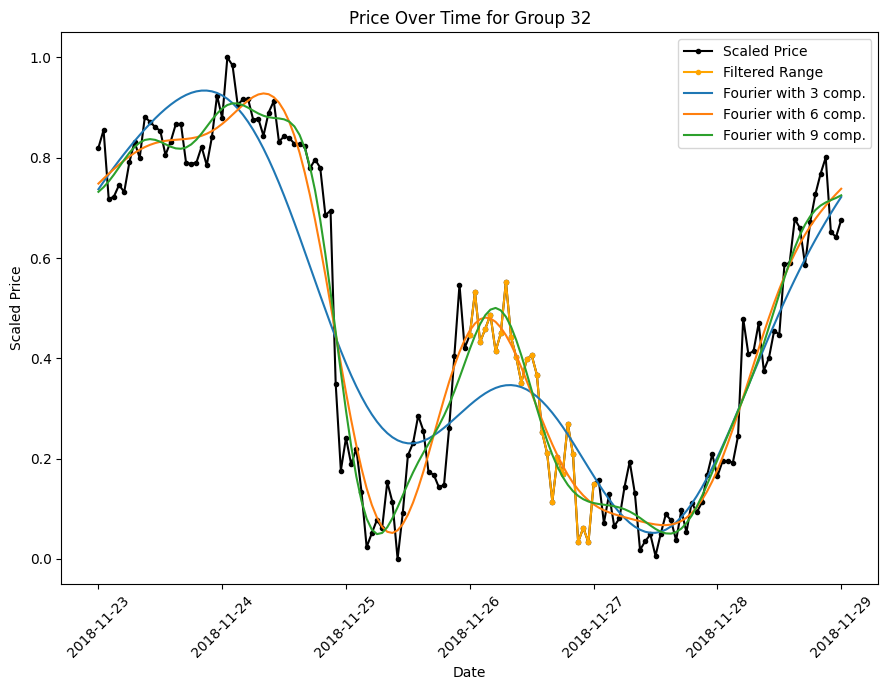

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


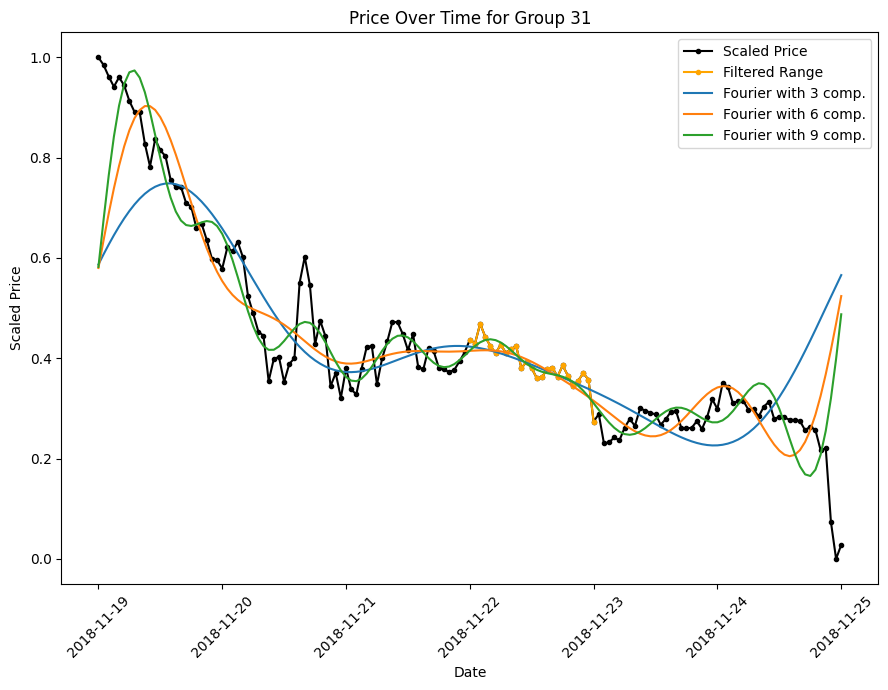

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


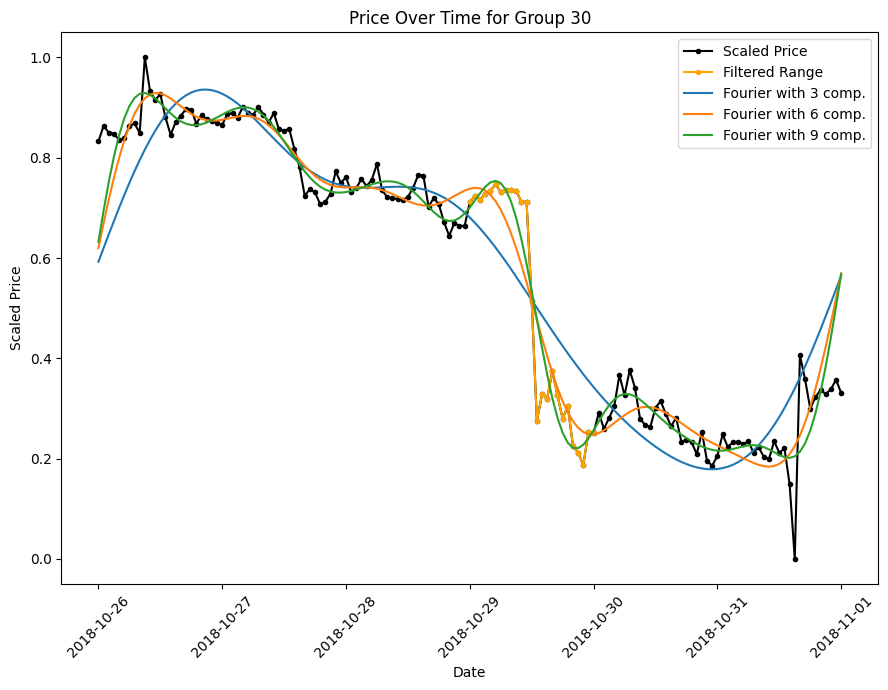

c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\Tarokh\My-env\dl\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


KeyboardInterrupt: 

In [12]:
# chatgpt / same result as orginal

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# فرض کنید Selected_data و df_grouped از قبل تعریف شده‌اند و شامل ستون‌های 'Group', 'Date_b', 'level_1', 'level_3' هستند.

# کپی Selected_data برای ایجاد دیتافریم مقیاس‌بندی شده بر اساس گروه
# df_scaled_byGroup = Selected_data.copy()
scaler = MinMaxScaler()

# برای هر گروه در df_grouped، قیمت‌ها را مقیاس‌بندی و تبدیل فوریه را محاسبه و رسم می‌کنیم.
for i in df_grouped_bearish['Group'].unique():
    # انتخاب داده‌های مربوط به گروه i
    Grouped_data = df_grouped_bearish[df_grouped_bearish['Group'] == i].copy()
    
    # مقیاس‌بندی قیمت‌ها (ستون 'level_3') در این گروه
    Grouped_data['price_scaled'] = scaler.fit_transform(Grouped_data['level_3'].values.reshape(-1, 1))
    
    # تعیین بازه زمانی برای فیلتر کردن داده‌ها
    # فرض بر این است که ستون Date_b تاریخ شروع گروه را نشان می‌دهد
    range1 = Grouped_data['Date_b'].iloc[1] + pd.Timedelta(hours=24)
    range2 = Grouped_data['Date_b'].iloc[1] + pd.Timedelta(hours=48)
    
    # فیلتر کردن داده‌ها بر اساس بازه زمانی تعیین‌شده
    test2 = Grouped_data[(Grouped_data['level_1'] >= range1) & (Grouped_data['level_1'] <= range2)]
    
    # محاسبه تبدیل فوریه بر روی قیمت‌های مقیاس‌بندی شده
    data_FT = Grouped_data[['price_scaled']]
    close_fft = np.fft.fft(np.asarray(data_FT['price_scaled'].tolist()))
    
    # ایجاد DataFrame برای نگهداری مقادیر فوریه (اختیاری)
    fft_df = pd.DataFrame({'fft': close_fft})
    fft_df['absolute'] = fft_df['fft'].apply(lambda x: np.abs(x))
    fft_df['angle'] = fft_df['fft'].apply(lambda x: np.angle(x))
    
    # رسم نمودار اصلی قیمت‌های مقیاس‌شده و نمودار فیلتر شده
    plt.figure(figsize=(9, 7), dpi=100)
    plt.plot(Grouped_data['level_1'], Grouped_data['price_scaled'], marker='.', color='black', label='Scaled Price')
    plt.plot(test2['level_1'], test2['price_scaled'], marker='.', color='orange', label='Filtered Range')
    
    # رسم نمودارهای حاصل از تبدیل فوریه با حفظ تعداد مؤلفه‌های مختلف
    for num_components in [3, 6, 9]:
        fft_copy = np.copy(close_fft)
        fft_copy[num_components:-num_components] = 0  # صفر کردن بقیه مؤلفه‌ها
        inverse_fft = np.fft.ifft(fft_copy)
        plt.plot(Grouped_data['level_1'], inverse_fft, label=f'Fourier with {num_components} comp.')
    
    plt.xlabel('Date')
    plt.ylabel('Scaled Price')
    plt.title(f'Price Over Time for Group {i}')
    plt.xticks(rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()


Training X sample:
Empty DataFrame
Columns: []
Index: []
Training Y sample:
Empty DataFrame
Columns: []
Index: []
Combined Grouped Data:
                  level_1  level_3  level_6  Group     Date_b  price_scaled
24360 2017-08-25 00:00:00  4316.01   4366.0      1 2017-08-21      0.987607
24361 2017-08-24 23:00:00  4326.24  4316.01      1 2017-08-21      1.000000
24362 2017-08-24 22:00:00  4207.00  4326.23      1 2017-08-21      0.855544
24363 2017-08-24 21:00:00  4208.10   4207.0      1 2017-08-21      0.856876
24364 2017-08-24 20:00:00  4216.10   4193.5      1 2017-08-21      0.866568
LSTM Data shapes: (2475, 10, 1) (2475, 10) (725, 10, 1) (725, 10) (975, 10, 1) (975, 10)
Training LSTM model...
Epoch 1/5


c:\Users\Tarokh\My-env\dl\Lib\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


78/78 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - loss: 0.2211 - val_loss: 0.0464
Epoch 2/5
78/78 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0370 - val_loss: 0.0339
Epoch 3/5
78/78 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0308 - val_loss: 0.0330
Epoch 4/5
78/78 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0297 - val_loss: 0.0324
Epoch 5/5
78/78 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0285 - val_loss: 0.0319
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
Predictions:
[[0.6606486  0.61978817 0.6184942  ... 0.6146275  0.646346   0.6114427 ]
 [0.42240876 0.39768946 0.4043737  ... 0.41435805 0.4573573  0.4182966 ]
 [0.37961334 0.36980963 0.37408042 ... 0.38323024 0.40916818 0.37870932]
 ...
 [0.19415197 0.15807208 0.17185043 ... 0.21377331 0.2400644  0.18969692]
 [0.17341238 0.13492684 0.14980802 ... 0.19683298 0.21655889 0.16672798]
 [0.16589671 0.12615356 0.14153606 ... 0.19073287 0.2078732  0.15823989]]


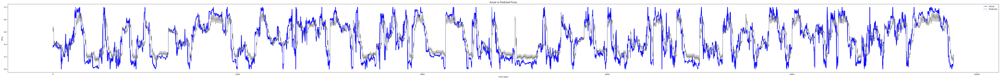

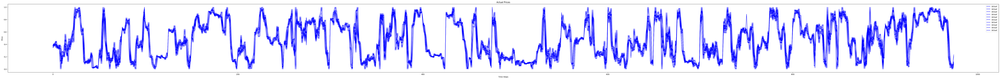

In [13]:
# ================================
# LSTM Model Section
# ================================


from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense


# آماده‌سازی داده‌ها برای مدل LSTM
group_train_y = pd.DataFrame()
group_test2_data_df = pd.DataFrame()
group_train_x = pd.DataFrame()
Grouped_data_scaled = pd.DataFrame()

scaler = MinMaxScaler()


for i in df_grouped_bullish['Group'].unique():
    Grouped_data = df_grouped_bullish[df_grouped_bullish['Group'] == i].copy()
    Grouped_data.loc[Grouped_data['Group'] == i, 'price_scaled'] = scaler.fit_transform(Grouped_data['level_3'].values.reshape(-1, 1))

    range2 = Grouped_data['Date_b'].iloc[1] + pd.Timedelta(hours=48)
    range1 = Grouped_data['Date_b'].iloc[1] + pd.Timedelta(hours=24)

# we creat a new scaled data for bulishes // 
    Grouped_data_scaled = pd.concat([Grouped_data, Grouped_data_scaled])
    

    x_train_sample = Grouped_data[Grouped_data['level_1'] <= range2].copy()
    y_train_sample = Grouped_data[Grouped_data['level_1'] >= range2].copy()

  

    # group_train_x = pd.concat([group_train_x, x_train_sample])
    # group_train_y = pd.concat([group_train_y, y_train_sample])

print("Training X sample:")
print(group_train_x.head())
print("Training Y sample:")
print(group_train_y.head())
print("Combined Grouped Data:")
print(Grouped_data_scaled.head())

# تابع ایجاد توالی‌ها برای مدل LSTM
def create_sequences(data, seq_length):
    sequences = []                                 
    labels = []                           
    for i in range(0, len(data) - seq_length - 10, 5):
        sequence = data[i:i + seq_length]
        label = data[i + seq_length:i + seq_length + 10]
        sequences.append(sequence)
        labels.append(label)
    return np.array(sequences), np.array(labels)

seq_length = 10

# تقسیم داده‌ها به آموزش، اعتبارسنجی و آزمون بر اساس گروه‌ها
train_sequences = []
train_labels = []
test_sequences = []
test_labels = []
val_sequences = []
val_labels = []

train_groups = Grouped_data_scaled[Grouped_data_scaled['Group'] < 100]
val_groups   = Grouped_data_scaled[(Grouped_data_scaled['Group'] > 100) & (Grouped_data_scaled['Group'] < 130)]
test_groups  = Grouped_data_scaled[Grouped_data_scaled['Group'] > 130]

for group in Grouped_data_scaled['Group'].unique():
    Grouped_data_sample = Grouped_data_scaled[Grouped_data_scaled['Group'] == group]
    prices = Grouped_data_sample['price_scaled'].values
    X, y = create_sequences(prices, seq_length)
    if group in train_groups['Group'].values:
        train_sequences.append(X)
        train_labels.append(y)
    elif group in val_groups['Group'].values:
        val_sequences.append(X)
        val_labels.append(y)
    elif group in test_groups['Group'].values:
        test_sequences.append(X)
        test_labels.append(y)
        

X_train = np.concatenate(train_sequences, axis=0)
y_train = np.concatenate(train_labels, axis=0)
X_val   = np.concatenate(val_sequences, axis=0)
y_val   = np.concatenate(val_labels, axis=0)
X_test  = np.concatenate(test_sequences, axis=0)
y_test  = np.concatenate(test_labels, axis=0)

# تغییر شکل داده‌ها برای مدل LSTM: (samples, timesteps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_val   = np.reshape(X_val, (X_val.shape[0], X_val.shape[1], 1))
X_test  = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

print("LSTM Data shapes:", X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape)

# ساخت و کامپایل مدل LSTM
model = Sequential()
model.add(LSTM(10, return_sequences=True, input_shape=(seq_length, 1)))
model.add(LSTM(10))
model.add(Dense(10))
model.compile(optimizer='adam', loss='mean_squared_error')

print("Training LSTM model...")
history = model.fit(X_train, y_train, epochs=5, batch_size=32, validation_data=(X_val, y_val), verbose=1)

# پیش‌بینی روی مجموعه آزمون
y_pred = model.predict(X_test)
print("Predictions:")
print(y_pred)

# رسم نمودار مقایسه‌ای بین مقادیر واقعی و پیش‌بینی شده
plt.figure(figsize=(100, 7))
plt.plot(y_test.flatten(), label='Actual', color='blue')
plt.plot(y_pred.flatten(), label='Predicted', color='gray')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.title('Actual vs Predicted Prices')
plt.legend()
plt.show()

# رسم نمودار دیگری از مقادیر واقعی
plt.figure(figsize=(100, 7))
plt.plot(y_test, label='Actual', color='blue')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.title('Actual Prices')
plt.legend()
plt.show()

In [ ]:
# ================================
# LSTM Model Section
# ================================


from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense


# آماده‌سازی داده‌ها برای مدل LSTM
group_train_y = pd.DataFrame()
group_test2_data_df = pd.DataFrame()
group_train_x = pd.DataFrame()
Grouped_data_scaled = pd.DataFrame()

scaler = MinMaxScaler()


for i in df_grouped_bullish['Group'].unique():
    Grouped_data = df_grouped_bullish[df_grouped_bullish['Group'] == i].copy()
    Grouped_data.loc[Grouped_data['Group'] == i, 'price_scaled'] = scaler.fit_transform(Grouped_data['level_3'].values.reshape(-1, 1))

    range2 = Grouped_data['Date_b'].iloc[1] + pd.Timedelta(hours=48)
    range1 = Grouped_data['Date_b'].iloc[1] + pd.Timedelta(hours=24)

# we creat a new scaled data for bulishes // 
    Grouped_data_scaled = pd.concat([Grouped_data, Grouped_data_scaled])
    
#    test2 = Grouped_data[(Grouped_data['level_1'] >= range1) & (Grouped_data['level_1'] <= range2)].copy()
#    group_test2_data_df = pd.concat([group_test2_data_df, test2], ignore_index=True)

    x_train_sample = Grouped_data[Grouped_data['level_1'] <= range2].copy()
    y_train_sample = Grouped_data[Grouped_data['level_1'] >= range2].copy()

    

    group_train_x = pd.concat([group_train_x, x_train_sample])
    group_train_y = pd.concat([group_train_y, y_train_sample])

print("Training X sample:")
print(group_train_x.head())
print("Training Y sample:")
print(group_train_y.head())
print("Combined Grouped Data:")
print(Grouped_data_scaled.head())

# تابع ایجاد توالی‌ها برای مدل LSTM
def create_sequences(data, seq_length):
    sequences = []                                 
    labels = []                           
    for i in range(0, len(data) - seq_length - 10, 5):
        sequence = data[i:i + seq_length]
        label = data[i + seq_length:i + seq_length + 10]
        sequences.append(sequence)
        labels.append(label)
    return np.array(sequences), np.array(labels)

seq_length = 10

# تقسیم داده‌ها به آموزش، اعتبارسنجی و آزمون بر اساس گروه‌ها
train_sequences = []
train_labels = []
test_sequences = []
test_labels = []
val_sequences = []
val_labels = []

train_groups = Grouped_data_scaled[Grouped_data_scaled['Group'] < 100]
val_groups   = Grouped_data_scaled[(Grouped_data_scaled['Group'] > 100) & (Grouped_data_scaled['Group'] < 130)]
test_groups  = Grouped_data_scaled[Grouped_data_scaled['Group'] > 130]

for group in Grouped_data_scaled['Group'].unique():
    Grouped_data_sample = Grouped_data_scaled[Grouped_data_scaled['Group'] == group]
    prices = Grouped_data_sample['price_scaled'].values
    X, y = create_sequences(prices, seq_length)
    if group in train_groups['Group'].values:
        train_sequences.append(X)
        train_labels.append(y)
    elif group in val_groups['Group'].values:
        val_sequences.append(X)
        val_labels.append(y)
    elif group in test_groups['Group'].values:
        test_sequences.append(X)
        test_labels.append(y)
        

X_train = np.concatenate(train_sequences, axis=0)
y_train = np.concatenate(train_labels, axis=0)
X_val   = np.concatenate(val_sequences, axis=0)
y_val   = np.concatenate(val_labels, axis=0)
X_test  = np.concatenate(test_sequences, axis=0)
y_test  = np.concatenate(test_labels, axis=0)

# تغییر شکل داده‌ها برای مدل LSTM: (samples, timesteps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_val   = np.reshape(X_val, (X_val.shape[0], X_val.shape[1], 1))
X_test  = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

print("LSTM Data shapes:", X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape)

# ساخت و کامپایل مدل LSTM
model = Sequential()
model.add(LSTM(10, return_sequences=True, input_shape=(seq_length, 1)))
model.add(LSTM(10))
model.add(Dense(10))
model.compile(optimizer='adam', loss='mean_squared_error')

print("Training LSTM model...")
history = model.fit(X_train, y_train, epochs=5, batch_size=32, validation_data=(X_val, y_val), verbose=1)

# پیش‌بینی روی مجموعه آزمون
y_pred = model.predict(X_test)
print("Predictions:")
print(y_pred)

# رسم نمودار مقایسه‌ای بین مقادیر واقعی و پیش‌بینی شده
plt.figure(figsize=(100, 7))
plt.plot(y_test.flatten(), label='Actual', color='blue')
plt.plot(y_pred.flatten(), label='Predicted', color='gray')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.title('Actual vs Predicted Prices')
plt.legend()
plt.show()

# رسم نمودار دیگری از مقادیر واقعی
plt.figure(figsize=(100, 7))
plt.plot(y_test, label='Actual', color='blue')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.title('Actual Prices')
plt.legend()
plt.show()

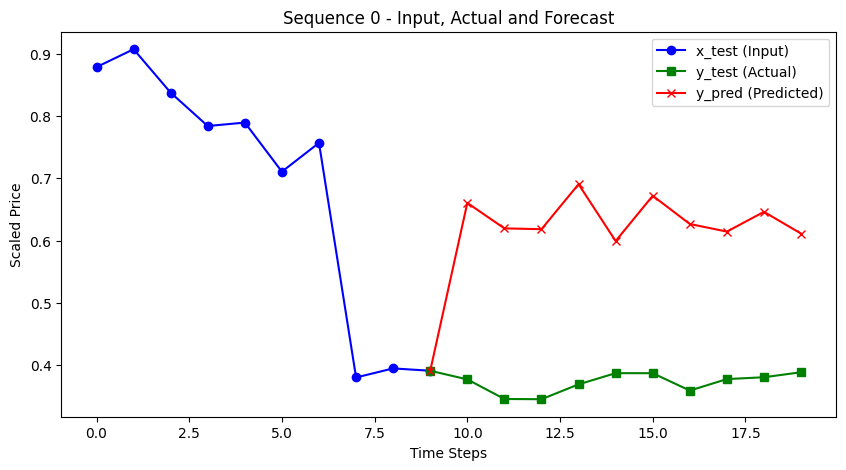

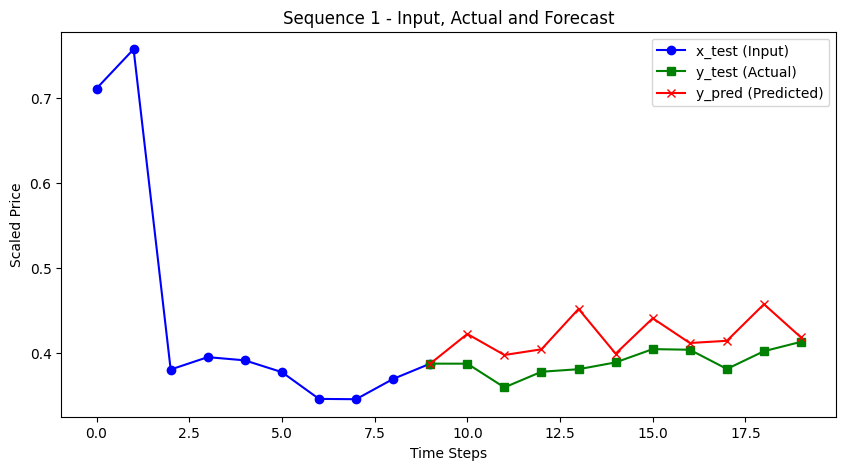

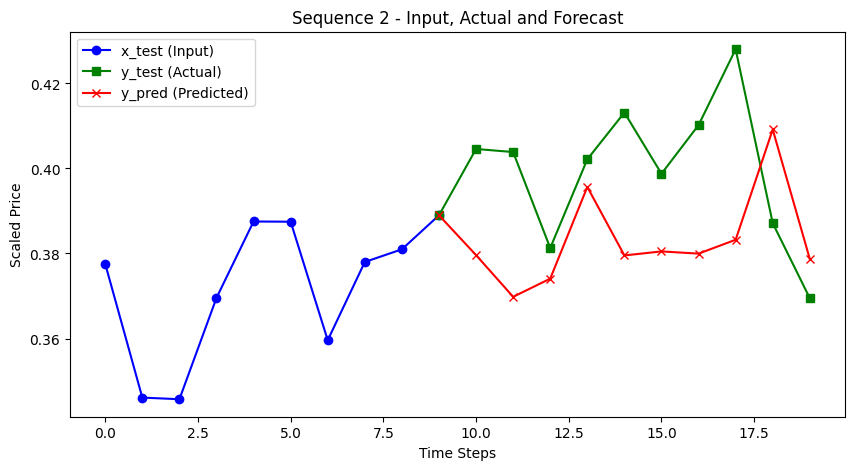

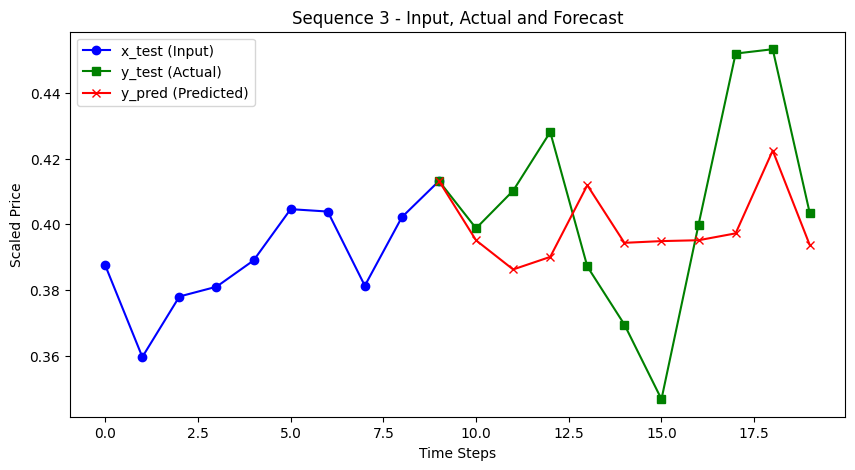

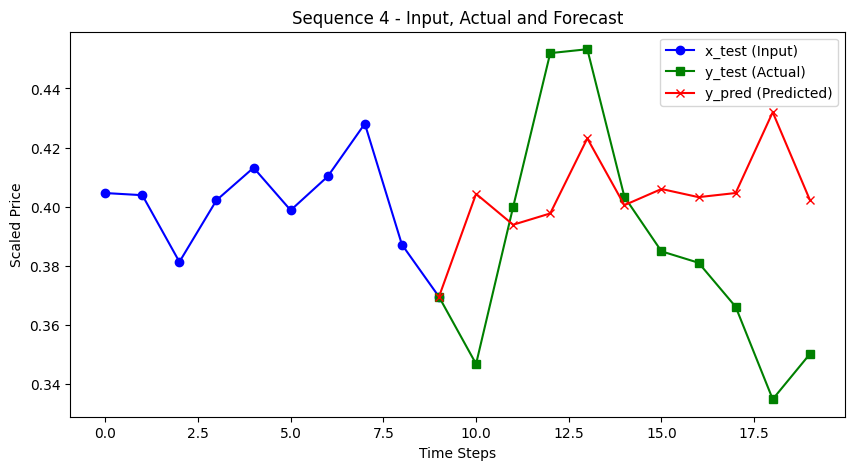

...

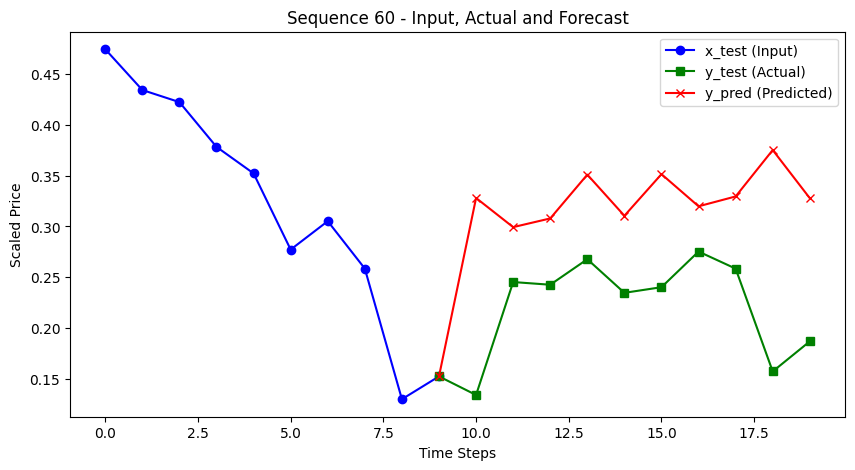

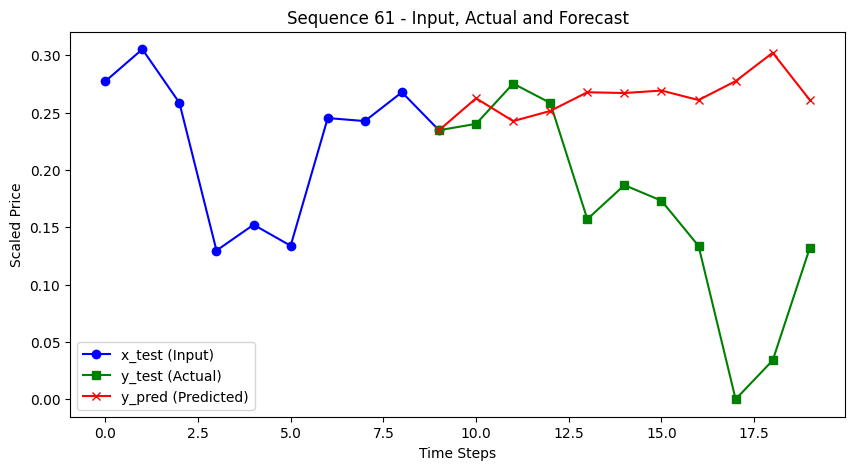

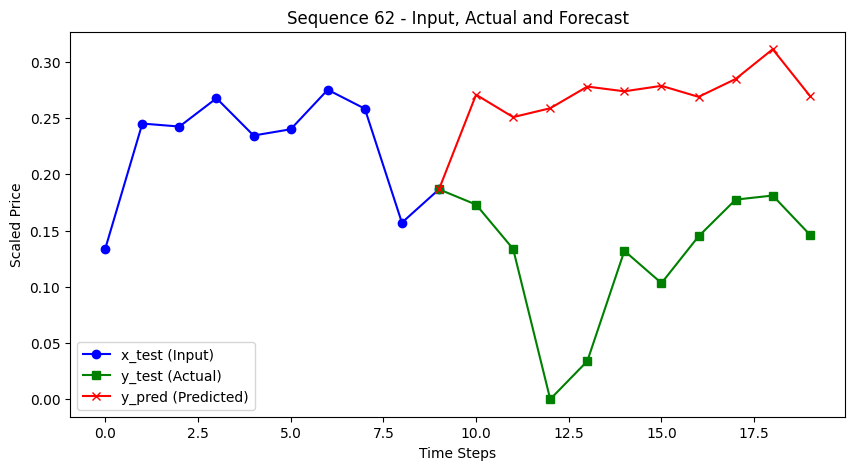

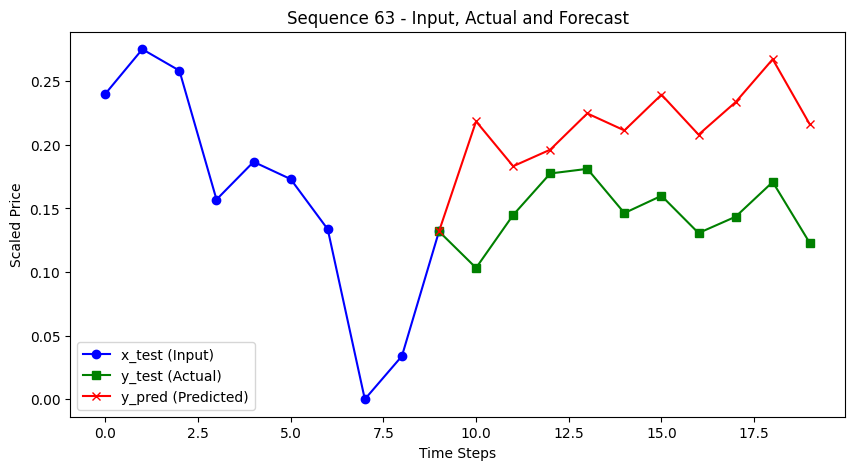

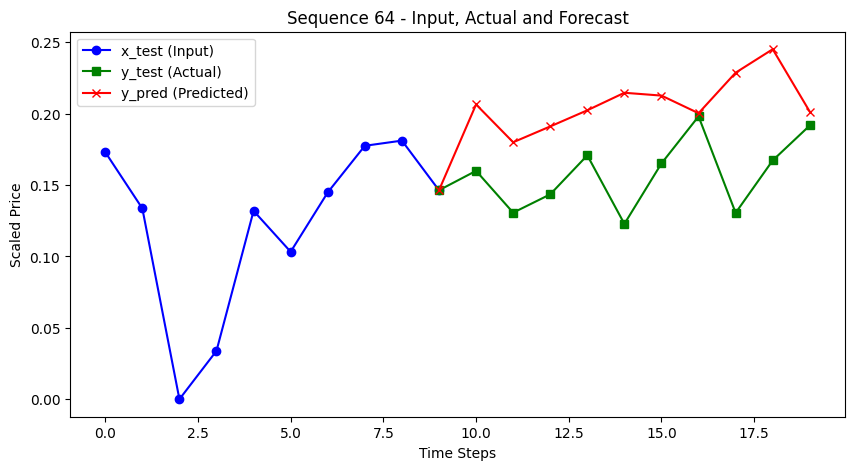

KeyboardInterrupt: 

In [22]:
#part 10
import matplotlib.pyplot as plt
import numpy as np

# فرض می‌کنیم:
# X_test: آرایه ورودی با شکل (N, seq_length, 1)
# y_test: آرایه مقادیر واقعی با شکل (N, pred_length)
# y_pred: آرایه مقادیر پیش‌بینی شده با شکل (N, pred_length)
# در این مثال seq_length = 10 و pred_length = 10 است.

for i in range(len(X_test)):
    # استخراج توالی ورودی و صاف کردن آن
    input_seq = X_test[i].flatten()          # طول: 10
    true_seq = y_test[i].flatten()           # طول: 10
    pred_seq = y_pred[i].flatten()           # طول: 10

    # برای رسم پیوسته: ابتدا ورودی و سپس توالی واقعی و پیش‌بینی شده را در یک آرایه جداگانه تعریف می‌کنیم.
    # دقت کنید که نقطه آخر توالی ورودی به عنوان نقطه شروع پیش‌بینی در نظر گرفته می‌شود.
    full_seq_true = np.concatenate([input_seq, true_seq])
    full_seq_pred = np.concatenate([input_seq, pred_seq])
    
    # ایجاد محور زمان مناسب
    time_steps = np.arange(len(full_seq_true))
    
    plt.figure(figsize=(10, 5))
    # رسم توالی ورودی
    plt.plot(time_steps[:len(input_seq)], input_seq, label='x_test (Input)', color='blue', marker='o')
    # رسم توالی واقعی، از نقطه آخر ورودی به بعد
    plt.plot(time_steps[len(input_seq)-1:], full_seq_true[len(input_seq)-1:], label='y_test (Actual)', color='green', marker='s')
    # رسم توالی پیش‌بینی شده، از نقطه آخر ورودی به بعد
    plt.plot(time_steps[len(input_seq)-1:], full_seq_pred[len(input_seq)-1:], label='y_pred (Predicted)', color='red', marker='x')
    
    plt.title(f"Sequence {i} - Input, Actual and Forecast")
    plt.xlabel("Time Steps")
    plt.ylabel("Scaled Price")
    plt.legend()
    plt.show()
